In [2]:
import pandas as pd

# Load the dataset to inspect the contents
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Display the first few rows of the dataset to understand its structure
data.head()


,Date,Vanguard LifeStrategy Income Fund (VASIX),Vanguard Total World Stock ETF (VT),PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ),AQR Diversified Arbitrage I (ADAIX),iShares Gold Trust (IAU),Bitcoin Market Price USD (^BTC),AQR Risk-Balanced Commodities Strategy I (ARCIX),AQR Long-Short Equity I (QLEIX),AQR Style Premia Alternative I (QSPIX),AQR Equity Market Neutral I (QMNIX),AQR Macro Opportunities I (QGMIX),AGF U.S. Market Neutral Anti-Beta (BTAL),AQR Managed Futures Strategy HV I (QMHIX),Invesco DB US Dollar Bullish (UUP),ProShares VIX Mid-Term Futures (VIXM)
0,2014-11-30,0.0094,0.0126,0.0414,-0.0066,-0.0053,0.0969,-0.0726,0.0248,0.0412,0.0257,0.0154,0.0235,0.1159,0.0165,-0.0298
1,2014-12-31,-0.0005,-0.0199,0.0612,-0.0117,0.0133,-0.1777,-0.0412,0.0140,0.0002,0.0195,0.0039,0.0294,0.0461,0.0213,0.0553
2,2015-01-31,0.0141,-0.0163,0.1600,-0.0059,0.0865,-0.2677,-0.0287,0.0156,-0.0112,0.0290,-0.0070,0.0320,0.0721,0.0484,0.0762
3,2015-02-28,0.0033,0.0595,-0.1007,0.0069,-0.0579,0.1062,0.0044,0.0236,-0.0390,-0.0078,0.0091,-0.0568,-0.0108,0.0028,-0.1145
4,2015-03-31,0.0018,-0.0121,0.0117,0.0000,-0.0222,-0.0150,-0.0573,-0.0027,0.0256,0.0049,0.0261,0.0000,0.0655,0.0278,0.0033


In [221]:
import pandas as pd
import dataframe_image as dfi

# Load the dataset to inspect the contents
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Drop the 'Date' column before running the summary statistics
numeric_data = data.drop(columns=['Date'])

# Calculate kurtosis and skew for each asset
kurtosis = numeric_data.kurtosis()
skewness = numeric_data.skew()

# Calculate the correlations of all assets with VASIX
correlation_with_vasix = numeric_data.corr()["Vanguard LifeStrategy Income Fund (VASIX)"]

# Generate summary statistics for all assets
summary_stats = numeric_data.describe().T  # Transpose for readability

# Rename columns for better clarity
summary_stats.columns = ['Count', 'Mean', 'Std Dev', 'Min', '25%', 'Median', '75%', 'Max']

# Add Kurtosis and Skewness
summary_stats['Skewness'] = skewness
summary_stats['Kurtosis'] = kurtosis

# Convert count to integer
summary_stats['Count'] = summary_stats['Count'].astype(int)

# Convert only percentage-relevant columns (mean, std dev, etc.) to percentage form
columns_to_convert = ['Mean', 'Std Dev', 'Min', '25%', 'Median', '75%', 'Max']
for col in columns_to_convert:
    summary_stats[col] = summary_stats[col] * 100  # Convert to percentage form

# Add the correlation with VASIX to the immediate right of the Count column
summary_stats.insert(1, 'Correlation with VASIX', correlation_with_vasix)

# Sort the summary stats by the correlation with VASIX
sorted_summary_stats = summary_stats.loc[correlation_with_vasix.sort_values(ascending=False).index]

# Adjust the color gradient to make it warmer and show 2 decimal places for skewness and kurtosis
styled_table = sorted_summary_stats.style \
    .format("{:.2f}", subset=pd.IndexSlice[:, columns_to_convert]) \
    .format("{:.0f}", subset=['Count']) \
    .format("{:.2f}", subset=['Correlation with VASIX', 'Skewness', 'Kurtosis']) \
    .set_caption("Summary Statistics of Asset Returns (in Percent Form, Including Skewness and Kurtosis, Sorted by Correlation with VASIX)") \
    .set_table_styles([
        {'selector': 'caption', 'props': 'caption-side: top; font-size: 14px; font-weight: bold; color: #6B6B6B;'},
        {'selector': 'thead th', 'props': [('background-color', '#f5f5f5'), ('color', 'black'), ('font-weight', 'bold')]}
    ]) \
    .background_gradient(cmap='Oranges', subset=['Correlation with VASIX'], axis=0, low=0.2, high=0.8)  # Warm color gradient for correlation

# Save the styled table as an image (PNG format)
dfi.export(styled_table, 'formatted_table.png')

# Optional: Display the formatted table in Jupyter
styled_table



,Count,Correlation with VASIX,Mean,Std Dev,Min,25%,Median,75%,Max,Skewness,Kurtosis
Vanguard LifeStrategy Income Fund (VASIX),118,1.00,0.29,1.63,-4.92,-0.29,0.47,0.97,5.04,-0.24,1.59
Vanguard Total World Stock ETF (VT),118,0.80,0.84,4.35,-14.76,-1.88,1.23,3.05,12.37,-0.43,1.02
PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ),118,0.62,0.14,6.08,-13.43,-4.13,0.08,3.77,17.59,0.38,0.33
AQR Diversified Arbitrage I (ADAIX),118,0.39,0.44,1.69,-8.15,-0.33,0.43,0.98,7.43,0.09,8.49
iShares Gold Trust (IAU),118,0.37,0.70,4.04,-8.36,-1.97,-0.04,2.92,11.22,0.38,-0.07
Bitcoin Market Price USD (^BTC),118,0.29,6.67,22.12,-40.60,-8.01,4.68,18.23,72.00,0.61,0.60
AQR Risk-Balanced Commodities Strategy I (ARCIX),118,0.25,0.55,4.69,-14.42,-2.25,0.16,3.95,12.17,0.11,0.13
AQR Long-Short Equity I (QLEIX),118,0.22,0.89,3.30,-8.21,-1.09,0.92,2.54,11.58,0.02,1.27
AQR Style Premia Alternative I (QSPIX),118,-0.16,0.54,3.88,-7.81,-1.48,0.00,1.75,14.08,1.03,1.82
AQR Equity Market Neutral I (QMNIX),118,-0.23,0.53,2.87,-6.14,-1.03,0.15,2.10,11.07,0.65,1.39


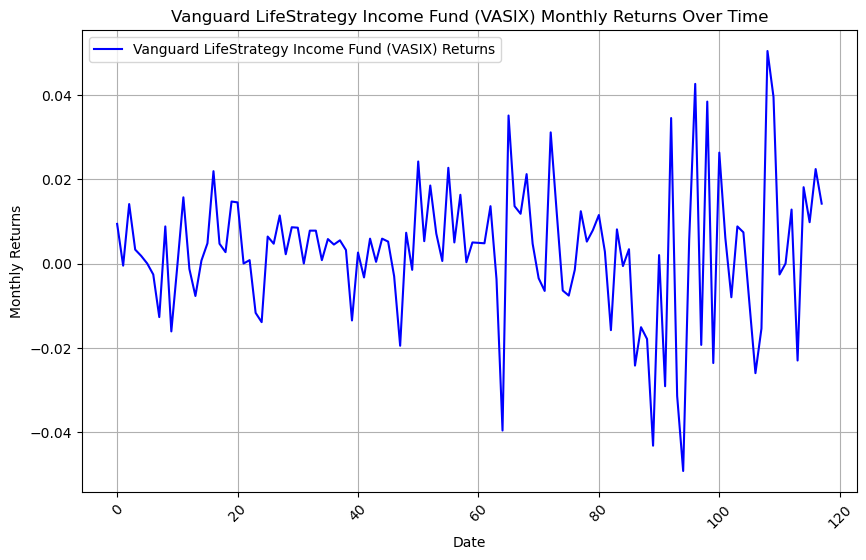

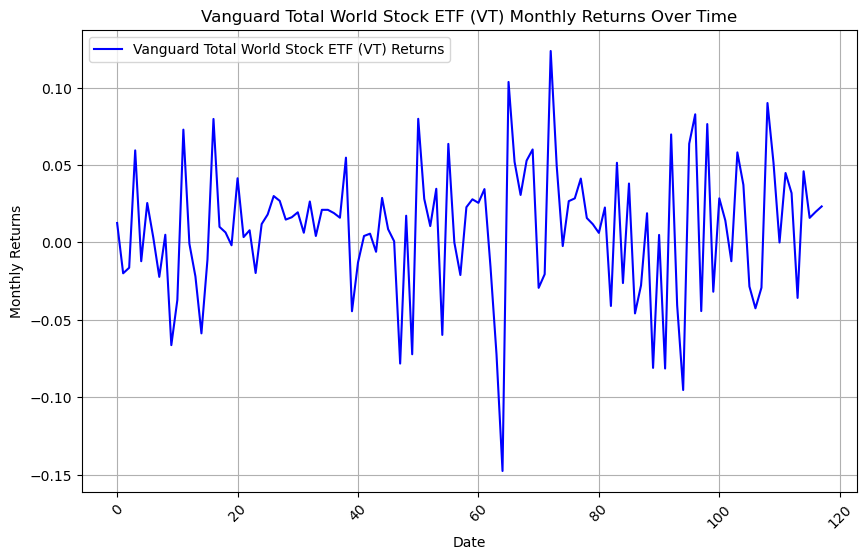

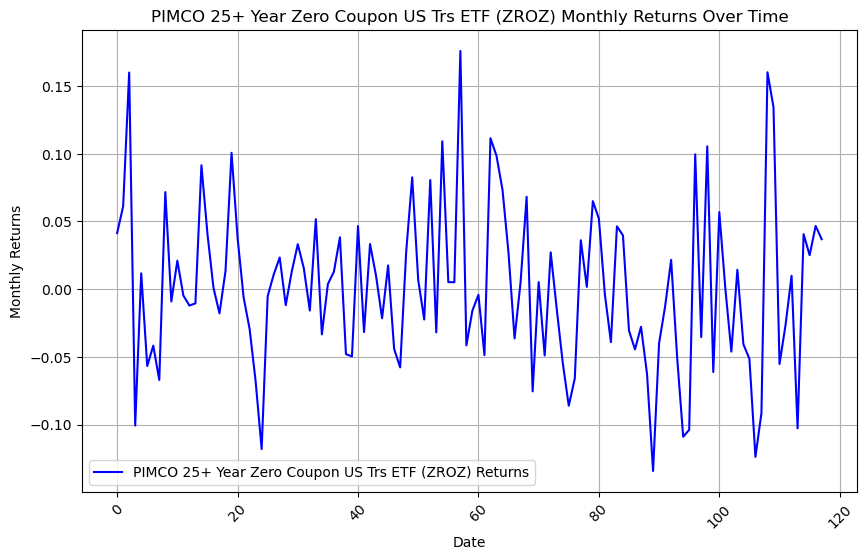

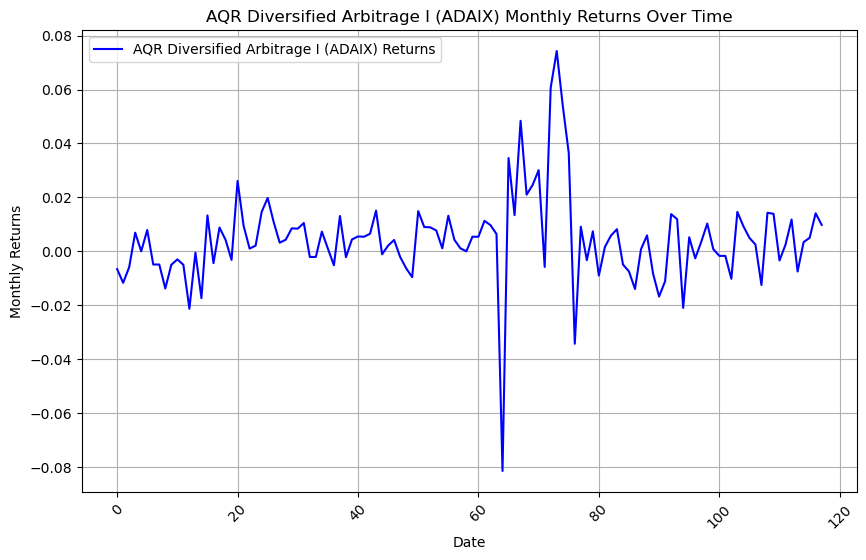

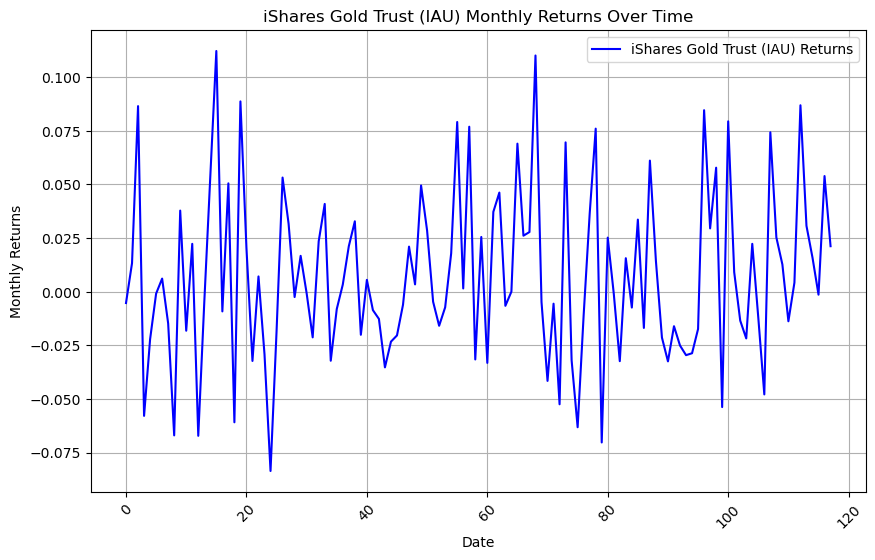

...

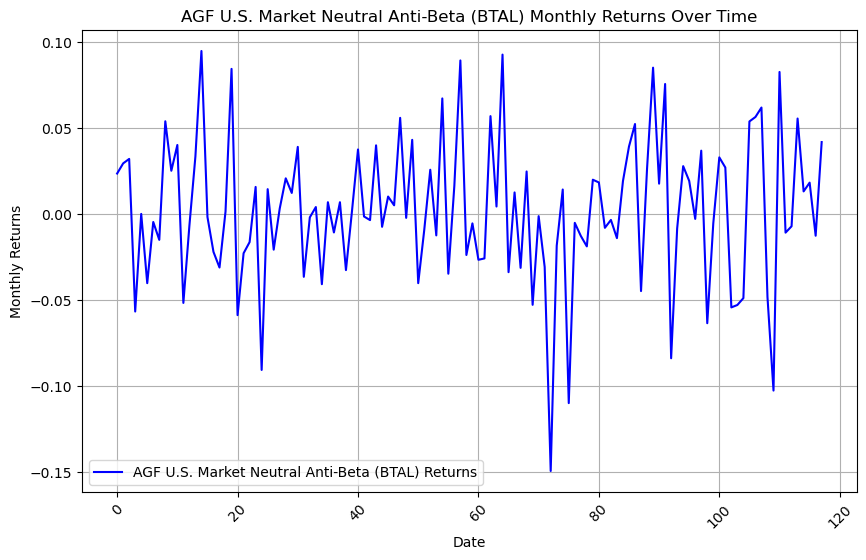

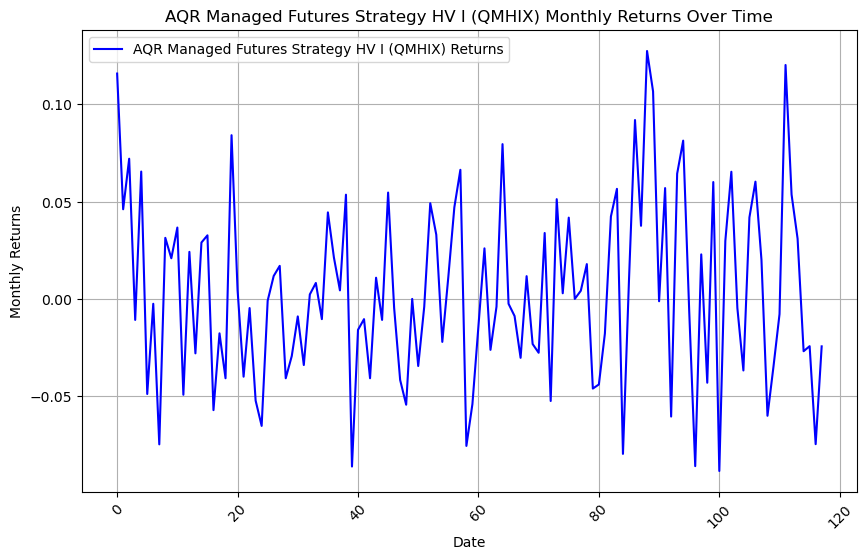

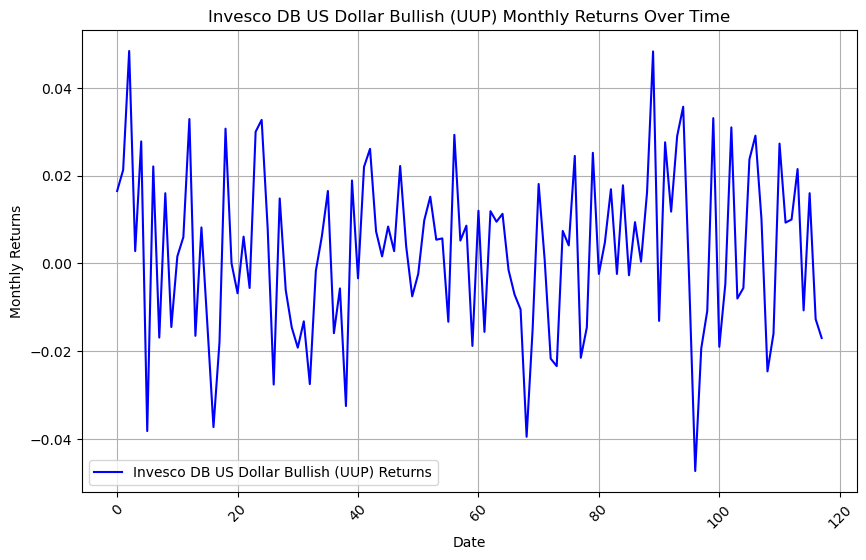

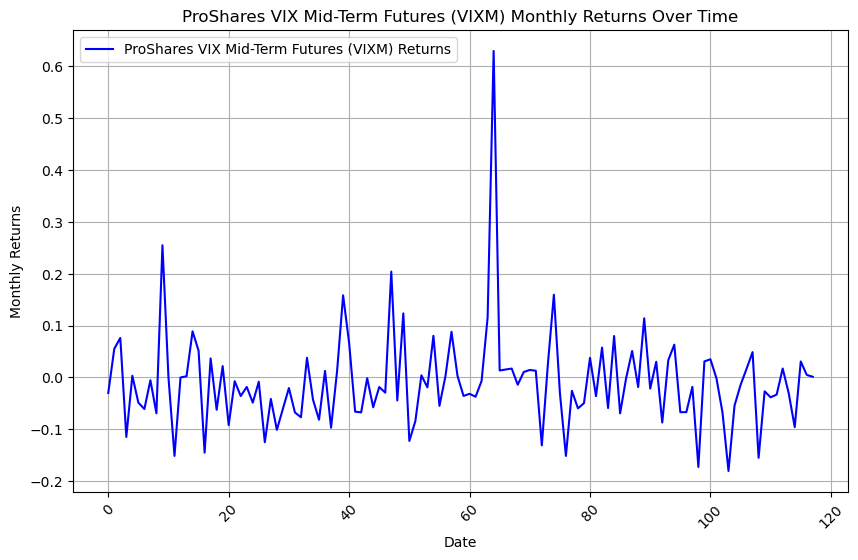

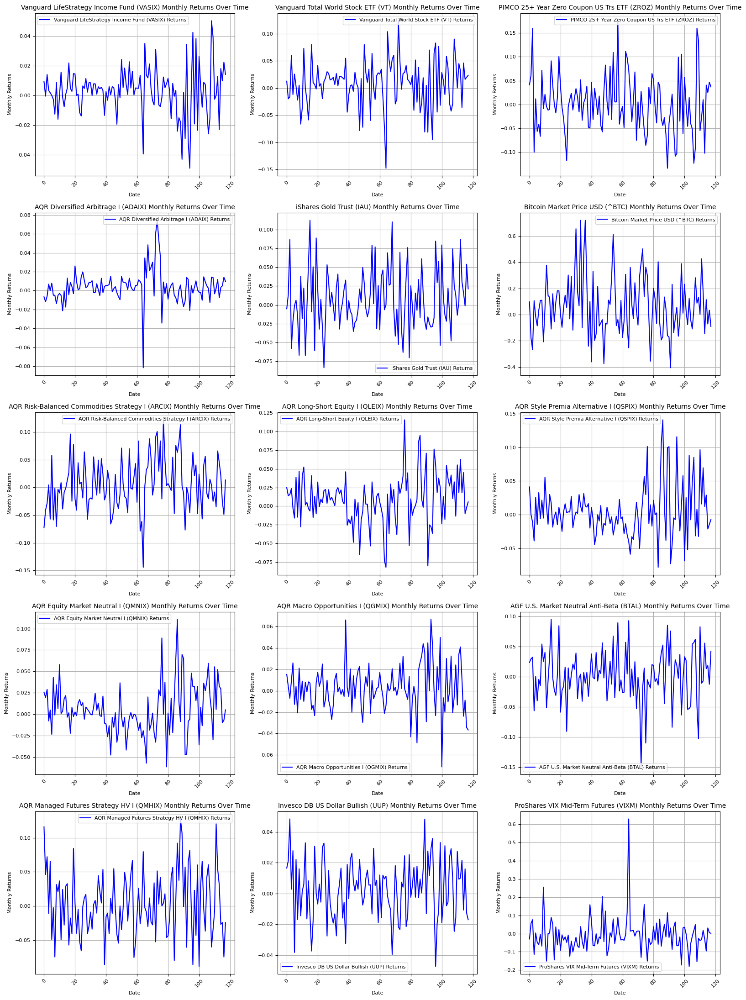

In [222]:
import os
import matplotlib.pyplot as plt
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
from matplotlib.figure import Figure
import numpy as np

# Comment-based snippet name for the folder
snippet_name = "MONTHLY_RETURN_PLOTS"

# Create the directory to save plots
output_folder = snippet_name
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Create a list to hold individual figures
figures = []

# Generate time series plots for each asset (excluding the 'Date' index)
for asset in data.columns:  # Loop through all asset columns
    if asset != 'Date':  # Exclude 'Date'
        fig, ax = plt.subplots(figsize=(10, 6))
        ax.plot(data.index, data[asset], label=f"{asset} Returns", color='blue')
        ax.set_title(f"{asset} Monthly Returns Over Time")
        ax.set_xlabel("Date")
        ax.set_ylabel("Monthly Returns")
        ax.tick_params(axis='x', rotation=45)
        ax.grid(True)
        ax.legend()

        # Save the individual figure to the list
        figures.append(fig)

        # Save the figure as a PNG file inside the created folder
        fig.savefig(os.path.join(output_folder, f"{asset}_monthly_returns.png"), bbox_inches='tight', dpi=300)  # Save with high resolution

        # Display the plot in Jupyter Notebook
        plt.show()

        # Close the figure to save memory
        plt.close(fig)

# Create a new figure to combine all plots into a single image
combined_fig, combined_axes = plt.subplots(num_rows, num_cols, figsize=(16, 22))  # Increase figure size for better readability
combined_axes = combined_axes.flatten()

# Add each individual figure to the combined figure
for i, fig in enumerate(figures):
    ax = combined_axes[i]
    for line in fig.axes[0].get_lines():
        ax.plot(line.get_xdata(), line.get_ydata(), label=line.get_label(), color=line.get_color())
    ax.set_title(fig.axes[0].get_title(), fontsize=10)
    ax.set_xlabel(fig.axes[0].get_xlabel(), fontsize=8)
    ax.set_ylabel(fig.axes[0].get_ylabel(), fontsize=8)
    ax.tick_params(axis='x', rotation=45, labelsize=8)
    ax.tick_params(axis='y', labelsize=8)
    ax.grid(True)
    ax.legend(fontsize=8)

# Hide any unused subplots
for j in range(len(figures), len(combined_axes)):
    combined_fig.delaxes(combined_axes[j])

# Adjust layout to prevent overlap
combined_fig.tight_layout()

# Save the combined figure as a PNG file
combined_fig.savefig(os.path.join(output_folder, "combined_monthly_returns.png"), bbox_inches='tight', dpi=300)  # Save with high resolution

# Display the combined plot in Jupyter Notebook
plt.show()

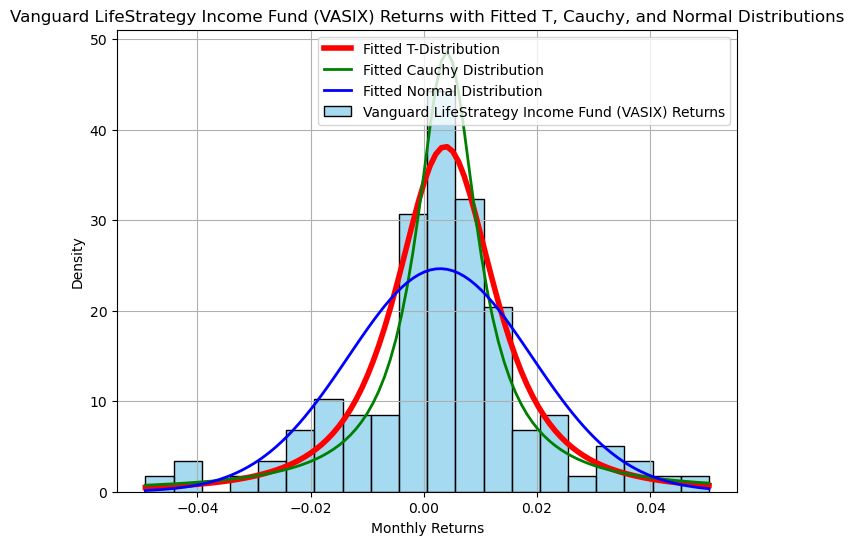

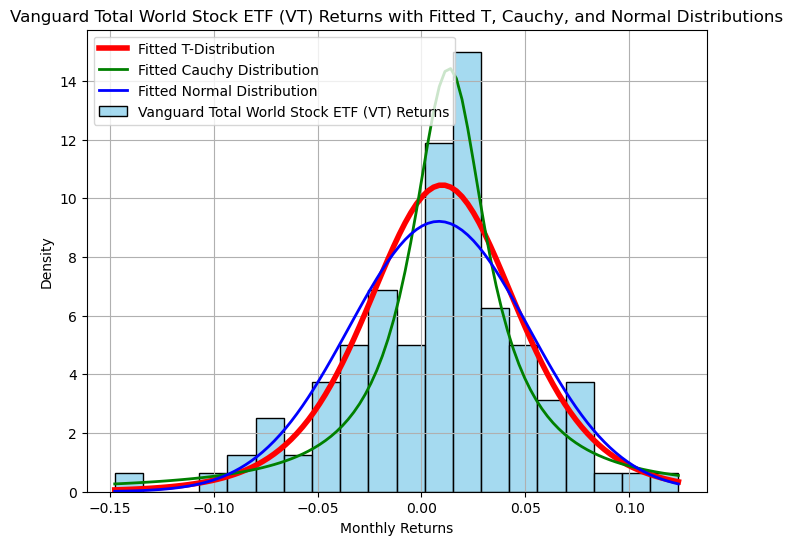

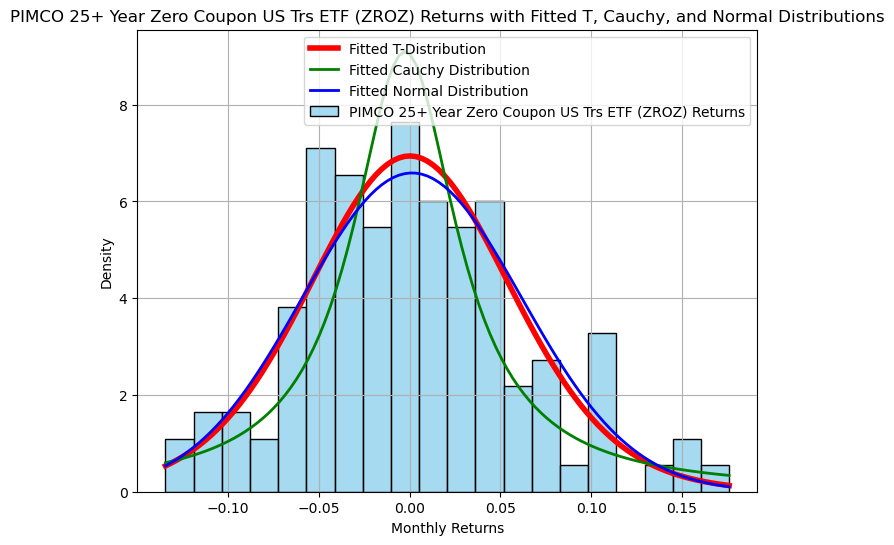

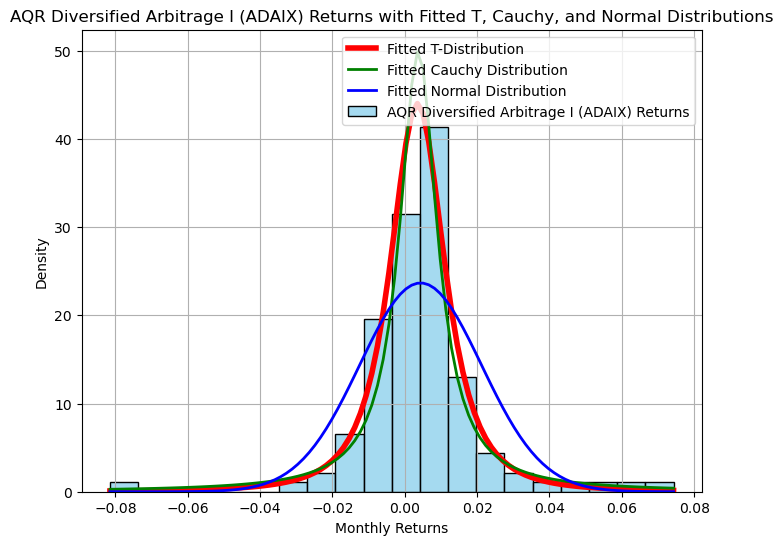

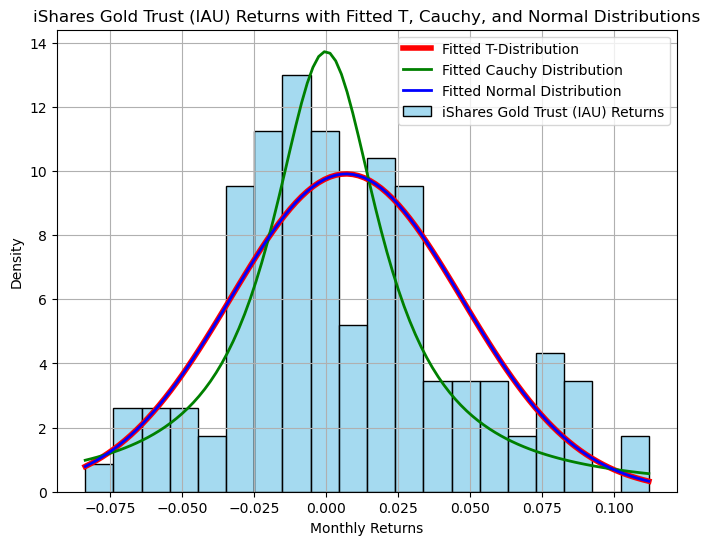

...

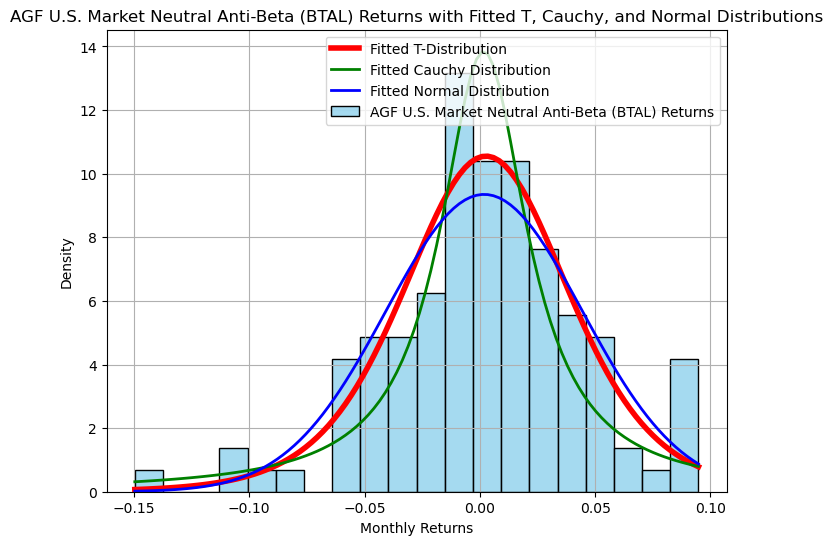

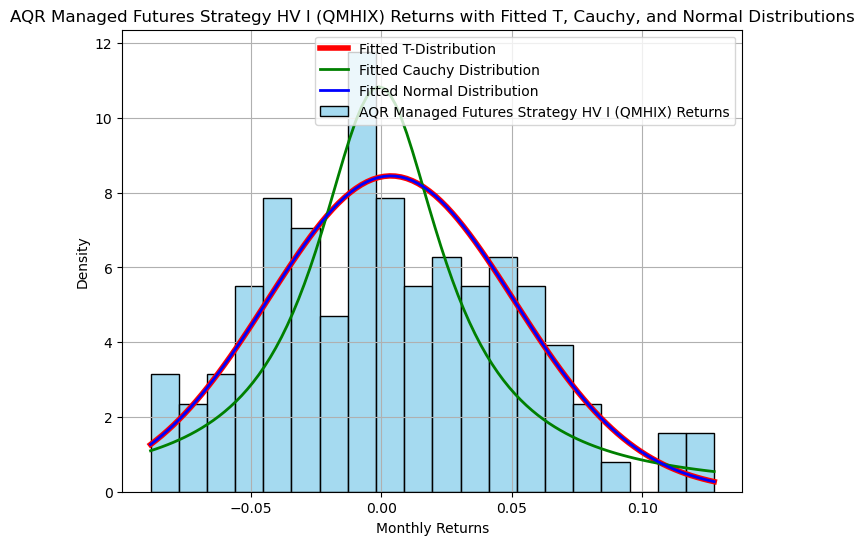

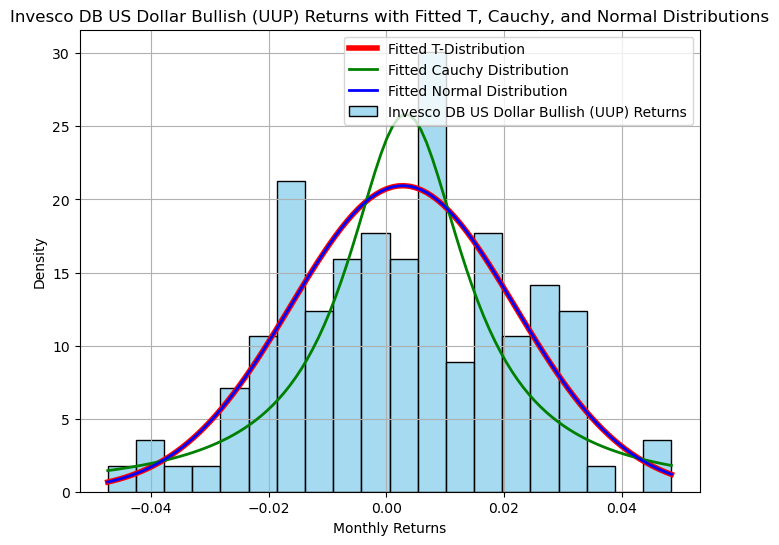

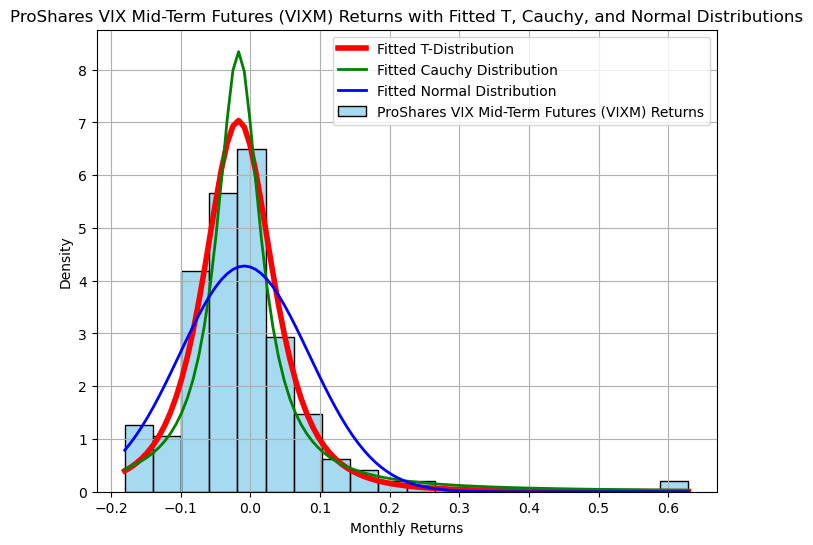

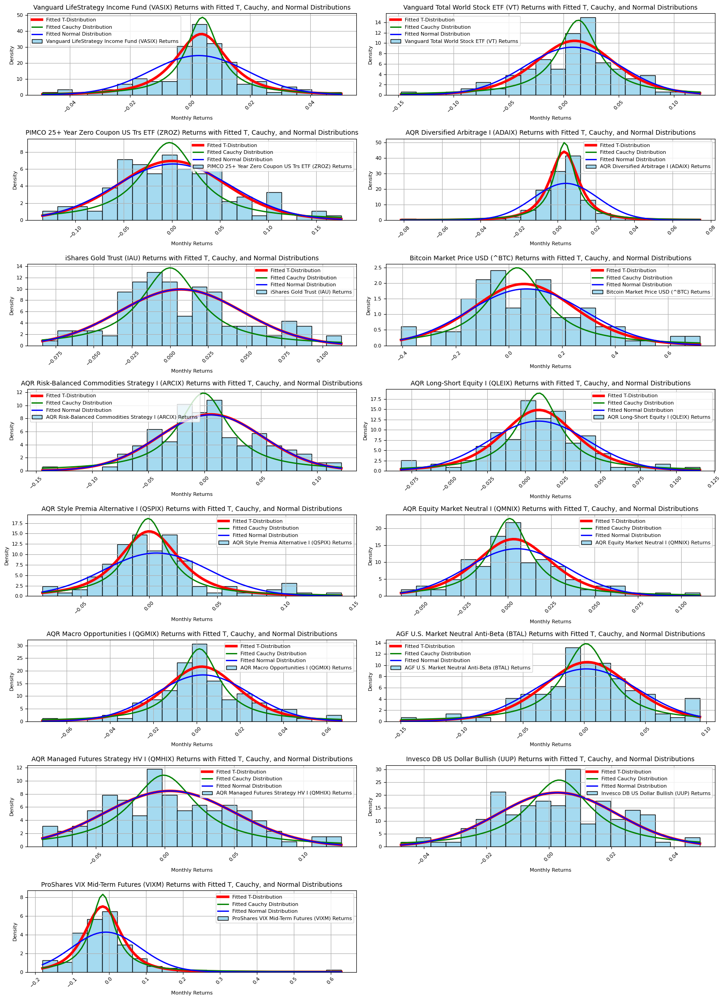

In [223]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import t, cauchy, norm

# Comment-based snippet name for the folder
snippet_name = "RAW_DATA_HISTOGRAMS_WITH_FITTED_PROBABILITY_DISTRIBUTIONS"

# Create the directory to save plots
output_folder = snippet_name
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Load the dataset to inspect the contents
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Create a list to hold individual figures data
figures_data = []

# Generate histogram plots with fitted distributions for each asset (excluding the 'Date' index)
for asset in data.columns:
    if asset != 'Date':
        asset_returns = data[asset].dropna()  # Ensure no NaNs in returns data
        x = np.linspace(asset_returns.min(), asset_returns.max(), 100)

        # Fit the T-distribution
        df_t, loc_t, scale_t = t.fit(asset_returns)
        pdf_t = t.pdf(x, df_t, loc_t, scale_t)

        # Fit the Cauchy distribution
        loc_cauchy, scale_cauchy = cauchy.fit(asset_returns)
        pdf_cauchy = cauchy.pdf(x, loc_cauchy, scale_cauchy)

        # Fit the Normal distribution
        mu_normal, std_normal = norm.fit(asset_returns)
        pdf_normal = norm.pdf(x, mu_normal, std_normal)

        # Save the data needed to recreate the plots
        figures_data.append((asset_returns, x, pdf_t, pdf_cauchy, pdf_normal, asset))

        # Plot the asset returns with fitted distributions
        fig, ax = plt.subplots(figsize=(8, 6))
        sns.histplot(asset_returns, bins=20, kde=False, stat='density', color='skyblue', label=f'{asset} Returns', ax=ax)
        ax.plot(x, pdf_t, 'r-', lw=4, label='Fitted T-Distribution')
        ax.plot(x, pdf_cauchy, 'g-', lw=2, label='Fitted Cauchy Distribution')
        ax.plot(x, pdf_normal, 'b-', lw=2, label='Fitted Normal Distribution')
        ax.set_title(f"{asset} Returns with Fitted T, Cauchy, and Normal Distributions")
        ax.set_xlabel("Monthly Returns")
        ax.set_ylabel("Density")
        ax.legend()
        ax.grid(True)

        # Save the plot as a PNG file inside the created folder
        fig.savefig(os.path.join(output_folder, f"{asset}_fitted_distributions.png"), bbox_inches='tight', dpi=300)  # Save with high resolution

        # Display the plot
        plt.show()

        # Close the figure to save memory
        plt.close(fig)

# Create a new figure to combine all plots into a single image
combined_fig, combined_axes = plt.subplots(len(figures_data) // 2 + len(figures_data) % 2, 2, figsize=(16, 22))  # Increase figure size for better readability
combined_axes = combined_axes.flatten()

# Add each individual figure to the combined figure without distortion
for i, (asset_returns, x, pdf_t, pdf_cauchy, pdf_normal, asset) in enumerate(figures_data):
    ax = combined_axes[i]
    sns.histplot(asset_returns, bins=20, kde=False, stat='density', color='skyblue', label=f'{asset} Returns', ax=ax)
    ax.plot(x, pdf_t, 'r-', lw=4, label='Fitted T-Distribution')
    ax.plot(x, pdf_cauchy, 'g-', lw=2, label='Fitted Cauchy Distribution')
    ax.plot(x, pdf_normal, 'b-', lw=2, label='Fitted Normal Distribution')
    ax.set_title(f"{asset} Returns with Fitted T, Cauchy, and Normal Distributions", fontsize=10)
    ax.set_xlabel("Monthly Returns", fontsize=8)
    ax.set_ylabel("Density", fontsize=8)
    ax.tick_params(axis='x', rotation=45, labelsize=8)
    ax.tick_params(axis='y', labelsize=8)
    ax.grid(True)
    ax.legend(fontsize=8)

# Hide any unused subplots
for j in range(len(figures_data), len(combined_axes)):
    combined_fig.delaxes(combined_axes[j])

# Adjust layout to prevent overlap
combined_fig.tight_layout()

# Save the combined figure as a PNG file
combined_fig.savefig(os.path.join(output_folder, "combined_fitted_distributions.png"), bbox_inches='tight', dpi=300)  # Save with high resolution

# Display the combined plot in Jupyter Notebook
plt.show()


Processing asset: Vanguard LifeStrategy Income Fund (VASIX)
Sample size for Vanguard LifeStrategy Income Fund (VASIX): 118
Generated 10000 bootstrap samples for Vanguard LifeStrategy Income Fund (VASIX)
T-distribution (bootstrap sample 1) for Vanguard LifeStrategy Income Fund (VASIX): df=1.956378101903753, loc=0.0034606590966898363, scale=0.008814999233264615
Cauchy distribution (bootstrap sample 1) for Vanguard LifeStrategy Income Fund (VASIX): loc=0.003946290283203128, scale=0.006381025695800782
Normal distribution (bootstrap sample 1) for Vanguard LifeStrategy Income Fund (VASIX): mu=0.0028618644067796603, std=0.016445276069393413


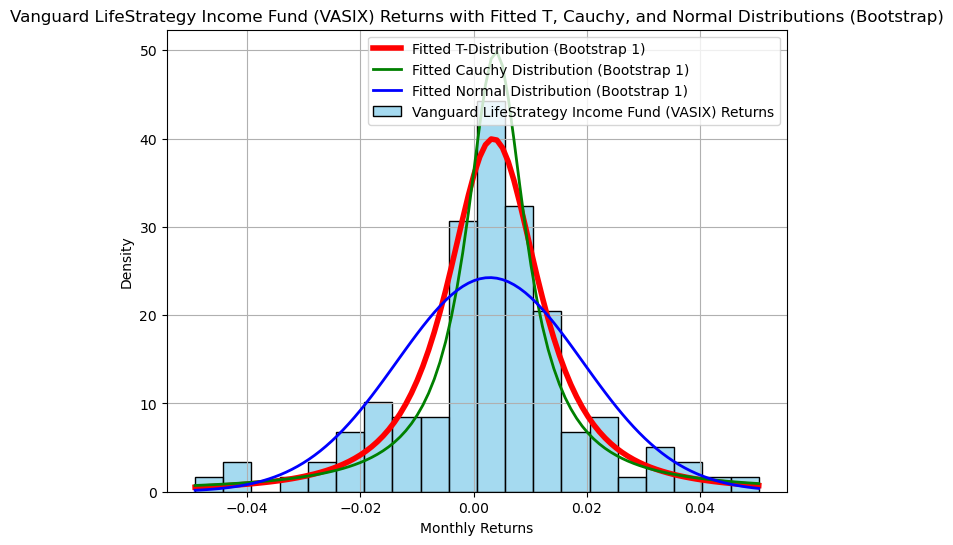

Processing asset: Vanguard Total World Stock ETF (VT)
Sample size for Vanguard Total World Stock ETF (VT): 118
Generated 10000 bootstrap samples for Vanguard Total World Stock ETF (VT)
T-distribution (bootstrap sample 1) for Vanguard Total World Stock ETF (VT): df=9.78644039384685, loc=0.01131856598396287, scale=0.04128527893327103
Cauchy distribution (bootstrap sample 1) for Vanguard Total World Stock ETF (VT): loc=0.0179924407196045, scale=0.024764436893463145
Normal distribution (bootstrap sample 1) for Vanguard Total World Stock ETF (VT): mu=0.009930508474576268, std=0.04616225163499545


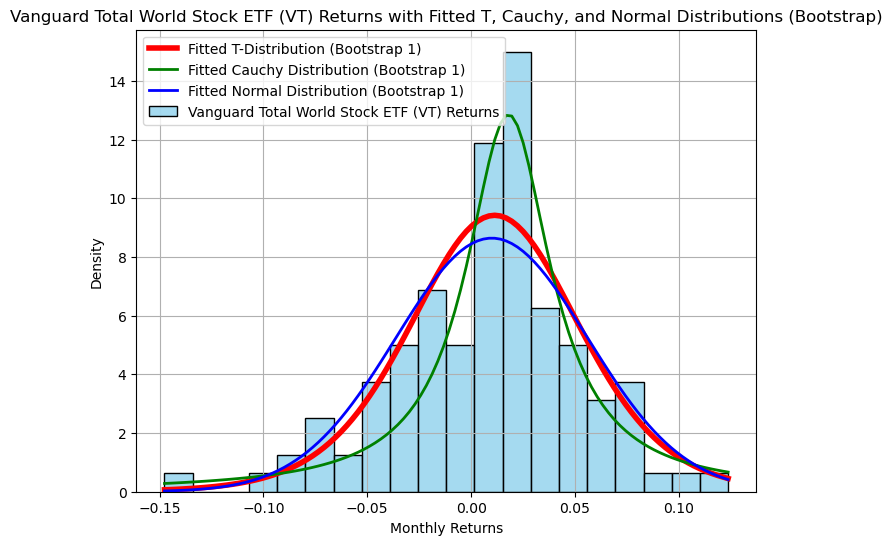

Processing asset: PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ)
Sample size for PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ): 118
Generated 10000 bootstrap samples for PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ)
T-distribution (bootstrap sample 1) for PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ): df=24.656814475453324, loc=-0.0014819552827638905, scale=0.06253491500541206
Cauchy distribution (bootstrap sample 1) for PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ): loc=-0.009804352569580075, scale=0.03829215755462646
Normal distribution (bootstrap sample 1) for PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ): mu=-0.0003152542372881355, std=0.06520045313755223


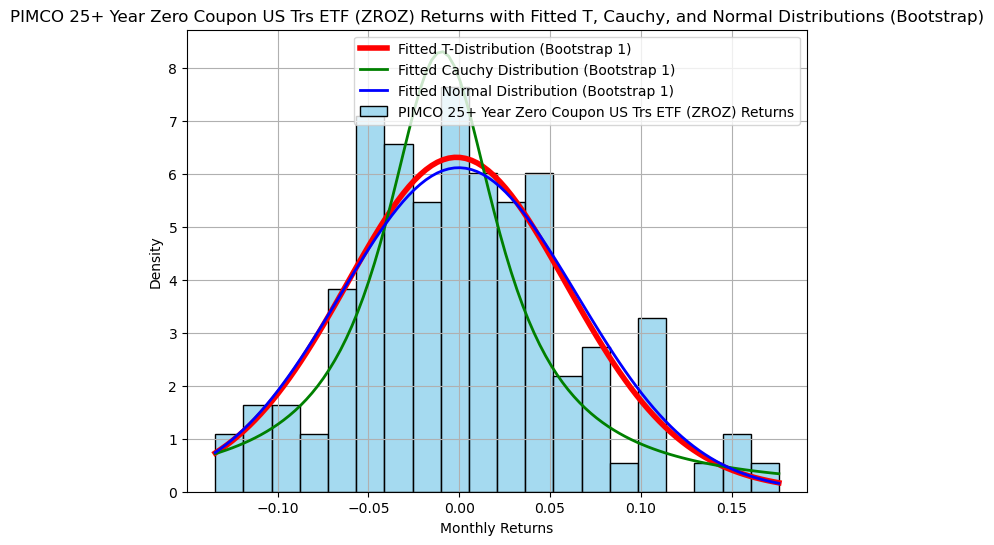

Processing asset: AQR Diversified Arbitrage I (ADAIX)
Sample size for AQR Diversified Arbitrage I (ADAIX): 118
Generated 10000 bootstrap samples for AQR Diversified Arbitrage I (ADAIX)
T-distribution (bootstrap sample 1) for AQR Diversified Arbitrage I (ADAIX): df=2.1051784556600994, loc=0.003028803854770541, scale=0.007358428118987846
Cauchy distribution (bootstrap sample 1) for AQR Diversified Arbitrage I (ADAIX): loc=0.0034074022448062897, scale=0.00559452017068863
Normal distribution (bootstrap sample 1) for AQR Diversified Arbitrage I (ADAIX): mu=0.0032635593220338988, std=0.015974819514400388


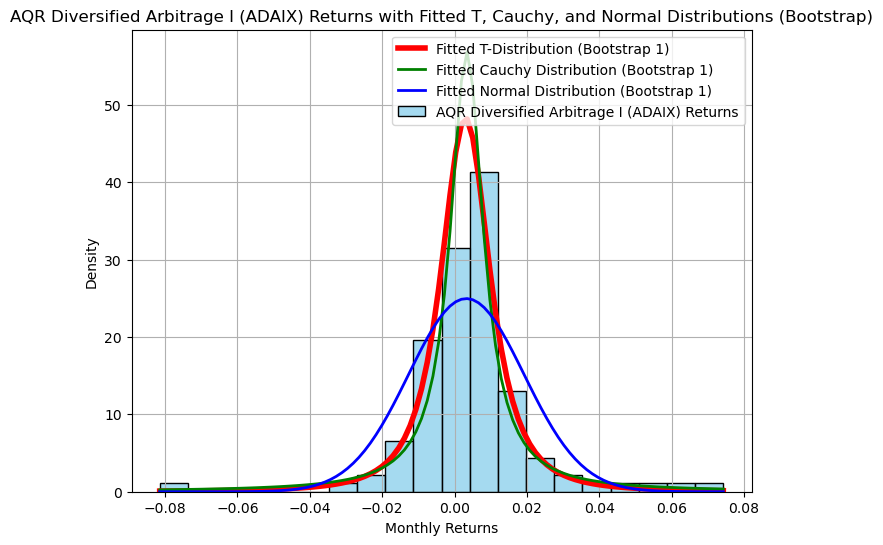

Processing asset: iShares Gold Trust (IAU)
Sample size for iShares Gold Trust (IAU): 118
Generated 10000 bootstrap samples for iShares Gold Trust (IAU)
T-distribution (bootstrap sample 1) for iShares Gold Trust (IAU): df=77687627.1355466, loc=0.006466271249758279, scale=0.04198890758460215
Cauchy distribution (bootstrap sample 1) for iShares Gold Trust (IAU): loc=0.004067714843749998, scale=0.02673567626953123
Normal distribution (bootstrap sample 1) for iShares Gold Trust (IAU): mu=0.006465254237288135, std=0.041988883470567


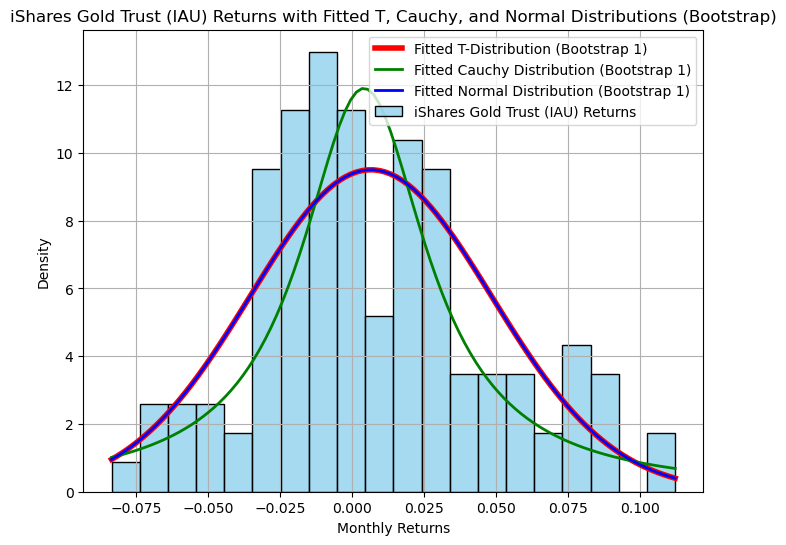

Processing asset: Bitcoin Market Price USD (^BTC)
Sample size for Bitcoin Market Price USD (^BTC): 118
Generated 10000 bootstrap samples for Bitcoin Market Price USD (^BTC)
T-distribution (bootstrap sample 1) for Bitcoin Market Price USD (^BTC): df=4.860119950305238, loc=-0.015827461176361832, scale=0.1719489996044889
Cauchy distribution (bootstrap sample 1) for Bitcoin Market Price USD (^BTC): loc=-0.04848809051513672, scale=0.10357635573148724
Normal distribution (bootstrap sample 1) for Bitcoin Market Price USD (^BTC): mu=0.00669915254237288, std=0.21771582726104177


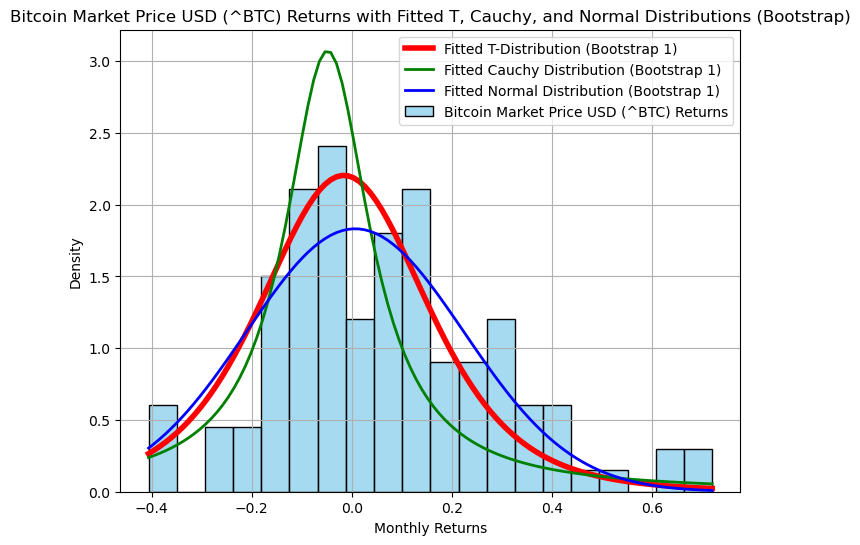

Processing asset: AQR Risk-Balanced Commodities Strategy I (ARCIX)
Sample size for AQR Risk-Balanced Commodities Strategy I (ARCIX): 118
Generated 10000 bootstrap samples for AQR Risk-Balanced Commodities Strategy I (ARCIX)
T-distribution (bootstrap sample 1) for AQR Risk-Balanced Commodities Strategy I (ARCIX): df=19.37171366181257, loc=-0.0026848943257237147, scale=0.04253837825578191
Cauchy distribution (bootstrap sample 1) for AQR Risk-Balanced Commodities Strategy I (ARCIX): loc=-0.0045551513671874995, scale=0.025545849609375004
Normal distribution (bootstrap sample 1) for AQR Risk-Balanced Commodities Strategy I (ARCIX): mu=-0.0030322033898305084, std=0.044922179191137494


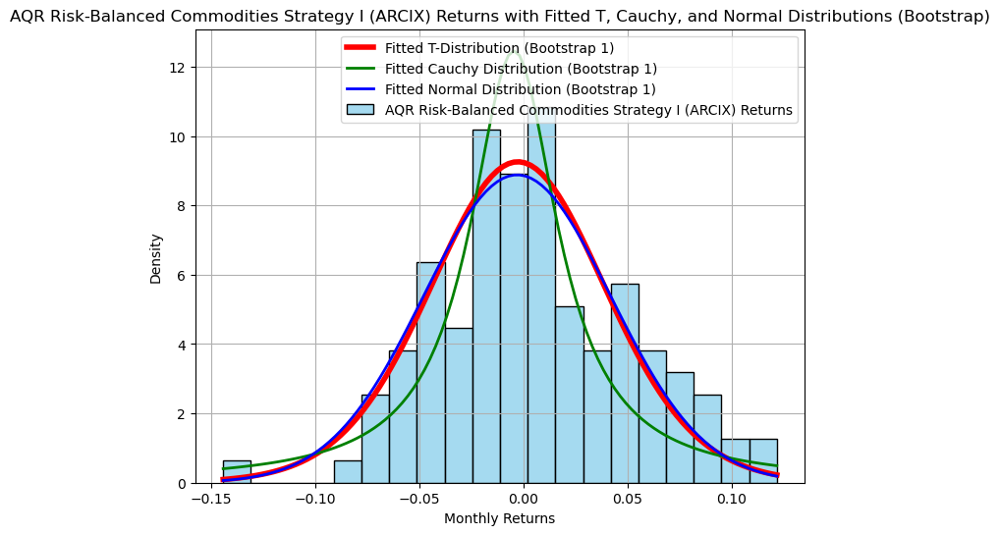

Processing asset: AQR Long-Short Equity I (QLEIX)
Sample size for AQR Long-Short Equity I (QLEIX): 118
Generated 10000 bootstrap samples for AQR Long-Short Equity I (QLEIX)
T-distribution (bootstrap sample 1) for AQR Long-Short Equity I (QLEIX): df=6.285379031550519, loc=0.006929840838428269, scale=0.021435317380477457
Cauchy distribution (bootstrap sample 1) for AQR Long-Short Equity I (QLEIX): loc=0.007720087471008306, scale=0.013572147006988517
Normal distribution (bootstrap sample 1) for AQR Long-Short Equity I (QLEIX): mu=0.006995762711864408, std=0.025903165155946418


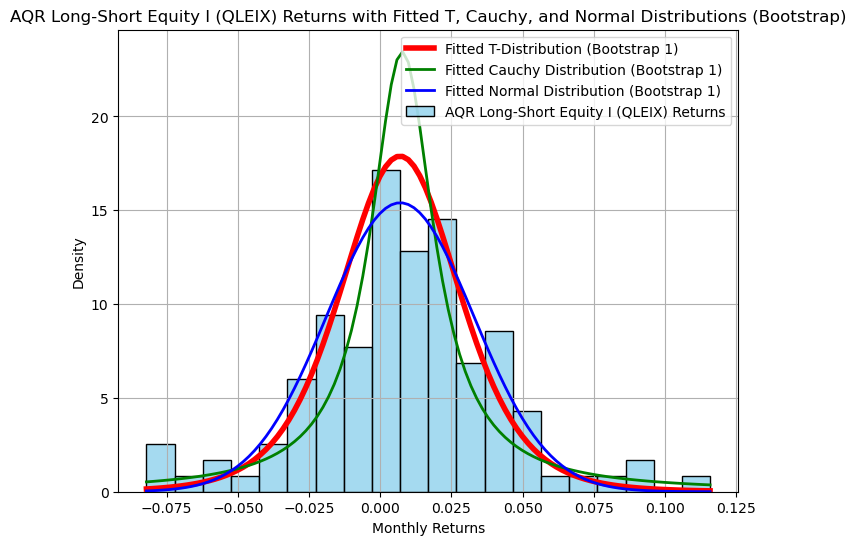

Processing asset: AQR Style Premia Alternative I (QSPIX)
Sample size for AQR Style Premia Alternative I (QSPIX): 118
Generated 10000 bootstrap samples for AQR Style Premia Alternative I (QSPIX)
T-distribution (bootstrap sample 1) for AQR Style Premia Alternative I (QSPIX): df=2.3799453028769526, loc=0.003922064284863776, scale=0.02248717909894548
Cauchy distribution (bootstrap sample 1) for AQR Style Premia Alternative I (QSPIX): loc=0.0029591015624999975, scale=0.016713115234374992
Normal distribution (bootstrap sample 1) for AQR Style Premia Alternative I (QSPIX): mu=0.009477118644067797, std=0.03863517632061366


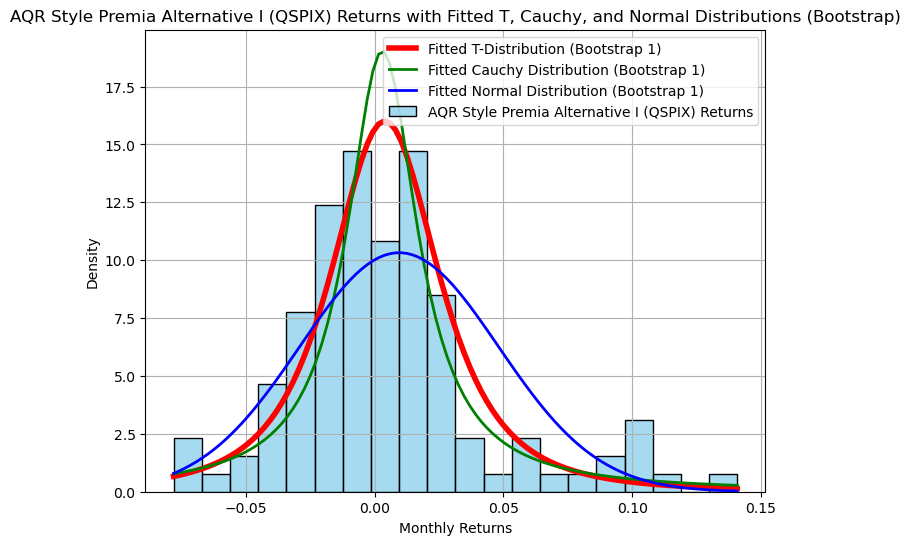

Processing asset: AQR Equity Market Neutral I (QMNIX)
Sample size for AQR Equity Market Neutral I (QMNIX): 118
Generated 10000 bootstrap samples for AQR Equity Market Neutral I (QMNIX)
T-distribution (bootstrap sample 1) for AQR Equity Market Neutral I (QMNIX): df=2.752414197667882, loc=0.0017245034656225011, scale=0.018174074308105498
Cauchy distribution (bootstrap sample 1) for AQR Equity Market Neutral I (QMNIX): loc=7.509326934814763e-05, scale=0.011768711147308349
Normal distribution (bootstrap sample 1) for AQR Equity Market Neutral I (QMNIX): mu=0.0051813559322033895, std=0.02791324923593114


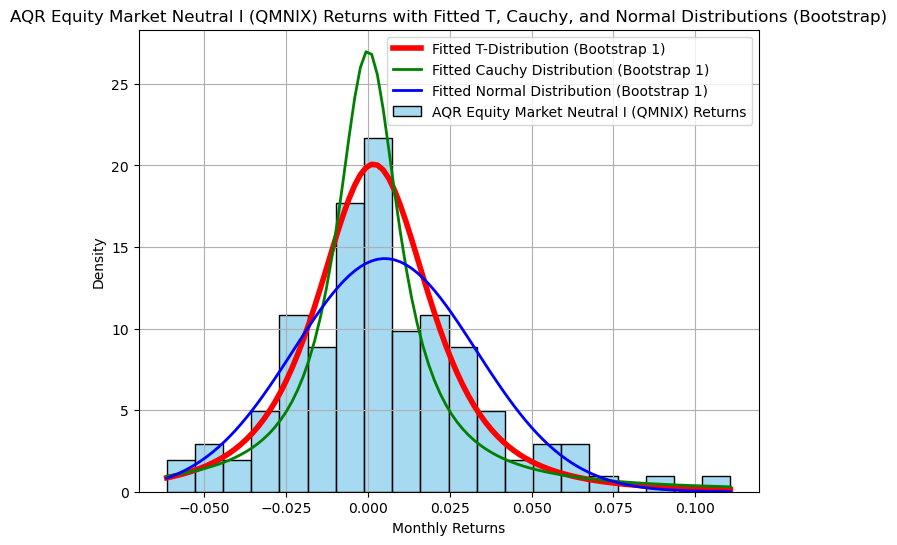

Processing asset: AQR Macro Opportunities I (QGMIX)
Sample size for AQR Macro Opportunities I (QGMIX): 118
Generated 10000 bootstrap samples for AQR Macro Opportunities I (QGMIX)
T-distribution (bootstrap sample 1) for AQR Macro Opportunities I (QGMIX): df=8.334130299039012, loc=0.0005889954132269309, scale=0.01954241667432008
Cauchy distribution (bootstrap sample 1) for AQR Macro Opportunities I (QGMIX): loc=0.00022903060913085938, scale=0.013070920524597166
Normal distribution (bootstrap sample 1) for AQR Macro Opportunities I (QGMIX): mu=0.00133728813559322, std=0.022314279826407466


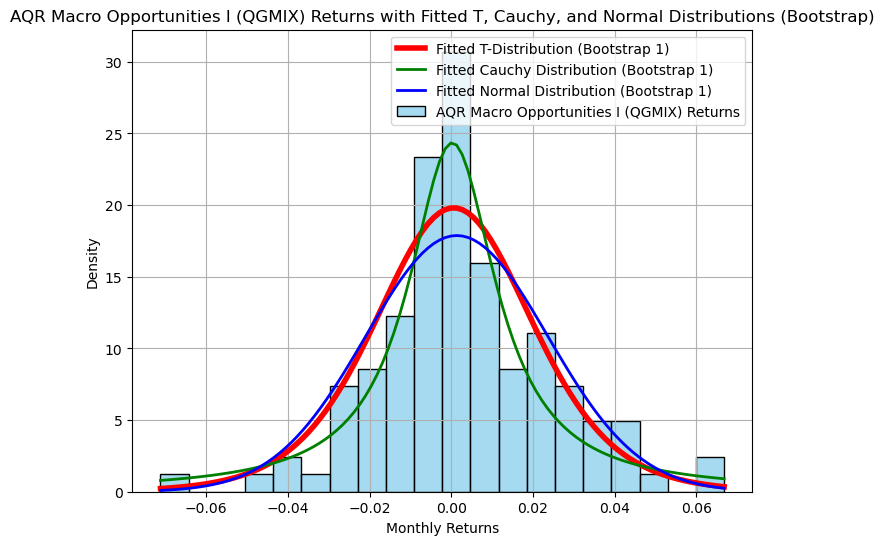

Processing asset: AGF U.S. Market Neutral Anti-Beta (BTAL)
Sample size for AGF U.S. Market Neutral Anti-Beta (BTAL): 118
Generated 10000 bootstrap samples for AGF U.S. Market Neutral Anti-Beta (BTAL)
T-distribution (bootstrap sample 1) for AGF U.S. Market Neutral Anti-Beta (BTAL): df=6.48479304828156, loc=0.005039942826166604, scale=0.03469754281634923
Cauchy distribution (bootstrap sample 1) for AGF U.S. Market Neutral Anti-Beta (BTAL): loc=0.005942579373642775, scale=0.022066332475617553
Normal distribution (bootstrap sample 1) for AGF U.S. Market Neutral Anti-Beta (BTAL): mu=0.0028118644067796593, std=0.04138110632801843


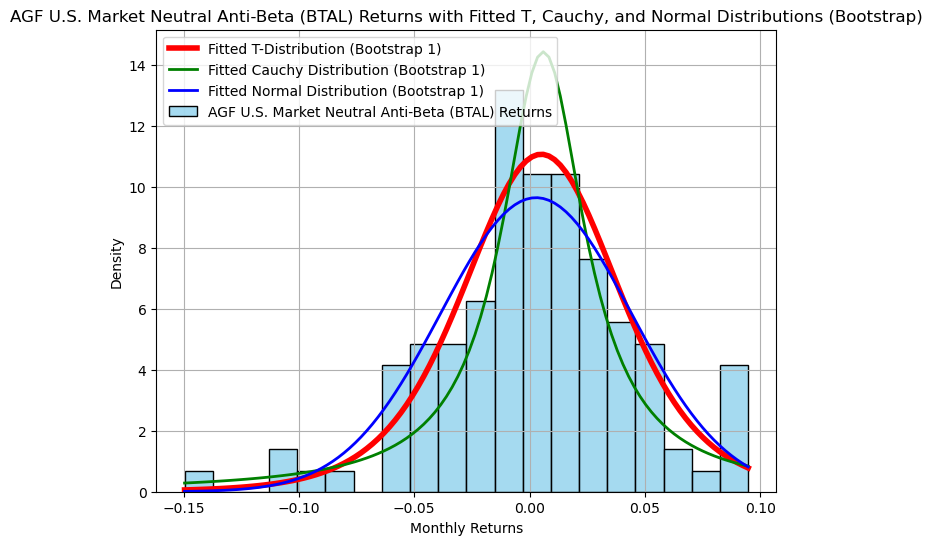

Processing asset: AQR Managed Futures Strategy HV I (QMHIX)
Sample size for AQR Managed Futures Strategy HV I (QMHIX): 118
Generated 10000 bootstrap samples for AQR Managed Futures Strategy HV I (QMHIX)
T-distribution (bootstrap sample 1) for AQR Managed Futures Strategy HV I (QMHIX): df=50763261.229058936, loc=0.0018611596069398385, scale=0.045803673873945835
Cauchy distribution (bootstrap sample 1) for AQR Managed Futures Strategy HV I (QMHIX): loc=0.004797530364990234, scale=0.03060086944580081
Normal distribution (bootstrap sample 1) for AQR Managed Futures Strategy HV I (QMHIX): mu=0.0018618644067796611, std=0.04580367448714118


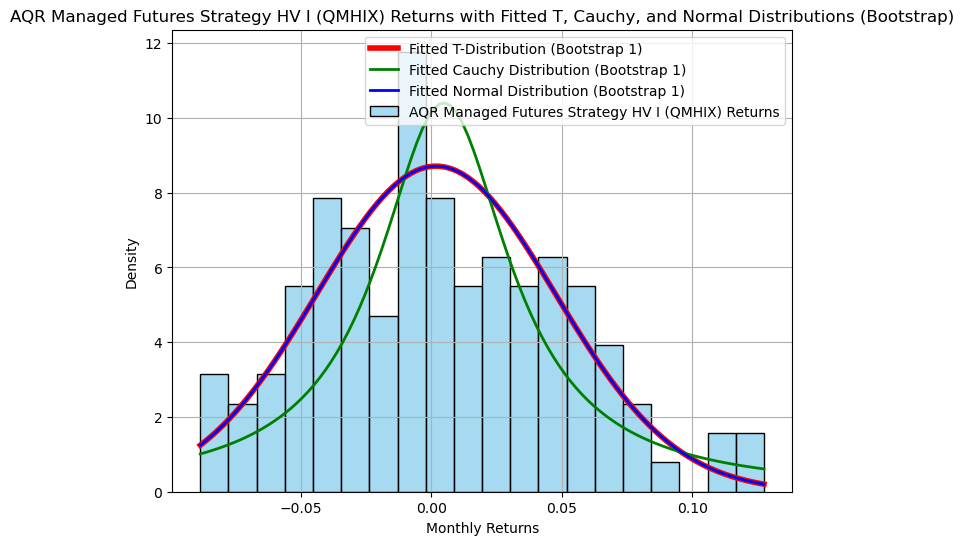

Processing asset: Invesco DB US Dollar Bullish (UUP)
Sample size for Invesco DB US Dollar Bullish (UUP): 118
Generated 10000 bootstrap samples for Invesco DB US Dollar Bullish (UUP)
T-distribution (bootstrap sample 1) for Invesco DB US Dollar Bullish (UUP): df=1153674967.9121346, loc=0.0002805472746499016, scale=0.018369836153368693
Cauchy distribution (bootstrap sample 1) for Invesco DB US Dollar Bullish (UUP): loc=0.0009655019378661998, scale=0.012221919751167296
Normal distribution (bootstrap sample 1) for Invesco DB US Dollar Bullish (UUP): mu=0.00028050847457627103, std=0.018369817998575153


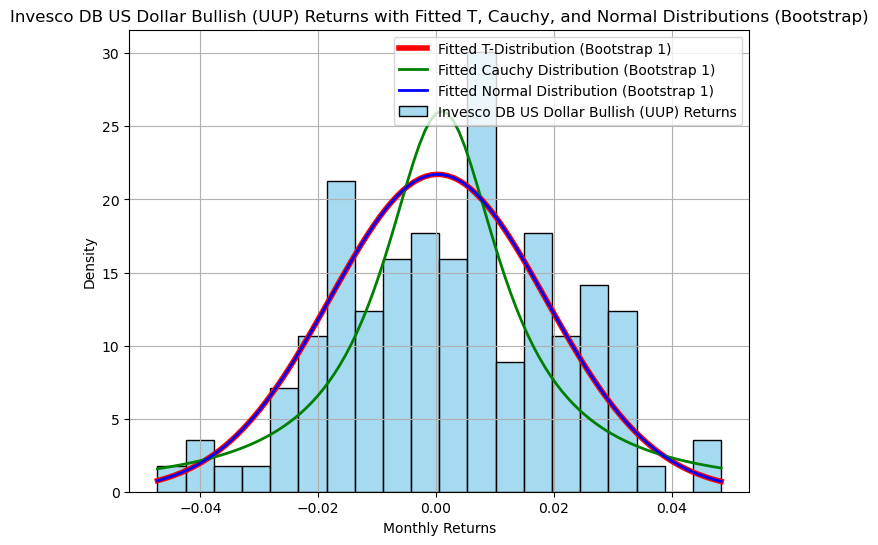

Processing asset: ProShares VIX Mid-Term Futures (VIXM)
Sample size for ProShares VIX Mid-Term Futures (VIXM): 118
Generated 10000 bootstrap samples for ProShares VIX Mid-Term Futures (VIXM)
T-distribution (bootstrap sample 1) for ProShares VIX Mid-Term Futures (VIXM): df=3.095677908168222, loc=-0.013462197022454804, scale=0.0453945227752702
Cauchy distribution (bootstrap sample 1) for ProShares VIX Mid-Term Futures (VIXM): loc=-0.016899438800811767, scale=0.03138803463935852
Normal distribution (bootstrap sample 1) for ProShares VIX Mid-Term Futures (VIXM): mu=-0.006954237288135595, std=0.06688818603608512


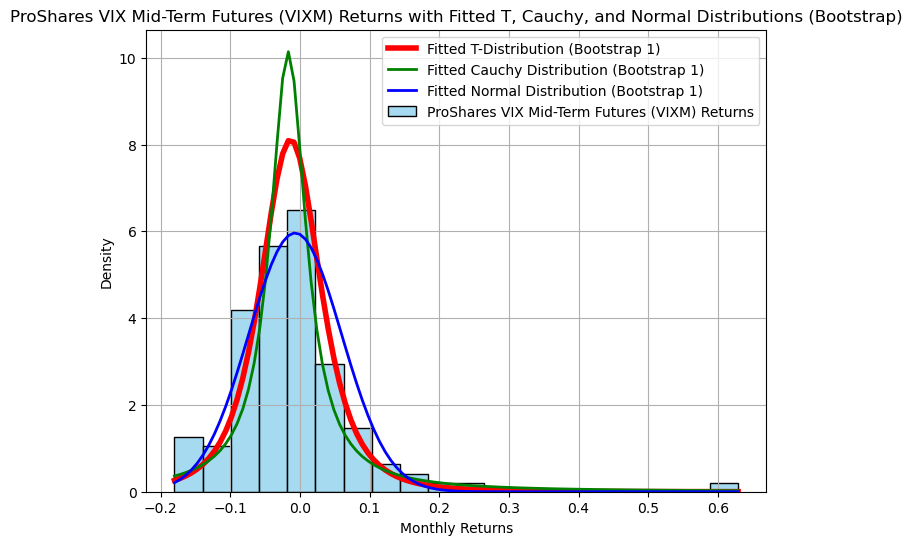

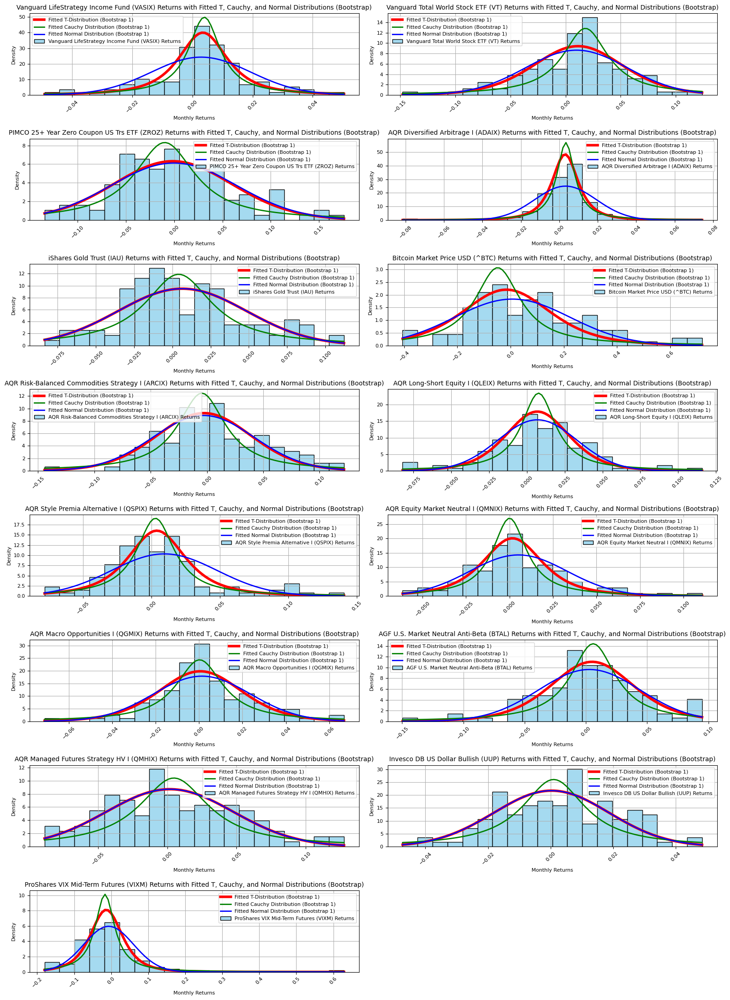

In [198]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import t, cauchy, norm
import os

# Comment-based snippet name for the folder
snippet_name = "BOOTSTRAP_FITTED_DISTRIBUTIONS"

# Create the directory to save plots
output_folder = snippet_name
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Number of bootstrap iterations
n_iterations = 10000

# Create a list to hold individual figures data
figures_data = []

# Iterate over each asset, excluding the 'Date' column
for asset in data.columns:
    if asset != 'Date':
        print(f"Processing asset: {asset}")  # Debug: Check asset being processed
        asset_returns = data[asset].dropna()  # Ensure no NaNs in returns data
        print(f"Sample size for {asset}: {len(asset_returns)}")  # Debug: Check sample size
        x = np.linspace(asset_returns.min(), asset_returns.max(), 100)

        # Non-parametric bootstrap: Resample with replacement
        bootstrap_samples = np.random.choice(asset_returns, size=(len(asset_returns), n_iterations), replace=True)
        print(f"Generated {n_iterations} bootstrap samples for {asset}")  # Debug: Check bootstrap generation

        # Use the first bootstrap sample to fit distributions
        first_bootstrap_sample = bootstrap_samples[:, 0]

        # Fit the T-distribution to the first bootstrap sample
        df_t, loc_t, scale_t = t.fit(first_bootstrap_sample)
        print(f"T-distribution (bootstrap sample 1) for {asset}: df={df_t}, loc={loc_t}, scale={scale_t}")  # Debug

        # Fit the Cauchy distribution to the first bootstrap sample
        loc_cauchy, scale_cauchy = cauchy.fit(first_bootstrap_sample)
        print(f"Cauchy distribution (bootstrap sample 1) for {asset}: loc={loc_cauchy}, scale={scale_cauchy}")  # Debug

        # Fit the Normal distribution to the first bootstrap sample
        mu_normal, std_normal = norm.fit(first_bootstrap_sample)
        print(f"Normal distribution (bootstrap sample 1) for {asset}: mu={mu_normal}, std={std_normal}")  # Debug

        # Save the data needed to recreate the plots
        figures_data.append((asset_returns, x, df_t, loc_t, scale_t, loc_cauchy, scale_cauchy, mu_normal, std_normal, asset))

        # Plot the original asset returns with the fitted distributions from the first bootstrap sample
        fig, ax = plt.subplots(figsize=(8, 6))
        sns.histplot(asset_returns, bins=20, kde=False, stat='density', color='skyblue', label=f'{asset} Returns', ax=ax)

        # Plot the T-distribution fitted from the first bootstrap sample
        pdf_t = t.pdf(x, df_t, loc_t, scale_t)
        ax.plot(x, pdf_t, 'r-', lw=4, label='Fitted T-Distribution (Bootstrap 1)')

        # Plot the Cauchy distribution fitted from the first bootstrap sample
        pdf_cauchy = cauchy.pdf(x, loc_cauchy, scale_cauchy)
        ax.plot(x, pdf_cauchy, 'g-', lw=2, label='Fitted Cauchy Distribution (Bootstrap 1)')

        # Plot the Normal distribution fitted from the first bootstrap sample
        pdf_normal = norm.pdf(x, mu_normal, std_normal)
        ax.plot(x, pdf_normal, 'b-', lw=2, label='Fitted Normal Distribution (Bootstrap 1)')

        ax.set_title(f"{asset} Returns with Fitted T, Cauchy, and Normal Distributions (Bootstrap)")
        ax.set_xlabel("Monthly Returns")
        ax.set_ylabel("Density")
        ax.legend()
        ax.grid(True)

        # Save the plot as a PNG file inside the created folder
        fig.savefig(os.path.join(output_folder, f"{asset}_bootstrap_fitted_distributions.png"), bbox_inches='tight', dpi=300)  # Save with high resolution

        # Display the plot
        plt.show()

        # Close the figure to save memory
        plt.close(fig)

# Create a new figure to combine all plots into a single image
combined_fig, combined_axes = plt.subplots(len(figures_data) // 2 + len(figures_data) % 2, 2, figsize=(16, 22))  # Increase figure size for better readability
combined_axes = combined_axes.flatten()

# Add each individual figure to the combined figure without distortion
for i, (asset_returns, x, df_t, loc_t, scale_t, loc_cauchy, scale_cauchy, mu_normal, std_normal, asset) in enumerate(figures_data):
    ax = combined_axes[i]
    sns.histplot(asset_returns, bins=20, kde=False, stat='density', color='skyblue', label=f'{asset} Returns', ax=ax)
    pdf_t = t.pdf(x, df_t, loc_t, scale_t)
    ax.plot(x, pdf_t, 'r-', lw=4, label='Fitted T-Distribution (Bootstrap 1)')
    pdf_cauchy = cauchy.pdf(x, loc_cauchy, scale_cauchy)
    ax.plot(x, pdf_cauchy, 'g-', lw=2, label='Fitted Cauchy Distribution (Bootstrap 1)')
    pdf_normal = norm.pdf(x, mu_normal, std_normal)
    ax.plot(x, pdf_normal, 'b-', lw=2, label='Fitted Normal Distribution (Bootstrap 1)')
    ax.set_title(f"{asset} Returns with Fitted T, Cauchy, and Normal Distributions (Bootstrap)", fontsize=10)
    ax.set_xlabel("Monthly Returns", fontsize=8)
    ax.set_ylabel("Density", fontsize=8)
    ax.tick_params(axis='x', rotation=45, labelsize=8)
    ax.tick_params(axis='y', labelsize=8)
    ax.grid(True)
    ax.legend(fontsize=8)

# Hide any unused subplots
for j in range(len(figures_data), len(combined_axes)):
    combined_fig.delaxes(combined_axes[j])

# Adjust layout to prevent overlap
combined_fig.tight_layout()

# Save the combined figure as a PNG file
combined_fig.savefig(os.path.join(output_folder, "combined_bootstrap_fitted_distributions.png"), bbox_inches='tight', dpi=300)  # Save with high resolution

# Display the combined plot in Jupyter Notebook
plt.show()

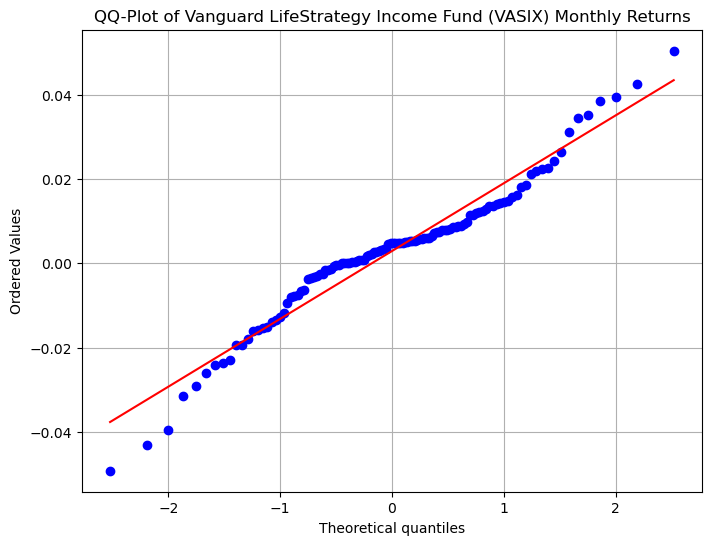

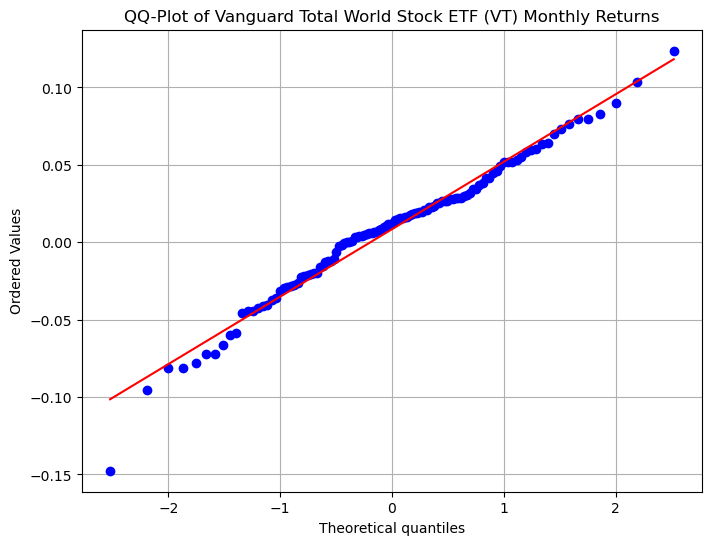

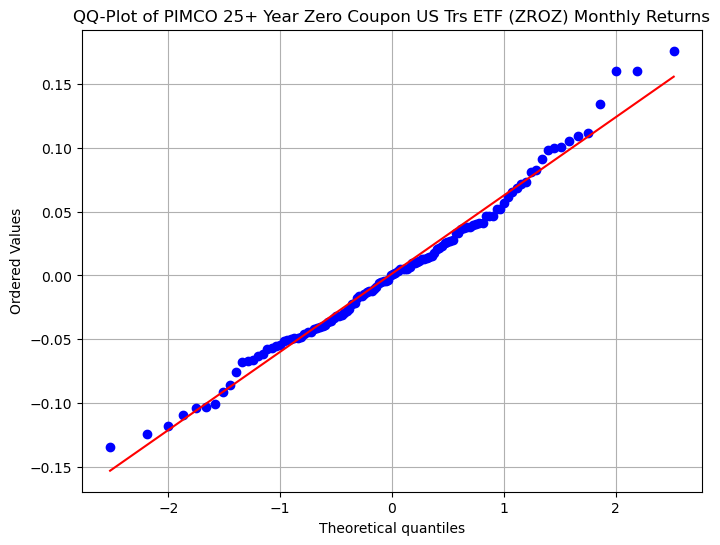

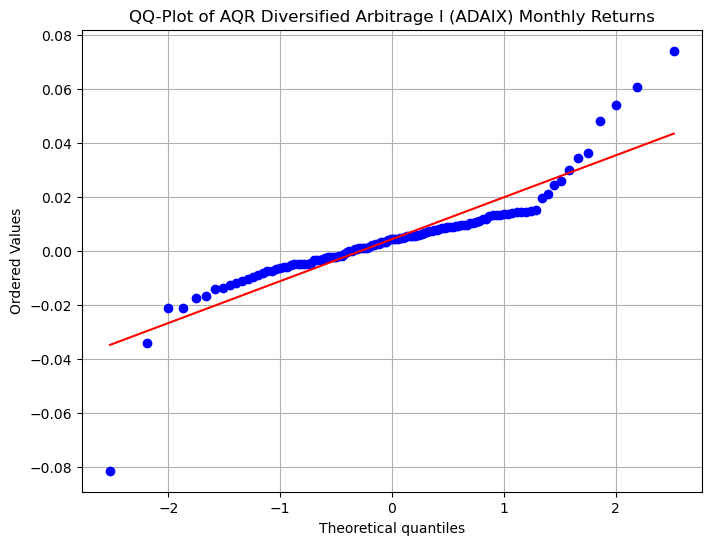

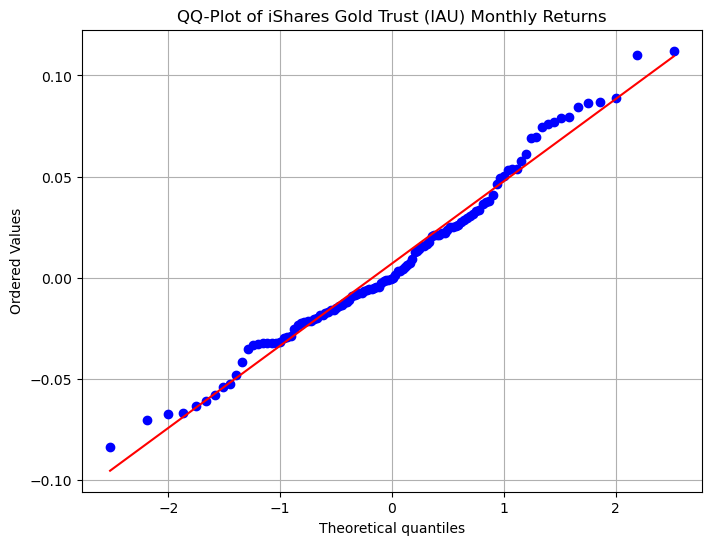

...

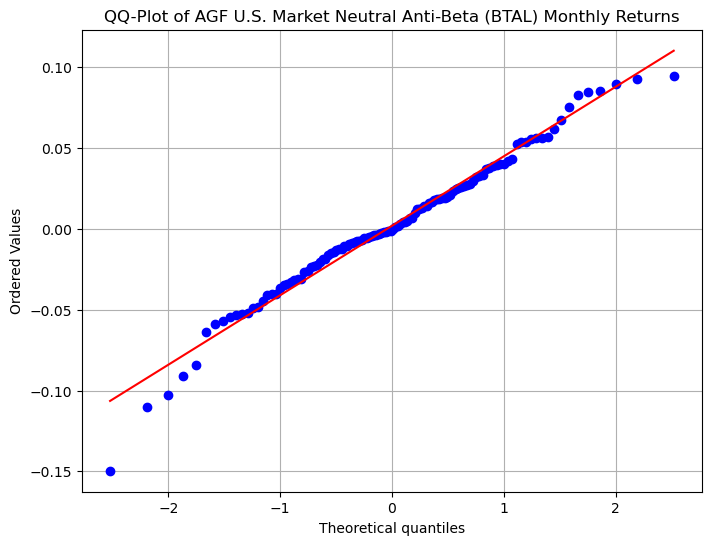

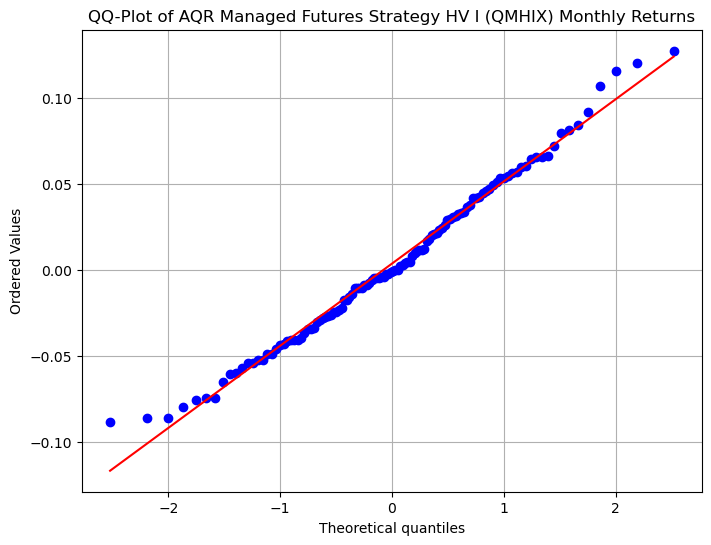

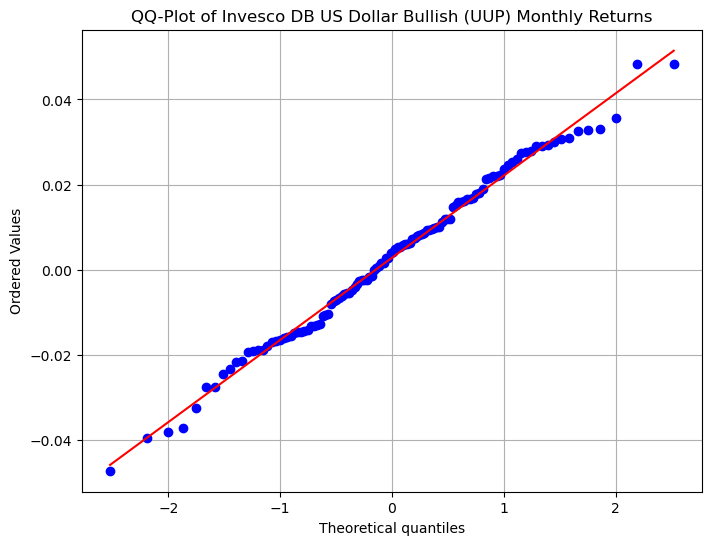

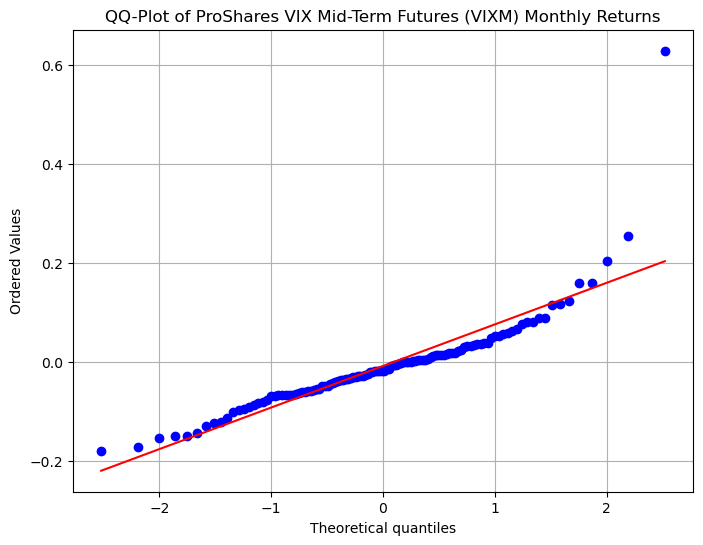

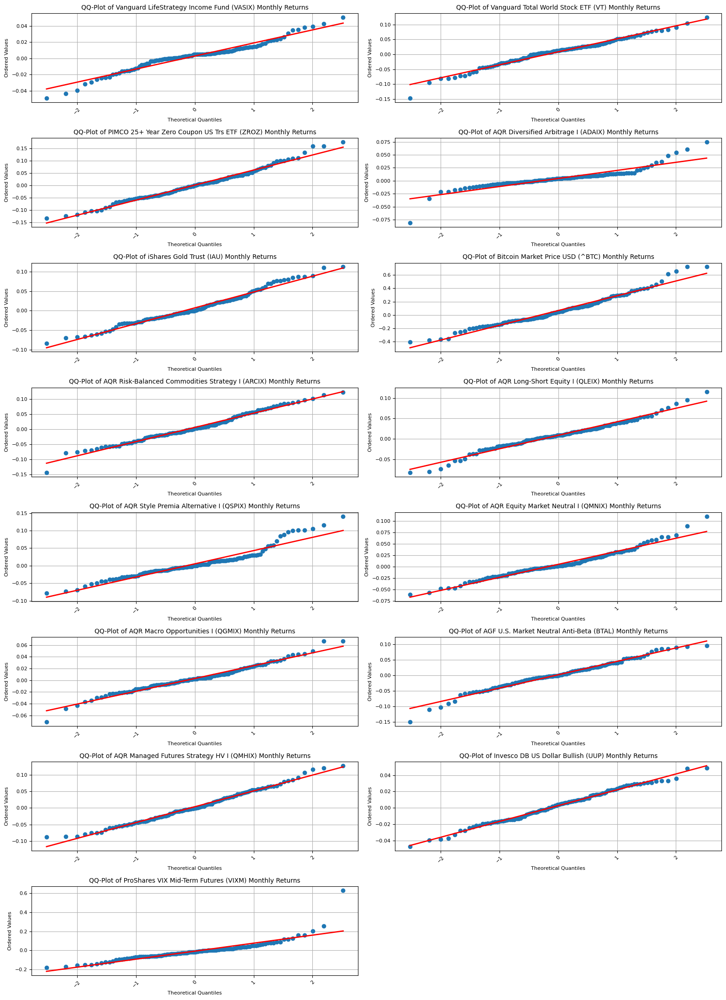

In [224]:
import os
import matplotlib.pyplot as plt
import scipy.stats as stats

# Comment-based snippet name for the folder
snippet_name = "QQ_PLOTS"

# Create the directory to save plots
output_folder = snippet_name
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Create a list to hold individual QQ plot data
figures_data = []

# Iterate over all assets excluding the 'Date' column
for asset in data.columns:
    if asset != 'Date':  # Skip the 'Date' column
        # Generate QQ plot data
        (osm, osr), (slope, intercept, r) = stats.probplot(data[asset], dist="norm")
        figures_data.append((osm, osr, slope, intercept, r, asset))

        # Plot the QQ-Plot
        fig, ax = plt.subplots(figsize=(8, 6))
        stats.probplot(data[asset], dist="norm", plot=ax)
        ax.set_title(f"QQ-Plot of {asset} Monthly Returns")
        ax.grid(True)

        # Save the figure as a PNG file inside the created folder
        fig.savefig(os.path.join(output_folder, f"{asset}_qq_plot.png"), bbox_inches='tight', dpi=300)  # Save with high resolution

        # Show the plot
        plt.show()

        # Close the figure to save memory
        plt.close(fig)

# Create a new figure to combine all QQ plots into a single image
combined_fig, combined_axes = plt.subplots(len(figures_data) // 2 + len(figures_data) % 2, 2, figsize=(16, 22))  # Increase figure size for better readability
combined_axes = combined_axes.flatten()

# Add each individual QQ plot to the combined figure without distortion
for i, (osm, osr, slope, intercept, r, asset) in enumerate(figures_data):
    ax = combined_axes[i]
    ax.plot(osm, osr, 'o')
    ax.plot(osm, slope * osm + intercept, 'r-', lw=2)
    ax.set_title(f"QQ-Plot of {asset} Monthly Returns", fontsize=10)
    ax.set_xlabel("Theoretical Quantiles", fontsize=8)
    ax.set_ylabel("Ordered Values", fontsize=8)
    ax.tick_params(axis='x', rotation=45, labelsize=8)
    ax.tick_params(axis='y', labelsize=8)
    ax.grid(True)

# Hide any unused subplots
for j in range(len(figures_data), len(combined_axes)):
    combined_fig.delaxes(combined_axes[j])

# Adjust layout to prevent overlap
combined_fig.tight_layout()

# Save the combined figure as a PNG file
combined_fig.savefig(os.path.join(output_folder, "combined_qq_plots.png"), bbox_inches='tight', dpi=300)  # Save with high resolution

# Display the combined plot in Jupyter Notebook
plt.show()

In [225]:
import os
import numpy as np
import pandas as pd
import dataframe_image as dfi  # For exporting DataFrames as images
from scipy.stats import t, cauchy, norm, kstest

# Comment-based snippet name for the folder
snippet_name = "AIC_BIC_KS_TABLE"

# Create the directory to save the table
output_folder = os.path.join(os.getcwd(), snippet_name)
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Function to compute AIC and BIC
def calculate_aic_bic(log_likelihood, num_params, num_data_points):
    aic = 2 * num_params - 2 * log_likelihood
    bic = np.log(num_data_points) * num_params - 2 * log_likelihood
    return aic, bic

# Initialize results list
results_list = []

# Iterate over each asset (excluding 'Date')
for asset in data.columns:
    if asset != 'Date':  # Skip 'Date'
        returns = data[asset]
        n = len(returns)

        # Fit T-Distribution
        df_t, loc_t, scale_t = t.fit(returns)
        ll_t = np.sum(np.log(t.pdf(returns, df_t, loc_t, scale_t)))
        aic_t, bic_t = calculate_aic_bic(ll_t, 3, n)
        ks_t = kstest(returns, 't', args=(df_t, loc_t, scale_t))

        # Fit Cauchy Distribution
        loc_cauchy, scale_cauchy = cauchy.fit(returns)
        ll_cauchy = np.sum(np.log(cauchy.pdf(returns, loc_cauchy, scale_cauchy)))
        aic_cauchy, bic_cauchy = calculate_aic_bic(ll_cauchy, 2, n)
        ks_cauchy = kstest(returns, 'cauchy', args=(loc_cauchy, scale_cauchy))

        # Fit Normal Distribution
        mu_normal, std_normal = norm.fit(returns)
        ll_normal = np.sum(np.log(norm.pdf(returns, mu_normal, std_normal)))
        aic_normal, bic_normal = calculate_aic_bic(ll_normal, 2, n)
        ks_normal = kstest(returns, 'norm', args=(mu_normal, std_normal))

        # Collect results for this asset
        results_list.append({
            'Asset': asset,
            'AIC_T': aic_t,
            'AIC_Cauchy': aic_cauchy,
            'AIC_Normal': aic_normal,
            'BIC_T': bic_t,
            'BIC_Cauchy': bic_cauchy,
            'BIC_Normal': bic_normal,
            'K-S_T': ks_t.statistic,
            'K-S_Cauchy': ks_cauchy.statistic,
            'K-S_Normal': ks_normal.statistic
        })

# Convert results to DataFrame
results_df = pd.DataFrame(results_list)

# Ensure the AIC columns are in the correct format
results_df[['AIC_T', 'AIC_Cauchy', 'AIC_Normal']] = results_df[['AIC_T', 'AIC_Cauchy', 'AIC_Normal']].astype(float)

# Limit the display to 3 decimal places
pd.options.display.float_format = '{:.3f}'.format

# Function to highlight the best fit based on AIC, BIC, and K-S separately
def highlight_best_fit(row):
    aic_cols = ['AIC_T', 'AIC_Cauchy', 'AIC_Normal']
    bic_cols = ['BIC_T', 'BIC_Cauchy', 'BIC_Normal']
    ks_cols = ['K-S_T', 'K-S_Cauchy', 'K-S_Normal']

    min_aic = row[aic_cols].min()
    min_bic = row[bic_cols].min()
    min_ks = row[ks_cols].min()

    def highlight(val, col_type):
        if col_type == 'AIC' and val == min_aic:
            return 'background-color: lightgreen; font-weight: bold'
        elif col_type == 'BIC' and val == min_bic:
            return 'background-color: lightblue; font-weight: bold'
        elif col_type == 'K-S' and val == min_ks:
            return 'background-color: lightyellow; font-weight: bold'
        else:
            return ''

    return [
        highlight(val, 'AIC') if col in aic_cols else
        highlight(val, 'BIC') if col in bic_cols else
        highlight(val, 'K-S') if col in ks_cols else ''
        for col, val in row.items()
    ]

# Apply formatting to highlight the best fit for each metric group
formatted_results = results_df.style.apply(highlight_best_fit, axis=1).format(precision=3)

# Save the formatted table as a PNG file inside the created folder
dfi.export(formatted_results, os.path.join(output_folder, "aic_bic_ks_table.png"))

# Optionally, display the formatted table in Jupyter
formatted_results

,Asset,AIC_T,AIC_Cauchy,AIC_Normal,BIC_T,BIC_Cauchy,BIC_Normal,K-S_T,K-S_Cauchy,K-S_Normal
0,Vanguard LifeStrategy Income Fund (VASIX),-647.000,-639.908,-634.216,-638.688,-634.366,-628.675,0.058,0.054,0.122
1,Vanguard Total World Stock ETF (VT),-403.166,-379.327,-402.084,-394.854,-373.786,-396.542,0.066,0.072,0.089
2,PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ),-321.459,-288.056,-322.976,-313.147,-282.515,-317.435,0.039,0.083,0.052
3,AQR Diversified Arbitrage I (ADAIX),-679.596,-667.710,-624.802,-671.284,-662.168,-619.261,0.047,0.070,0.169
4,iShares Gold Trust (IAU),-417.207,-382.092,-419.207,-408.895,-376.550,-413.665,0.078,0.094,0.078
5,Bitcoin Market Price USD (^BTC),-17.637,15.443,-18.210,-9.325,20.985,-12.669,0.071,0.097,0.076
6,AQR Risk-Balanced Commodities Strategy I (ARCIX),-382.235,-345.458,-384.209,-373.923,-339.916,-378.668,0.066,0.097,0.067
7,AQR Long-Short Equity I (QLEIX),-471.236,-448.901,-466.863,-462.924,-443.360,-461.322,0.034,0.059,0.064
8,AQR Style Premia Alternative I (QSPIX),-444.950,-432.415,-429.054,-436.638,-426.874,-423.513,0.055,0.084,0.134
9,AQR Equity Market Neutral I (QMNIX),-503.627,-483.176,-499.914,-495.315,-477.635,-494.372,0.063,0.077,0.101


In [226]:
# NON-PARAMETRIC BOOTSTRAP OF ANNUALIZED MEANS AND STANDARD DEVIATIONS

import os
import numpy as np
import pandas as pd
import dataframe_image as dfi  # For exporting DataFrames as images

# Comment-based snippet name for the folder
snippet_name = "BOOTSTRAP_RESULTS_TABLE"

# Create the directory to save the table
output_folder = snippet_name
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Exclude the 'Date' column from the data
asset_columns = data.columns.drop('Date')

# Determine the number of periods per year based on data frequency
periods_per_year = 12  # Adjust this value according to your data frequency

# Initialize dictionary to store results
bootstrap_results_dict = {}

# Set the number of bootstrap iterations
n_iterations = 10000  # You can adjust this as needed
np.random.seed(42)  # Set seed for reproducibility

# Loop through each asset in the dataset (excluding the 'Date' column)
for asset in asset_columns:
    # Get the asset returns
    asset_returns = data[asset].dropna()
    n_size = len(asset_returns)

    # Arrays to hold bootstrap estimates
    bootstrap_means = np.zeros(n_iterations)
    bootstrap_vars = np.zeros(n_iterations)

    # Perform bootstrap resampling
    for i in range(n_iterations):
        # Generate a bootstrap sample with replacement
        bootstrap_sample = np.random.choice(asset_returns, size=n_size, replace=True)

        # Calculate mean and variance for the bootstrap sample
        bootstrap_means[i] = np.mean(bootstrap_sample)
        bootstrap_vars[i] = np.var(bootstrap_sample, ddof=1)

    # Annualize the bootstrap means and variances
    annualized_bootstrap_means = bootstrap_means * periods_per_year
    annualized_bootstrap_vars = bootstrap_vars * periods_per_year

    # Convert variances to standard deviations
    annualized_bootstrap_std_devs = np.sqrt(annualized_bootstrap_vars)

    # Calculate 95% confidence intervals for the annualized mean returns
    mean_ci_lower, mean_ci_upper = np.percentile(annualized_bootstrap_means, [2.5, 97.5])

    # Calculate 95% confidence intervals for the annualized standard deviations
    std_ci_lower, std_ci_upper = np.percentile(annualized_bootstrap_std_devs, [2.5, 97.5])

    # Store the results in a dictionary and multiply by 100 to convert to percentages
    bootstrap_results_dict[asset] = {
        "Annualized Mean Estimate": np.mean(annualized_bootstrap_means) * 100,
        "Mean 95% CI Lower": mean_ci_lower * 100,
        "Mean 95% CI Upper": mean_ci_upper * 100,
        "Annualized Std Dev Estimate": np.mean(annualized_bootstrap_std_devs) * 100,
        "Std Dev 95% CI Lower": std_ci_lower * 100,
        "Std Dev 95% CI Upper": std_ci_upper * 100
    }

# Convert the results to a DataFrame for better readability
bootstrap_results_df = pd.DataFrame(bootstrap_results_dict).T
bootstrap_results_df.columns = ["Annualized Mean Estimate", "Mean 95% CI Lower", "Mean 95% CI Upper",
                                "Annualized Std Dev Estimate", "Std Dev 95% CI Lower", "Std Dev 95% CI Upper"]

# Display the results in a nicely formatted table with percentage formatting (two decimal places)
bootstrap_results_styled = bootstrap_results_df.style.format({
    "Annualized Mean Estimate": "{:.2f}",
    "Mean 95% CI Lower": "{:.2f}",
    "Mean 95% CI Upper": "{:.2f}",
    "Annualized Std Dev Estimate": "{:.2f}",
    "Std Dev 95% CI Lower": "{:.2f}",
    "Std Dev 95% CI Upper": "{:.2f}"
}).set_caption("Bootstrap Results for Annualized Asset Returns (Means and Standard Deviations in Percentages)")

# Center align all data cells
bootstrap_results_styled = bootstrap_results_styled.set_properties(
    **{'text-align': 'center'},
    subset=pd.IndexSlice[:, :]
)

# Apply styles to the table
bootstrap_results_styled = bootstrap_results_styled.set_table_styles(
    [
        # Style the header
        {'selector': 'th', 'props': [('text-align', 'center'), ('font-weight', 'bold')]},
        # Style the index (asset names) to be right-aligned and prevent wrapping
        {'selector': 'th.row_heading', 'props': [
            ('text-align', 'right'),
            ('white-space', 'nowrap'),
            ('font-weight', 'bold')
        ]}
    ]
)

# Save the formatted table as a PNG file inside the created folder
dfi.export(bootstrap_results_styled, os.path.join(output_folder, "bootstrap_results_table.png"))

# Optionally, display the formatted table in Jupyter
bootstrap_results_styled


,Annualized Mean Estimate,Mean 95% CI Lower,Mean 95% CI Upper,Annualized Std Dev Estimate,Std Dev 95% CI Lower,Std Dev 95% CI Upper
Vanguard LifeStrategy Income Fund (VASIX),3.48,0.02,6.91,5.59,4.63,6.53
Vanguard Total World Stock ETF (VT),9.98,0.28,19.36,14.96,12.70,17.35
PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ),1.64,-11.23,14.83,20.94,18.08,23.79
AQR Diversified Arbitrage I (ADAIX),5.27,1.62,8.96,5.76,4.15,7.47
iShares Gold Trust (IAU),8.50,-0.29,17.27,13.93,12.19,15.62
Bitcoin Market Price USD (^BTC),79.80,32.14,127.10,76.04,65.13,87.04
AQR Risk-Balanced Commodities Strategy I (ARCIX),6.56,-3.35,16.75,16.15,14.11,18.24
AQR Long-Short Equity I (QLEIX),10.71,3.57,17.88,11.37,9.53,13.21
AQR Style Premia Alternative I (QSPIX),6.49,-1.77,15.08,13.31,10.96,15.61
AQR Equity Market Neutral I (QMNIX),6.39,0.37,12.60,9.87,8.26,11.49


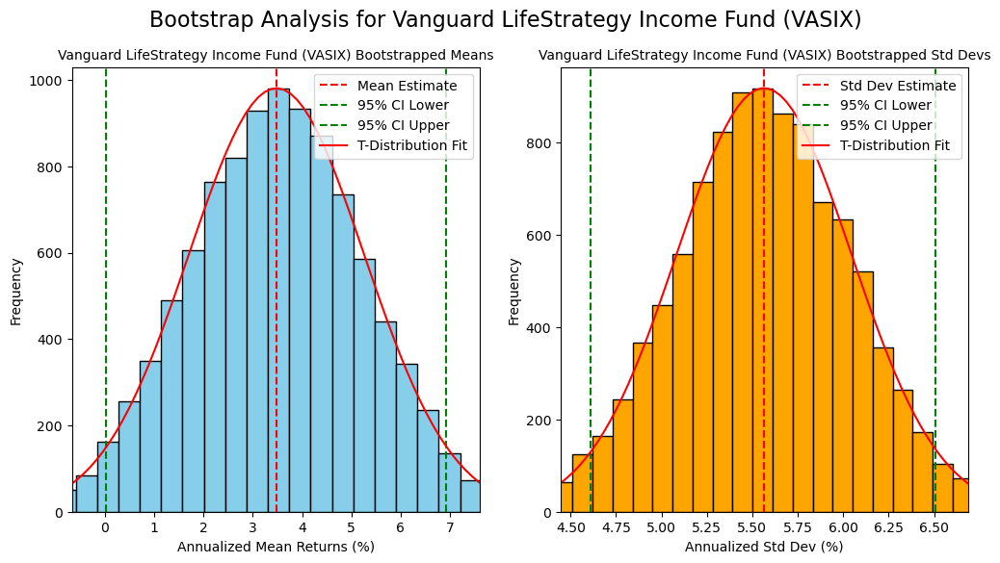

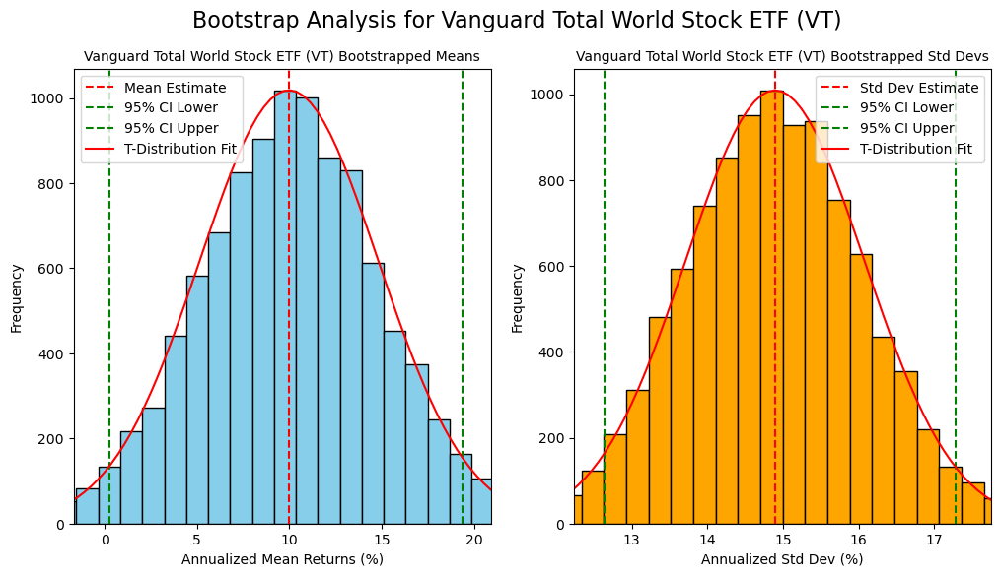

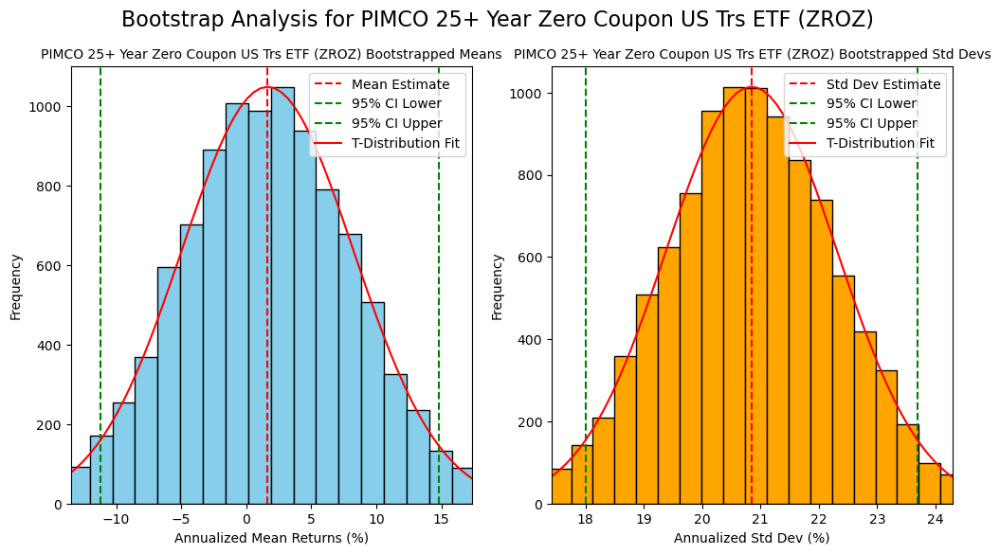

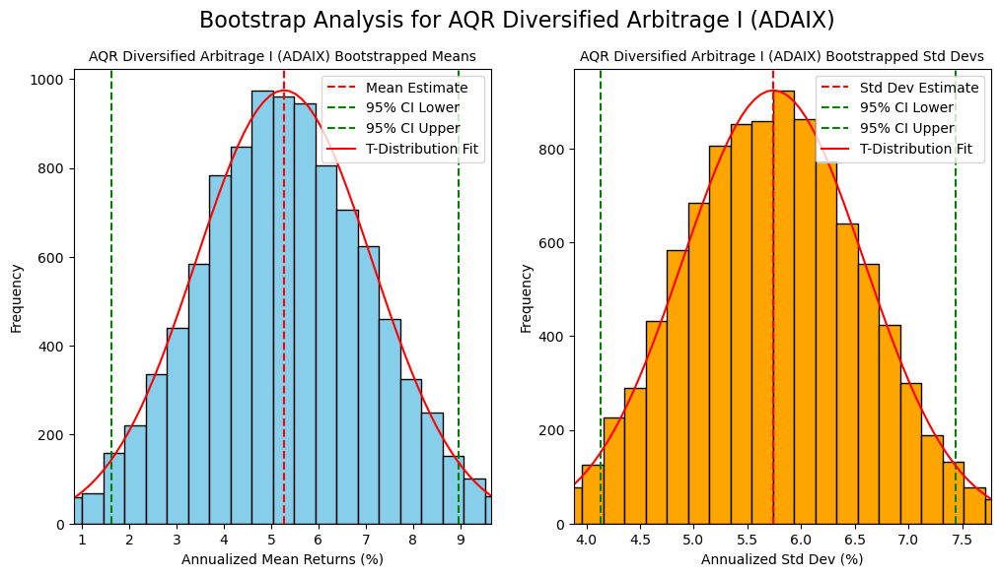

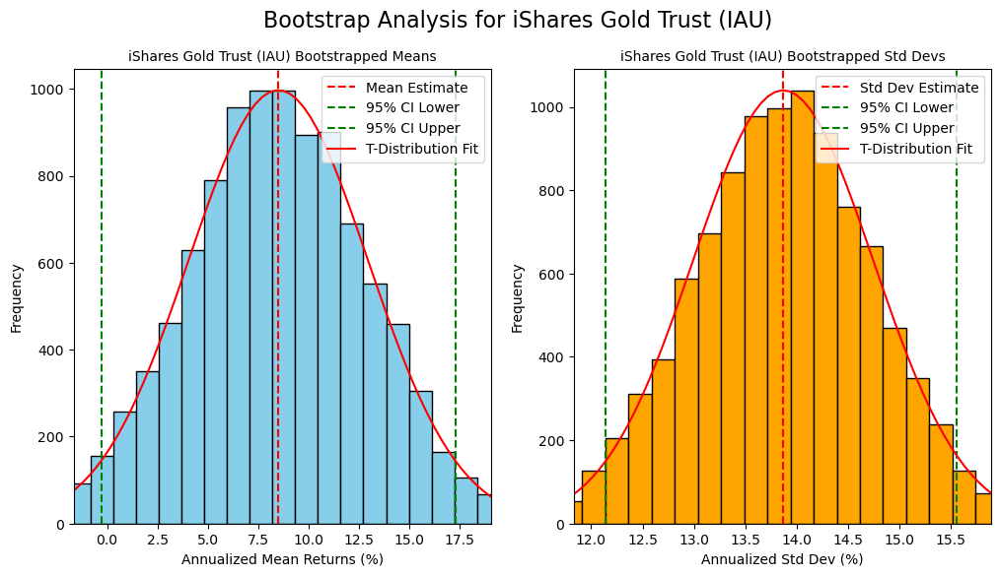

...

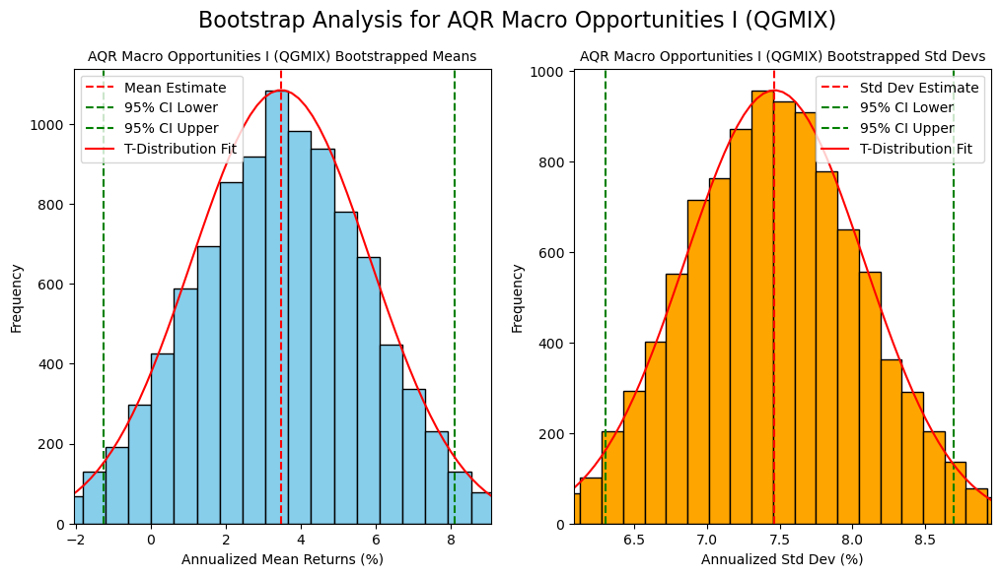

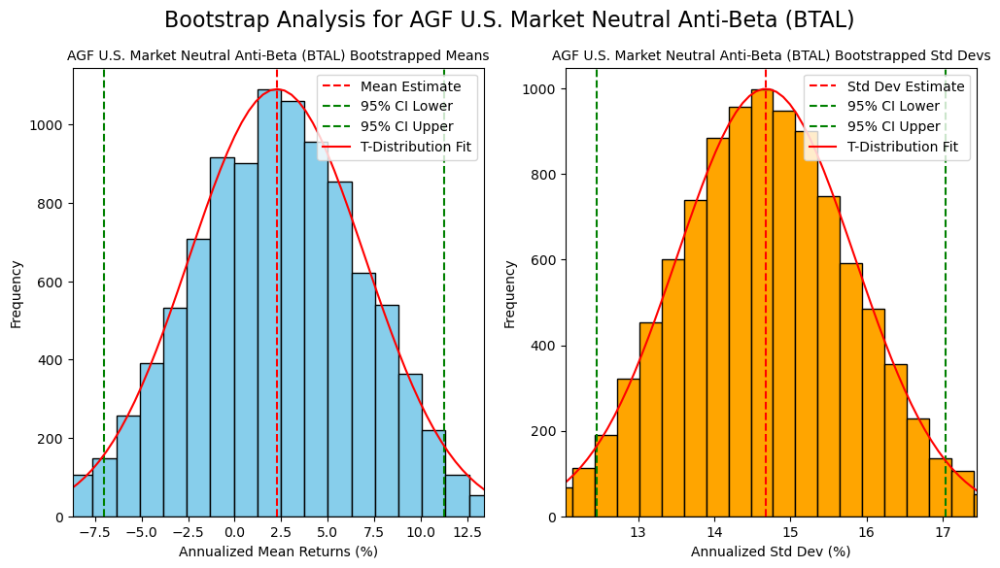

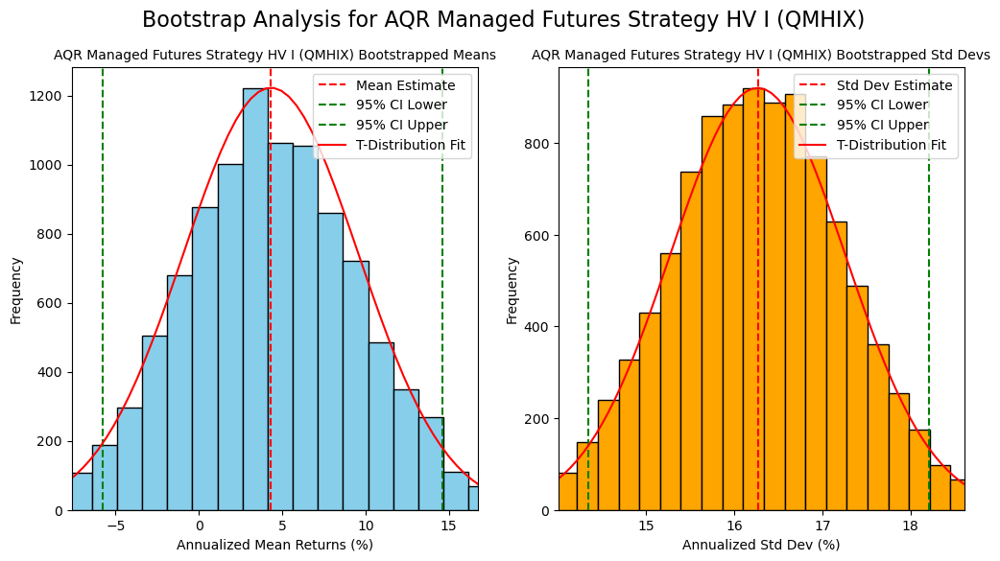

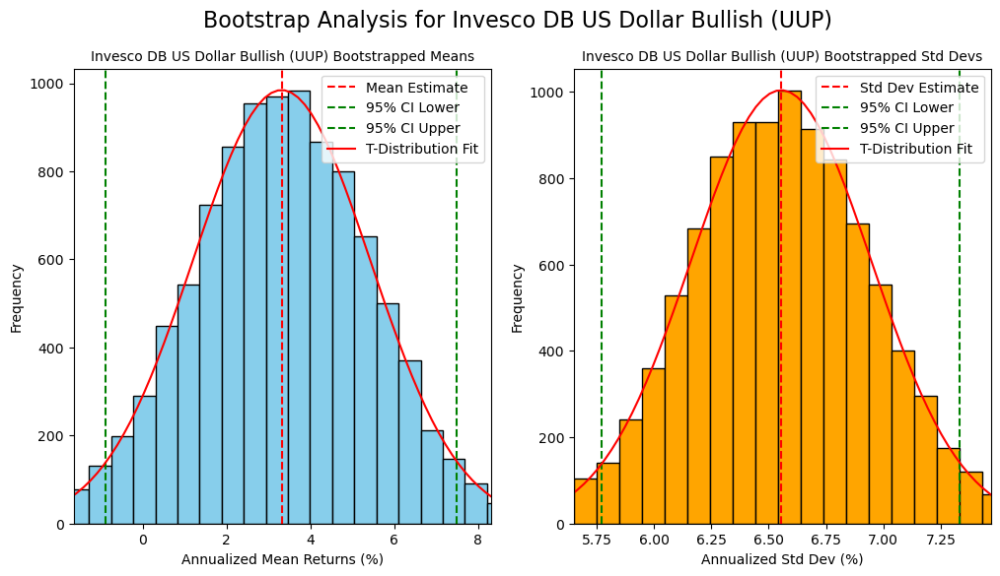

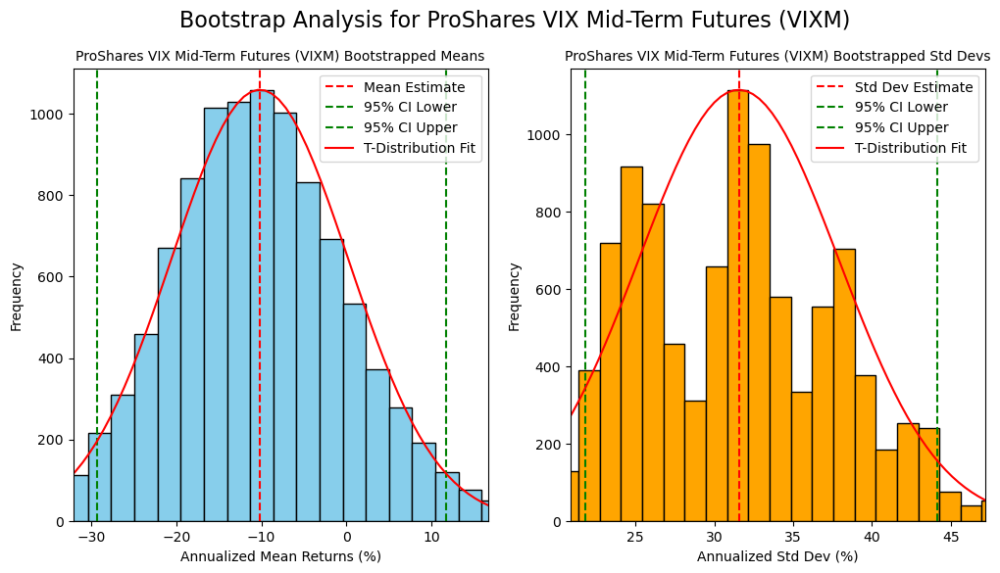

In [227]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy.stats import t
from PIL import Image

# Comment-based snippet name for the folder
snippet_name = "NON_PARAMETRIC_BOOTSTRAP_PLOTS"

# Create the directory to save the plots
output_folder = snippet_name
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Exclude the 'Date' column from the data
asset_columns = data.columns.drop('Date')

# Number of bootstrap iterations and seed for reproducibility
n_iterations = 10000
np.random.seed(42)  # Set seed for reproducibility

# Determine the number of periods per year (e.g., monthly data)
periods_per_year = 12  # Adjust according to your data frequency

# Create a list to hold individual figures data
figures_paths = []

# Loop through each asset in the dataset (excluding the 'Date' column)
for asset in asset_columns:
    asset_returns = data[asset].dropna()
    n_size = len(asset_returns)

    # Arrays to hold bootstrap estimates
    bootstrap_means = np.zeros(n_iterations)
    bootstrap_vars = np.zeros(n_iterations)

    # Perform bootstrap resampling
    for i in range(n_iterations):
        bootstrap_sample = np.random.choice(asset_returns, size=n_size, replace=True)
        bootstrap_means[i] = np.mean(bootstrap_sample)
        bootstrap_vars[i] = np.var(bootstrap_sample)

    # Annualize the bootstrap means and standard deviations
    annualized_bootstrap_means = bootstrap_means * periods_per_year * 100  # Annualize means and convert to percentage
    annualized_bootstrap_std_devs = np.sqrt(bootstrap_vars) * np.sqrt(periods_per_year) * 100  # Annualize std dev and convert to percentage

    # Fit a t-distribution to the annualized means and std devs
    df_means, loc_means, scale_means = t.fit(annualized_bootstrap_means)
    df_stddev, loc_stddev, scale_stddev = t.fit(annualized_bootstrap_std_devs)

    # Calculate 95% confidence intervals for the annualized mean returns and standard deviations
    mean_ci_lower, mean_ci_upper = np.percentile(annualized_bootstrap_means, [2.5, 97.5])
    std_ci_lower, std_ci_upper = np.percentile(annualized_bootstrap_std_devs, [2.5, 97.5])

    # Create a figure for each asset's plots
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
    fig.suptitle(f"Bootstrap Analysis for {asset}", fontsize=16)

    # Plot bootstrapped means (left subplot)
    ax_means = axes[0]
    count, bins, _ = ax_means.hist(annualized_bootstrap_means, bins=30, color='skyblue', edgecolor='black')  # Get histogram counts
    ax_means.axvline(np.mean(annualized_bootstrap_means), color='red', linestyle='--', label="Mean Estimate")
    ax_means.axvline(mean_ci_lower, color='green', linestyle='--', label="95% CI Lower")
    ax_means.axvline(mean_ci_upper, color='green', linestyle='--', label="95% CI Upper")

    # Overlay t-distribution fit
    x_vals_means = np.linspace(min(annualized_bootstrap_means), max(annualized_bootstrap_means), 100)
    pdf_fitted_means = t.pdf(x_vals_means, df_means, loc_means, scale_means)
    scale_factor_means = max(count) / max(pdf_fitted_means)  # Scale the t-distribution to match histogram
    ax_means.plot(x_vals_means, pdf_fitted_means * scale_factor_means, 'r-', label="T-Distribution Fit")
    
    ax_means.set_title(f"{asset} Bootstrapped Means", fontsize=10)
    ax_means.set_xlabel("Annualized Mean Returns (%)")
    ax_means.set_ylabel("Frequency")
    ax_means.legend()

    # Dynamically adjust x-axis for the mean returns
    mean_x_min, mean_x_max = np.percentile(annualized_bootstrap_means, [1, 99])
    ax_means.set_xlim(left=mean_x_min, right=mean_x_max)

    # Plot bootstrapped standard deviations (right subplot)
    ax_vars = axes[1]
    count_std, bins_std, _ = ax_vars.hist(annualized_bootstrap_std_devs, bins=30, color='orange', edgecolor='black')  # Get histogram counts
    ax_vars.axvline(np.mean(annualized_bootstrap_std_devs), color='red', linestyle='--', label="Std Dev Estimate")
    ax_vars.axvline(std_ci_lower, color='green', linestyle='--', label="95% CI Lower")
    ax_vars.axvline(std_ci_upper, color='green', linestyle='--', label="95% CI Upper")

    # Overlay t-distribution fit
    x_vals_stddev = np.linspace(min(annualized_bootstrap_std_devs), max(annualized_bootstrap_std_devs), 100)
    pdf_fitted_stddev = t.pdf(x_vals_stddev, df_stddev, loc_stddev, scale_stddev)
    scale_factor_stddev = max(count_std) / max(pdf_fitted_stddev)  # Scale the t-distribution to match histogram
    ax_vars.plot(x_vals_stddev, pdf_fitted_stddev * scale_factor_stddev, 'r-', label="T-Distribution Fit")
    
    ax_vars.set_title(f"{asset} Bootstrapped Std Devs", fontsize=10)
    ax_vars.set_xlabel("Annualized Std Dev (%)")
    ax_vars.set_ylabel("Frequency")
    ax_vars.legend()

    # Dynamically adjust x-axis for the standard deviations
    std_x_min, std_x_max = np.percentile(annualized_bootstrap_std_devs, [1, 99])
    ax_vars.set_xlim(left=std_x_min, right=std_x_max)

    # Save the figure as a PNG file inside the created folder
    plot_path = os.path.join(output_folder, f"{asset}_bootstrap_plots.png")
    plt.savefig(plot_path, bbox_inches='tight', dpi=300)
    figures_paths.append(plot_path)

    # Display the plots
    plt.show()

# Combine all individual PNGs into a single image with a white background
images = [Image.open(path) for path in figures_paths]
width, height = images[0].size
combined_image = Image.new('RGB', (width * 2, height * ((len(images) + 1) // 2)), (255, 255, 255))

# Paste individual images into the combined image
for idx, image in enumerate(images):
    x_offset = (idx % 2) * width
    y_offset = (idx // 2) * height
    combined_image.paste(image, (x_offset, y_offset))

# Save the combined image
combined_image_path = os.path.join(output_folder, "combined_bootstrap_plots.png")
combined_image.save(combined_image_path, format='PNG')

# Display the combined image
combined_image.show()

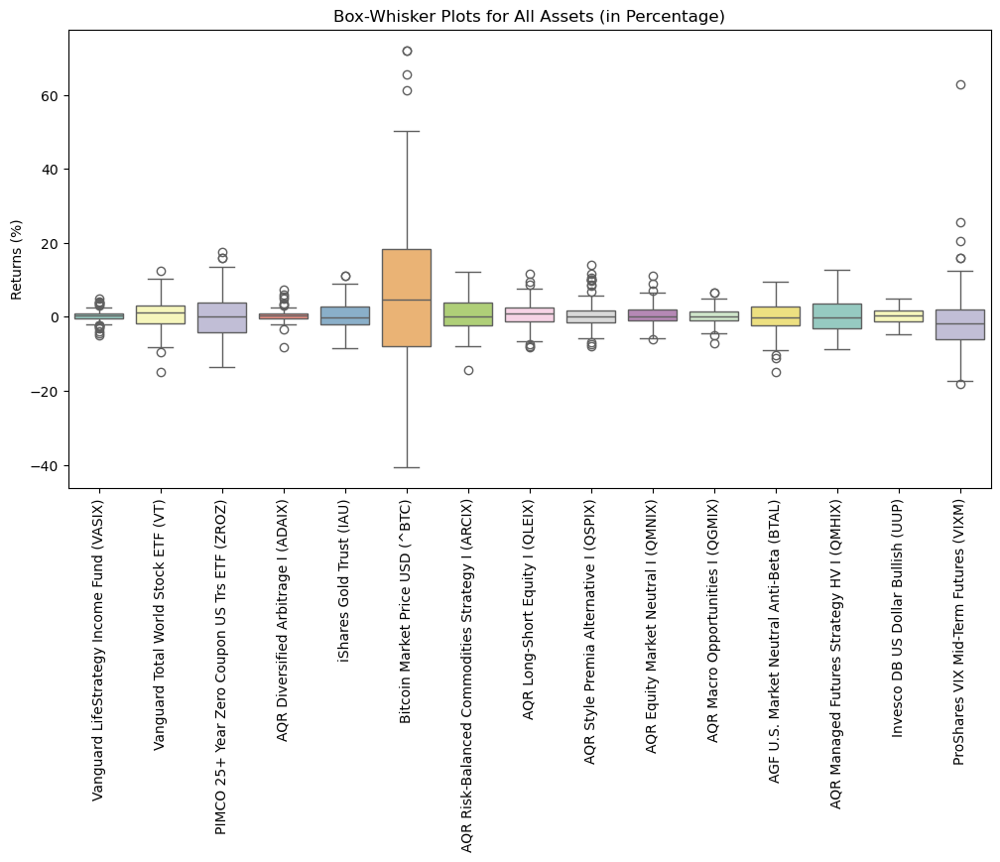

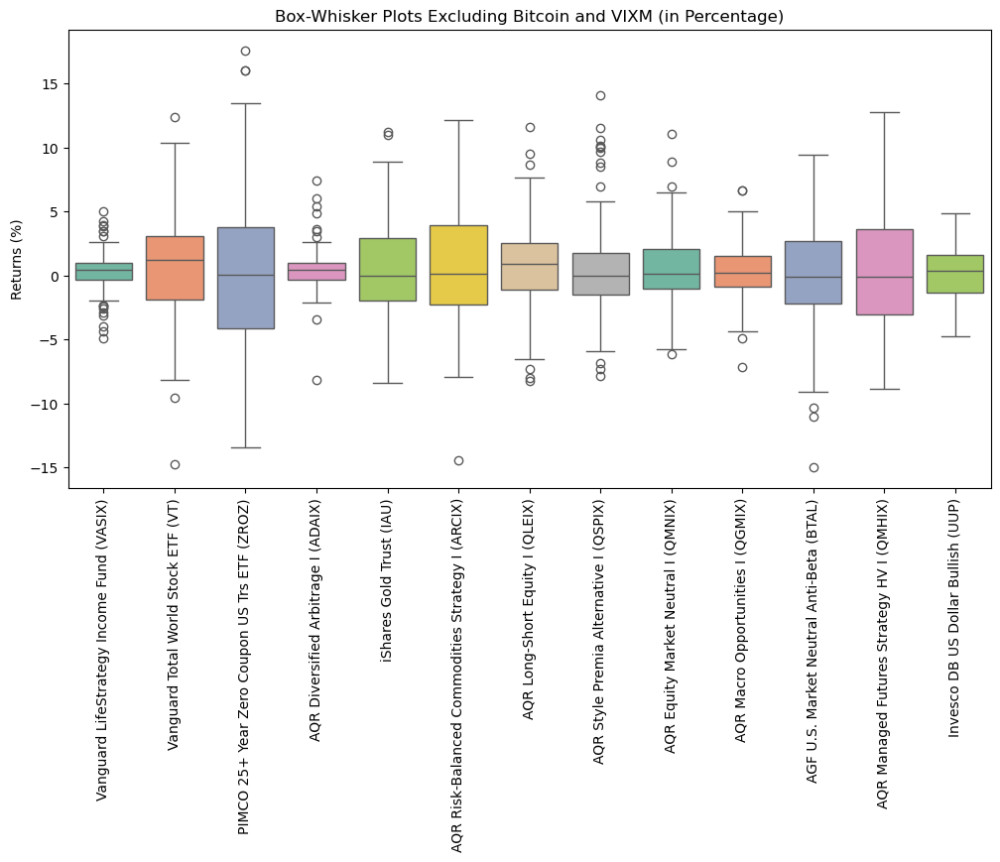

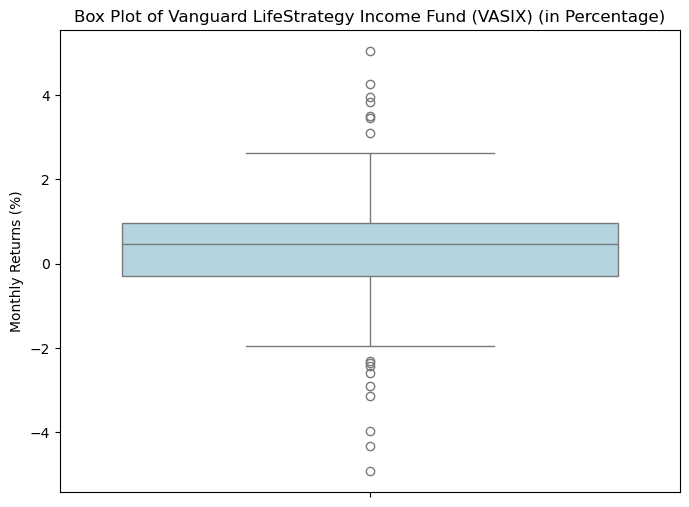

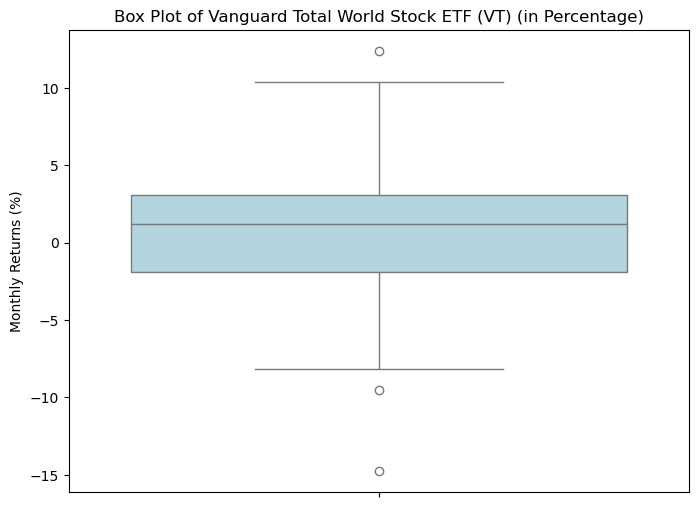

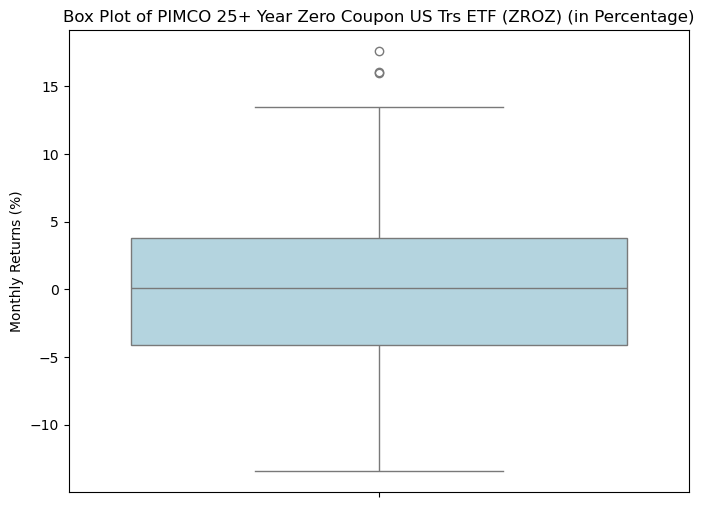

...

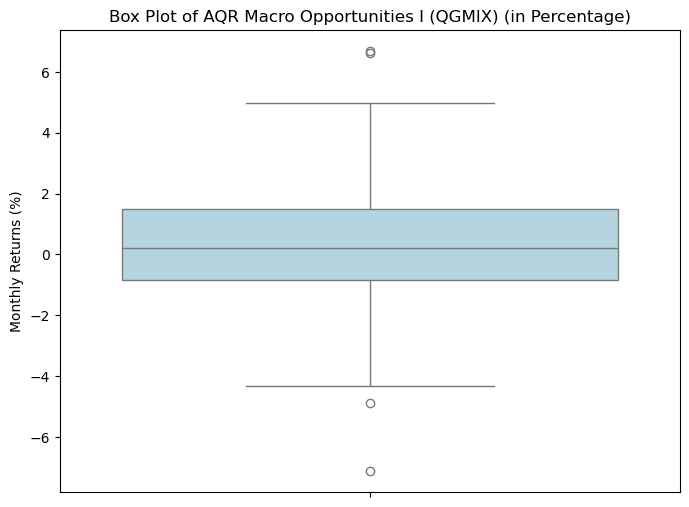

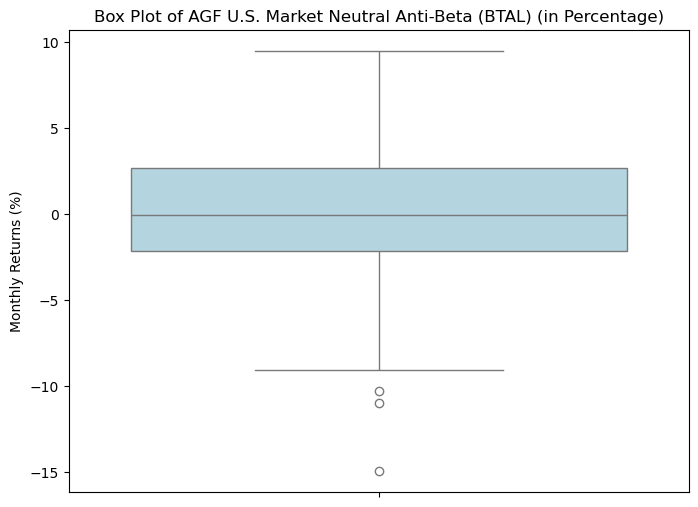

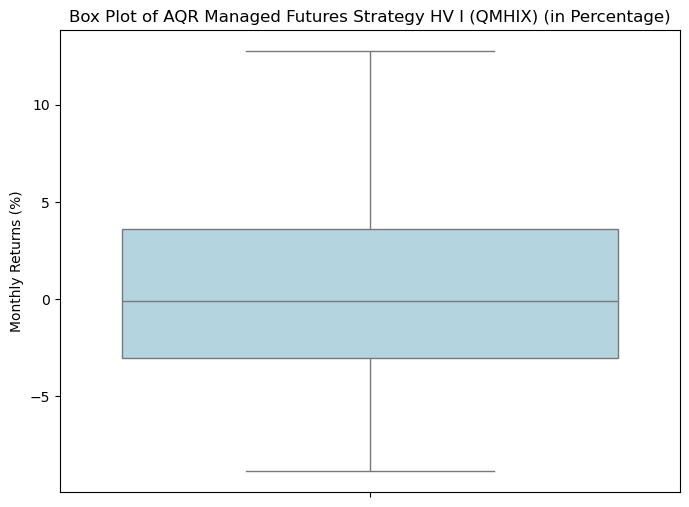

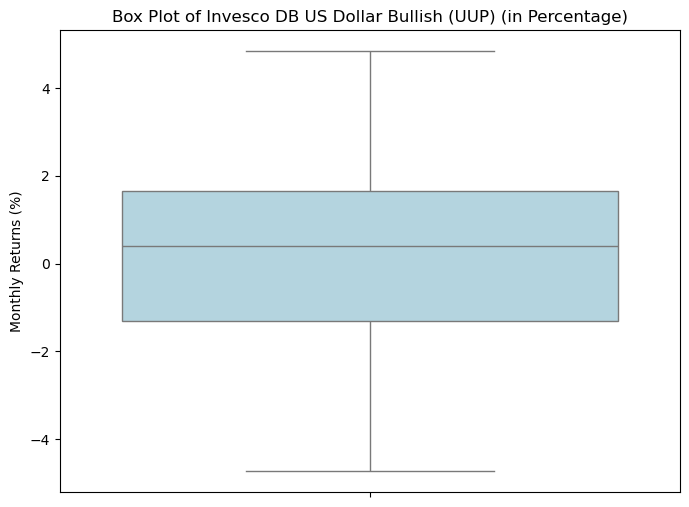

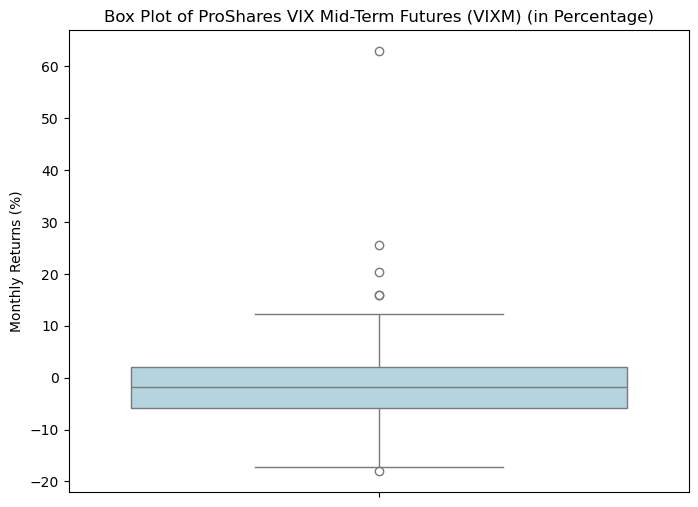

In [228]:
#BOX AND WHISKER PLOTS

import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Multiply the data by 100 to convert to percentage form (excluding 'Date' column)
data_percentage = data.drop(columns=['Date']) * 100

# Folder to store the plots
output_folder = "BOX_WHISKER_PLOTS"
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Step 1: Generate box-whisker plots for all assets (percentages)
plt.figure(figsize=(12, 6))
sns.boxplot(data=data_percentage, palette="Set3")
plt.title("Box-Whisker Plots for All Assets (in Percentage)")
plt.ylabel("Returns (%)")
plt.xticks(rotation=90)
plt.savefig(os.path.join(output_folder, "box_whisker_all_assets.png"), bbox_inches='tight', dpi=300)
plt.show()

# Step 2: Generate box-whisker plots excluding Bitcoin and VIXM
data_without_bitcoin_vixm = data_percentage.drop(columns=["Bitcoin Market Price USD (^BTC)", "ProShares VIX Mid-Term Futures (VIXM)"])
plt.figure(figsize=(12, 6))
sns.boxplot(data=data_without_bitcoin_vixm, palette="Set2")
plt.title("Box-Whisker Plots Excluding Bitcoin and VIXM (in Percentage)")
plt.ylabel("Returns (%)")
plt.xticks(rotation=90)
plt.savefig(os.path.join(output_folder, "box_whisker_excluding_bitcoin_vixm.png"), bbox_inches='tight', dpi=300)
plt.show()

# Step 3: Generate individual box-whisker plots for each asset (percentages)
for asset in data_percentage.columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(data=data_percentage[asset], color='lightblue')
    plt.title(f"Box Plot of {asset} (in Percentage)")
    #plt.xlabel("Monthly Returns (%)")
    plt.ylabel("Monthly Returns (%)")
    plt.savefig(os.path.join(output_folder, f"{asset}_box_whisker.png"), bbox_inches='tight', dpi=300)
    
    # Display the plot in Jupyter notebook
    plt.show()


In [10]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from PIL import Image
from IPython.display import display

# Load the dataset
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Check if 'Date' is already the index or if the column exists with a different name
if 'Date' in data.columns:
    data = data.set_index('Date')  # Set 'Date' as the index if it isn't already

# Create a folder based on the first comment
output_folder = "ROLLING_36_MONTH_MEAN_STD_RISKADJ_V2"
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Function to plot rolling metrics for a single asset
def plot_rolling_metrics(asset_returns, asset_name, window_size=36):
    # Calculate rolling statistics
    rolling_mean_annualized = asset_returns.rolling(window=window_size).mean() * 12 * 100  # Annualize and convert to percentage
    rolling_std_annualized = asset_returns.rolling(window=window_size).std() * (12 ** 0.5) * 100  # Annualize and convert to percentage
    rolling_riskadj_annualized = rolling_mean_annualized / rolling_std_annualized

    # Drop NaN values dynamically (where rolling data starts)
    rolling_mean_annualized = rolling_mean_annualized.dropna()
    rolling_std_annualized = rolling_std_annualized.dropna()
    rolling_riskadj_annualized = rolling_riskadj_annualized.dropna()

    # Create and save combined rolling metrics plot
    fig, ax1 = plt.subplots(figsize=(12, 6))

    ax1.plot(rolling_mean_annualized.index, rolling_mean_annualized, color='blue', label='Rolling Mean (%)')
    ax1.plot(rolling_std_annualized.index, rolling_std_annualized, color='green', label='Rolling Std (%)')
    ax1.set_ylabel("Mean / Std (%)")
    ax1.set_xlabel("Date")
    ax1.tick_params(axis='y')
    ax1.legend(loc='upper left')

    ax2 = ax1.twinx()  # Create a second y-axis for risk-adjusted return
    ax2.plot(rolling_riskadj_annualized.index, rolling_riskadj_annualized, color='red', linestyle='--', label='Risk-Adjusted Return')
    ax2.set_ylabel("Risk-Adjusted Return")
    ax2.tick_params(axis='y')
    ax2.legend(loc='upper right')

    plt.title(f"Rolling 36-Month Metrics for {asset_name}")
    plt.savefig(os.path.join(output_folder, f"{asset_name}_rolling_metrics.png"), bbox_inches='tight', dpi=300)
    plt.close()

# Loop through each asset and generate plots
for asset in data.columns:
    asset_returns = data[asset].dropna()  # Drop NaN values
    plot_rolling_metrics(asset_returns, asset)

# Combine individual rolling metrics plots into a single image
metrics_images = [Image.open(os.path.join(output_folder, f"{asset}_rolling_metrics.png")) for asset in data.columns]
width, height = metrics_images[0].size
combined_metrics_image = Image.new('RGB', (width * 2, height * ((len(metrics_images) + 1) // 2)), (255, 255, 255))

for idx, image in enumerate(metrics_images):
    x_offset = (idx % 2) * width
    y_offset = (idx // 2) * height
    combined_metrics_image.paste(image, (x_offset, y_offset))

combined_metrics_image_path = os.path.join(output_folder, "combined_rolling_metrics.png")
combined_metrics_image.save(combined_metrics_image_path, format='PNG')
display(combined_metrics_image)

In [235]:
import numpy as np
import pandas as pd
from scipy.stats import skew, kurtosis, t
import os

# Load the data
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Ensure the returns data has a DateTimeIndex
data['Date'] = pd.to_datetime(data['Date'])  # Convert 'Date' column to datetime
data.set_index('Date', inplace=True)  # Set 'Date' as the index

# Helper functions for calculation
def calculate_cagr(returns, periods_per_year):
    total_return = (1 + returns).prod()
    n_years = len(returns) / periods_per_year
    cagr = total_return ** (1 / n_years) - 1
    return cagr

def calculate_annualized_std(returns, periods_per_year):
    return returns.std() * np.sqrt(periods_per_year)

def calculate_annual_returns(returns, periods_per_year):
    annual_returns = (1 + returns).resample('YE').prod() - 1  # Use 'YE' for year end
    best_year = annual_returns.max()
    worst_year = annual_returns.min()
    return best_year, worst_year

def calculate_max_drawdown(returns):
    cumulative_returns = (1 + returns).cumprod()
    peak = cumulative_returns.cummax()
    drawdown = (cumulative_returns - peak) / peak
    max_drawdown = drawdown.min()
    return max_drawdown

def calculate_sharpe_ratio(returns, risk_free_rate, periods_per_year):
    excess_returns = returns - (risk_free_rate / periods_per_year)
    annualized_sharpe = (excess_returns.mean() / excess_returns.std()) * np.sqrt(periods_per_year)
    return annualized_sharpe

def calculate_sortino_ratio(returns, risk_free_rate, periods_per_year):
    excess_returns = returns - (risk_free_rate / periods_per_year)
    downside_returns = returns[returns < 0]
    downside_std = downside_returns.std() * np.sqrt(periods_per_year)
    sortino_ratio = (excess_returns.mean() / downside_std) * np.sqrt(periods_per_year)
    return sortino_ratio

# Assuming 12 periods per year (monthly data)
periods_per_year = 12
risk_free_rate = 0.02

# Create an empty list to store the results for each asset
results_list = []

for asset in data.columns:
    asset_returns = data[asset].dropna()  # Drop NaN values for each asset
    
    # Calculate metrics for the asset
    cagr = calculate_cagr(asset_returns, periods_per_year)
    annualized_std = calculate_annualized_std(asset_returns, periods_per_year)
    best_year, worst_year = calculate_annual_returns(asset_returns, periods_per_year)
    max_drawdown = calculate_max_drawdown(asset_returns)
    sharpe_ratio = calculate_sharpe_ratio(asset_returns, risk_free_rate, periods_per_year)
    sortino_ratio = calculate_sortino_ratio(asset_returns, risk_free_rate, periods_per_year)
    
    # Append the results to the list
    results_list.append({
        "Asset": asset,
        "CAGR": f"{100*cagr:.2f}",
        "Annualized Std Dev": f"{100*annualized_std:.2f}",
        "Best Year": f"{100*best_year:.2f}",
        "Worst Year": f"{100*worst_year:.2f}",
        "Max Drawdown": f"{100*max_drawdown:.2f}",
        "Sharpe Ratio": f"{sharpe_ratio:.2f}",
        "Sortino Ratio": f"{sortino_ratio:.2f}"
    })

# Convert the results to a DataFrame
results_df = pd.DataFrame(results_list)

# Modify the column headers with line breaks and ensure equal width columns (except Asset)
column_headers = {
    "CAGR": "CAGR\n(%)",
    "Annualized Std Dev": "Annualized\nStd Dev\n(%)",
    "Best Year": "Best Year\n(%)",
    "Worst Year": "Worst Year\n(%)",
    "Max Drawdown": "Max\nDrawdown\n(%)",
    "Sharpe Ratio": "Sharpe\nRatio",
    "Sortino Ratio": "Sortino\nRatio"
}
results_df.rename(columns=column_headers, inplace=True)

# Center-align and align decimals in numeric columns, no text wrapping in Asset column
styled_table = results_df.style.set_properties(
    subset=['CAGR\n(%)', 'Annualized\nStd Dev\n(%)', 'Best Year\n(%)', 'Worst Year\n(%)',
            'Max\nDrawdown\n(%)', 'Sharpe\nRatio', 'Sortino\nRatio'],
    **{'text-align': 'right', 'padding-right': '60px'}  # More padding for better centering
).set_table_styles([
    {'selector': 'th', 'props': [('text-align', 'center'), ('width', '100px')]},
    {'selector': 'th.col0', 'props': [('text-align', 'right'), ('white-space', 'nowrap'), ('width', '250px')]},  # Asset column no wrapping
    {'selector': 'td, th', 'props': [('border', '1px solid black')]},
]).format(precision=2).set_caption("Risk and Return Characteristics for All Assets")

# Apply formatting for negative values in red font using map instead of applymap
styled_table = styled_table.map(
    lambda x: 'color: red' if '-' in str(x) else 'color: black',
    subset=['Worst Year\n(%)', 'Max\nDrawdown\n(%)']
)

# Output folder setup
output_folder = 'RISK-RETURN_CHARACTERISTICS_TABLE'
os.makedirs(output_folder, exist_ok=True)
output_file_path = os.path.join(output_folder, "risk_return_characteristics_table.png")

# Save the styled table as an image
try:
    import df2img
    fig = df2img.plot_dataframe(styled_table, title="Risk and Return Characteristics", fontsize=14)
    df2img.save_dataframe(fig=fig, filename=output_file_path)
except ImportError:
    print("df2img is required to export the styled table as an image")
except Exception as e:
    print(f"An error occurred while saving the image: {e}")

# Display the styled table in Jupyter Notebook
styled_table


df2img is required to export the styled table as an image


,Asset,CAGR (%),Annualized Std Dev (%),Best Year (%),Worst Year (%),Max Drawdown (%),Sharpe Ratio,Sortino Ratio
0,Vanguard LifeStrategy Income Fund (VASIX),3.35,5.63,12.05,-13.93,-16.72,0.26,0.10
1,Vanguard Total World Stock ETF (VT),9.29,15.06,26.82,-18.02,-25.53,0.53,0.22
2,PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ),-0.52,21.06,24.52,-41.31,-61.73,-0.02,-0.01
3,AQR Diversified Arbitrage I (ADAIX),5.19,5.86,25.25,-4.87,-8.15,0.55,0.20
4,iShares Gold Trust (IAU),7.75,14.01,25.02,-10.59,-17.86,0.46,0.26
5,Bitcoin Market Price USD (^BTC),68.78,76.62,1271.14,-71.76,-73.82,1.02,0.67
6,AQR Risk-Balanced Commodities Strategy I (ARCIX),5.40,16.25,39.60,-19.50,-30.09,0.28,0.15
7,AQR Long-Short Equity I (QLEIX),10.50,11.45,31.09,-16.33,-33.67,0.76,0.33
8,AQR Style Premia Alternative I (QSPIX),5.76,13.44,30.61,-21.96,-39.58,0.33,0.20
9,AQR Equity Market Neutral I (QMNIX),6.08,9.95,27.21,-19.52,-38.28,0.44,0.24


In [236]:
import numpy as np
import pandas as pd
from scipy import stats
import os
import statsmodels.api as sm

# Load the data
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Ensure the returns data has a DateTimeIndex
data['Date'] = pd.to_datetime(data['Date'])  # Convert 'Date' column to datetime
data.set_index('Date', inplace=True)  # Set 'Date' as the index

# Regression analysis for each asset against VASIX
benchmark = data['Vanguard LifeStrategy Income Fund (VASIX)'].dropna()
regression_results = []

for asset in data.columns:
    if asset != 'Vanguard LifeStrategy Income Fund (VASIX)':
        asset_returns = data[asset].dropna()
        combined_data = pd.concat([benchmark, asset_returns], axis=1).dropna()
        X = combined_data['Vanguard LifeStrategy Income Fund (VASIX)']
        Y = combined_data[asset]
        X = sm.add_constant(X)  # Add intercept term
        model = sm.OLS(Y, X).fit()

        intercept = model.params['const'] * 12 * 100  # Annualized intercept
        intercept_tstat = model.tvalues['const']
        intercept_pvalue = model.pvalues['const']
        beta = model.params['Vanguard LifeStrategy Income Fund (VASIX)']
        beta_tstat = model.tvalues['Vanguard LifeStrategy Income Fund (VASIX)']
        beta_pvalue = model.pvalues['Vanguard LifeStrategy Income Fund (VASIX)']

        regression_results.append({
            "Asset": asset,
            "R2": model.rsquared,
            "Intercept (Annualized)": intercept,
            "Intercept t-stat": intercept_tstat,
            "Intercept p-value": intercept_pvalue,
            "Beta": beta,
            "Beta t-stat": beta_tstat,
            "Beta p-value": beta_pvalue
        })

# Convert the regression results to a DataFrame
regression_df = pd.DataFrame(regression_results)

# Function to style significant values
def highlight_significant(row):
    styles = []
    # Highlight Intercept columns if Intercept p-value < 0.05
    if row['Intercept p-value'] < 0.05:
        styles.extend(['font-weight: bold'] * 3)  # For 'Intercept (Annualized)', 'Intercept t-stat', 'Intercept p-value'
    else:
        styles.extend([''] * 3)

    # Highlight Beta columns if Beta p-value < 0.05
    if row['Beta p-value'] < 0.05:
        styles.extend(['font-weight: bold'] * 3)  # For 'Beta', 'Beta t-stat', 'Beta p-value'
    else:
        styles.extend([''] * 3)

    return styles  # Total of 6 styles

# Styling functions for different column groups
def style_intercept(val):
    return 'background-color: #e6f2ff; border-right: 2px solid #000'  # Light blue with right border

def style_beta(val):
    return 'background-color: #e6ffe6; border-right: 2px solid #000'  # Light green with right border

def style_r2(val):
    return 'background-color: #ffffe6'  # Light yellow

# Style the regression table
styled_regression_table = (
    regression_df.style
    .format(
        {
            "Intercept (Annualized)": "{:.2f}",
            "Intercept t-stat": "{:.2f}",
            "Intercept p-value": "{:.4f}",
            "Beta": "{:.2f}",
            "Beta t-stat": "{:.2f}",
            "Beta p-value": "{:.4f}",
            "R2": "{:.2f}"
        }
    )
    .apply(
        highlight_significant,
        axis=1,
        subset=['Intercept (Annualized)', 'Intercept t-stat', 'Intercept p-value',
                'Beta', 'Beta t-stat', 'Beta p-value']
    )
    .map(
        style_intercept,
        subset=['Intercept (Annualized)', 'Intercept t-stat', 'Intercept p-value']
    )
    .map(
        style_beta,
        subset=['Beta', 'Beta t-stat', 'Beta p-value']
    )
    .map(
        style_r2,
        subset=['R2']
    )
    .set_properties(
        subset=['R2', 'Intercept (Annualized)', 'Intercept t-stat', 'Intercept p-value',
                'Beta', 'Beta t-stat', 'Beta p-value'],
        **{'text-align': 'center'}
    )
    .set_table_styles([
        {'selector': 'th', 'props': [('text-align', 'center')]},
        {'selector': 'td, th', 'props': [('border', '1px solid black')]},
        {'selector': 'td.col0', 'props': [('text-align', 'left'), ('white-space', 'nowrap')]},  # Asset column no wrapping
    ])
    .set_caption("Regression Results Against Benchmark (VASIX)")
)

# Output folder setup for regression results
regression_output_folder = 'ASSET_REGRESSION_RESULTS'
os.makedirs(regression_output_folder, exist_ok=True)
regression_output_file_path = os.path.join(regression_output_folder, "asset_regression_table.png")

# Save the styled regression table as an image
try:
    import dataframe_image as dfi
    dfi.export(styled_regression_table, regression_output_file_path)
except ImportError:
    print("dataframe_image is required to export the styled regression table as an image")

# Display the styled regression table in Jupyter Notebook
styled_regression_table


,Asset,R2,Intercept (Annualized),Intercept t-stat,Intercept p-value,Beta,Beta t-stat,Beta p-value
0,Vanguard Total World Stock ETF (VT),0.64,2.67,0.90,0.3679,2.13,14.25,0.0000
1,PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ),0.38,-6.36,-1.18,0.2394,2.32,8.50,0.0000
2,AQR Diversified Arbitrage I (ADAIX),0.15,3.83,2.18,0.0310,0.41,4.61,0.0000
3,iShares Gold Trust (IAU),0.14,5.28,1.25,0.2155,0.91,4.26,0.0000
4,Bitcoin Market Price USD (^BTC),0.08,66.51,2.79,0.0062,3.92,3.24,0.0016
5,AQR Risk-Balanced Commodities Strategy I (ARCIX),0.06,4.10,0.80,0.4249,0.71,2.75,0.0069
6,AQR Long-Short Equity I (QLEIX),0.05,9.13,2.51,0.0133,0.45,2.42,0.0169
7,AQR Style Premia Alternative I (QSPIX),0.02,7.77,1.80,0.0744,-0.37,-1.71,0.0902
8,AQR Equity Market Neutral I (QMNIX),0.05,7.81,2.48,0.0145,-0.41,-2.57,0.0115
9,AQR Macro Opportunities I (QGMIX),0.12,5.11,2.22,0.0281,-0.47,-4.07,0.0001


In [107]:
import numpy as np
import pandas as pd
from scipy.stats import anderson, shapiro, normaltest, jarque_bera
import os
import dataframe_image as dfi

# Load the data
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Ensure the returns data has a DateTimeIndex
data['Date'] = pd.to_datetime(data['Date'])  # Convert 'Date' column to datetime
data.set_index('Date', inplace=True)  # Set 'Date' as the index

# Create an empty list to store the results
distribution_suggestions = []

# Define the function to evaluate distributions
def evaluate_distribution(ad_stat, ad_critical_values, sw_pvalue, dagostino_pvalue, jb_pvalue):
    """
    Function to evaluate which distribution is likely the best fit based on test results.
    
    Parameters:
    - ad_stat: Anderson-Darling test statistic
    - ad_critical_values: Anderson-Darling critical values
    - sw_pvalue: Shapiro-Wilk p-value
    - dagostino_pvalue: D'Agostino K-squared test p-value
    - jb_pvalue: Jarque-Bera test p-value
    
    Returns:
    - String indicating the likely best distribution match.
    """
    # Start by checking Anderson-Darling Test
    if ad_stat > ad_critical_values[2]:  # Using a common significance level threshold
        # Anderson-Darling rejects normality
        if sw_pvalue < 0.05 and dagostino_pvalue < 0.05 and jb_pvalue < 0.05:
            return "Likely a distribution with heavy tails or skewness (t-distribution, skew-normal)"
        elif jb_pvalue > 0.05:
            return "Data may have moderate skewness or kurtosis. Consider Skew-Normal distribution."
        else:
            return "Normal distribution may not be appropriate. Consider alternatives like t-distribution."
    else:
        # Anderson-Darling does not reject normality
        if sw_pvalue > 0.05 and dagostino_pvalue > 0.05 and jb_pvalue > 0.05:
            return "Normal distribution is a reasonable fit."
        else:
            return "Data has some deviation from normality, possibly mild skewness or kurtosis."

# Iterate over each asset to perform normality tests and evaluate distributions
for asset in data.columns:
    asset_returns = data[asset].dropna()

    # Anderson-Darling Test
    ad_test = anderson(asset_returns, dist='norm')
    ad_stat = round(ad_test.statistic, 2)
    ad_crit_values = [round(cv, 2) for cv in ad_test.critical_values]

    # Shapiro-Wilk Test
    shapiro_test = shapiro(asset_returns)
    shapiro_pvalue = round(shapiro_test.pvalue, 4)

    # D'Agostino's K-squared Test (aka normaltest)
    dagostino_test = normaltest(asset_returns)
    dagostino_pvalue = round(dagostino_test.pvalue, 4)

    # Jarque-Bera Test
    jb_test = jarque_bera(asset_returns)
    jb_pvalue = round(jb_test.pvalue, 4)

    # Evaluate the distribution
    distribution_suggestion = evaluate_distribution(ad_stat, ad_crit_values, shapiro_pvalue, dagostino_pvalue, jb_pvalue)

    # Append the results to the list
    distribution_suggestions.append({
        "Asset": asset,
        "Anderson-Darling Statistic": ad_stat,
        "Anderson-Darling Critical Values": ad_crit_values,
        "Shapiro-Wilk p-value": shapiro_pvalue,
        "D'Agostino K-squared p-value": dagostino_pvalue,
        "Jarque-Bera p-value": jb_pvalue,
        "Suggested Distribution": distribution_suggestion
    })

# Convert the results to a DataFrame
distribution_suggestions_df = pd.DataFrame(distribution_suggestions)

# Style the distribution suggestions table
styled_distribution_table = distribution_suggestions_df.style.set_properties(
    **{'text-align': 'center'}
).set_table_styles([
    {'selector': 'th', 'props': [('text-align', 'center')]},
    {'selector': 'td, th', 'props': [('border', '1px solid black')]},
    {'selector': 'td.col0', 'props': [('text-align', 'left'), ('white-space', 'nowrap')]},  # Asset column no wrapping
]).set_caption("Distribution Evaluation for All Assets")

# Output folder setup for distribution suggestions
output_folder = 'DISTRIBUTION_SUGGESTIONS'
os.makedirs(output_folder, exist_ok=True)
output_file_path = os.path.join(output_folder, "distribution_suggestions_table.png")

# Save the styled table as an image
dfi.export(styled_distribution_table, output_file_path)

# Display the styled table in Jupyter Notebook
styled_distribution_table


,Asset,Anderson-Darling Statistic,Anderson-Darling Critical Values,Shapiro-Wilk p-value,D'Agostino K-squared p-value,Jarque-Bera p-value,Suggested Distribution
0,Vanguard LifeStrategy Income Fund (VASIX),2.170000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.000800,0.022600,0.002700,"Likely a distribution with heavy tails or skewness (t-distribution, skew-normal)"
1,Vanguard Total World Stock ETF (VT),0.740000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.114800,0.025400,0.020100,"Data has some deviation from normality, possibly mild skewness or kurtosis."
2,PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ),0.440000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.230200,0.156200,0.206100,Normal distribution is a reasonable fit.
3,AQR Diversified Arbitrage I (ADAIX),4.690000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.000000,0.000000,0.000000,"Likely a distribution with heavy tails or skewness (t-distribution, skew-normal)"
4,iShares Gold Trust (IAU),0.810000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.082200,0.233700,0.244200,Data may have moderate skewness or kurtosis. Consider Skew-Normal distribution.
5,Bitcoin Market Price USD (^BTC),0.890000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.013500,0.012900,0.014700,"Likely a distribution with heavy tails or skewness (t-distribution, skew-normal)"
6,AQR Risk-Balanced Commodities Strategy I (ARCIX),0.530000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.324100,0.790100,0.883800,Normal distribution is a reasonable fit.
7,AQR Long-Short Equity I (QLEIX),0.750000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.064200,0.090800,0.036000,"Data has some deviation from normality, possibly mild skewness or kurtosis."
8,AQR Style Premia Alternative I (QSPIX),3.010000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.000000,0.000000,0.000000,"Likely a distribution with heavy tails or skewness (t-distribution, skew-normal)"
9,AQR Equity Market Neutral I (QMNIX),1.090000,"[0.56, 0.64, 0.76, 0.89, 1.06]",0.008900,0.001400,0.000300,"Likely a distribution with heavy tails or skewness (t-distribution, skew-normal)"


In [233]:
# MONTE CARLO CHARTS AND TABLES FOR EACH ASSET

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import dataframe_image as dfi

def monte_carlo_simulation(returns, asset_name, initial_balance=10000, num_simulations=10000, months=36, seed=42):
    # Set random seed for reproducibility
    np.random.seed(seed)

    # Calculate the mean and standard deviation of monthly returns
    mean_monthly = returns.mean()
    std_monthly = returns.std()

    # Simulate monthly returns for 'num_simulations' over the time period of 'months'
    simulations = np.random.normal(mean_monthly, std_monthly, (num_simulations, months))

    # Calculate the cumulative returns for each simulation path
    cumulative_returns = np.cumprod(1 + simulations, axis=1) * initial_balance

    # Prepend the initial balance to include month 0
    initial_balances = np.full((num_simulations, 1), initial_balance)
    cumulative_returns_with_zero = np.hstack((initial_balances, cumulative_returns))

    # Portfolio Statistics
    end_balances = np.percentile(cumulative_returns_with_zero[:, -1], [90, 50, 10])
    annual_compounded_return = (end_balances / initial_balance) ** (1 / (months / 12)) - 1

    # Calculate annualized volatility and max drawdown for each simulation
    returns_simulations = cumulative_returns_with_zero / initial_balance - 1
    annualized_volatility = np.std(returns_simulations, axis=1) * np.sqrt(12)
    annualized_volatility_percentiles = np.percentile(annualized_volatility, [90, 50, 10])

    # Calculate max drawdown
    max_drawdown = np.min(cumulative_returns_with_zero / np.maximum.accumulate(cumulative_returns_with_zero, axis=1), axis=1) - 1
    max_drawdown_percentiles = np.percentile(max_drawdown, [90, 50, 10])

    # Create a summary DataFrame
    summary = pd.DataFrame({
        "Portfolio End Balance ($)": end_balances,
        "Annual Compounded Return (%)": (annual_compounded_return * 100),
        "Annualized Volatility (%)": (annualized_volatility_percentiles * 100),
        "Maximum Drawdown (%)": (max_drawdown_percentiles * 100)
    }, index=["90th Percentile", "50th Percentile", "10th Percentile"])

    # Plot results
    plt.figure(figsize=(10, 6), dpi=100)
    plt.plot(np.arange(0, months + 1), np.percentile(cumulative_returns_with_zero, 10, axis=0), label='10th Percentile', color='purple')
    plt.plot(np.arange(0, months + 1), np.percentile(cumulative_returns_with_zero, 50, axis=0), label='50th Percentile (Median)', color='blue')
    plt.plot(np.arange(0, months + 1), np.percentile(cumulative_returns_with_zero, 90, axis=0), label='90th Percentile', color='green')
    plt.title(f"Monte Carlo Simulation of {asset_name} Over 3 Years")
    plt.xlabel("Months")
    plt.xticks(np.arange(0, months + 1, 6))
    plt.ylabel("Cumulative Return ($)")
    plt.legend(loc='upper left')
    plt.grid(True)

    # Save plot as PNG
    output_folder = f"MONTE_CARLO_SIMULATIONS/{asset_name.replace(' ', '_')}"
    os.makedirs(output_folder, exist_ok=True)
    plot_path = os.path.join(output_folder, f"{asset_name}_monte_carlo_simulation.png")
    plt.savefig(plot_path, bbox_inches='tight')
    plt.close()

    # Save summary table as PNG
    summary_path = os.path.join(output_folder, f"{asset_name}_summary_table.png")
    styled_summary = summary.style.format({
        "Portfolio End Balance ($)": "{:,.0f}",
        "Annual Compounded Return (%)": "{:.2f}",
        "Annualized Volatility (%)": "{:.2f}",
        "Maximum Drawdown (%)": "{:.2f}"
    })
    dfi.export(styled_summary, summary_path)

    return cumulative_returns_with_zero

# Load the dataset and drop any unnecessary columns
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Create a summary DataFrame for all assets
all_assets_summary = []
all_90th_percentile = []
all_50th_percentile = []
all_10th_percentile = []

# Filter out the 'Date' column
assets = [asset for asset in data.columns if asset != 'Date']

# Iterate over each asset
try:
    for asset in assets:
        print(f"Running Monte Carlo Simulation for {asset}")
        asset_returns = data[asset].dropna()
        cumulative_returns = monte_carlo_simulation(asset_returns, asset)

        # Calculate the summary stats for each asset and add to summary DataFrame
        end_balances = np.percentile(cumulative_returns[:, -1], [90, 50, 10])
        annual_compounded_return = (end_balances / 10000) ** (1 / (36 / 12)) - 1
        annual_compounded_return = (annual_compounded_return * 100)

        # Adjusting annualized volatility calculation to use percentage returns
        returns_simulations = cumulative_returns / 10000 - 1
        annualized_volatility = np.std(returns_simulations, axis=1) * np.sqrt(12)
        annualized_volatility_percentiles = np.percentile(annualized_volatility, [90, 50, 10])

        max_drawdown = np.min(cumulative_returns / np.maximum.accumulate(cumulative_returns, axis=1), axis=1) - 1
        max_drawdown_percentiles = np.percentile(max_drawdown, [90, 50, 10])

        asset_summary = pd.DataFrame({
            "Asset": [asset] * 3,
            "Percentile": ["90th", "50th", "10th"],
            "Portfolio End Balance ($)": end_balances,
            "Annual Compounded Return (%)": annual_compounded_return,
            "Annualized Volatility (%)": annualized_volatility_percentiles * 100,
            "Maximum Drawdown (%)": (max_drawdown_percentiles * 100)
        })
        all_assets_summary.append(asset_summary)

        # Separate summary tables for each percentile
        all_90th_percentile.append(asset_summary.iloc[0])
        all_50th_percentile.append(asset_summary.iloc[1])
        all_10th_percentile.append(asset_summary.iloc[2])
except Exception as e:
    print(f"An error occurred while processing assets: {e}")

# Concatenate all assets summary into one DataFrame
all_assets_summary_df = pd.concat(all_assets_summary, ignore_index=True)
all_90th_df = pd.DataFrame(all_90th_percentile).reset_index(drop=True)
all_50th_df = pd.DataFrame(all_50th_percentile).reset_index(drop=True)
all_10th_df = pd.DataFrame(all_10th_percentile).reset_index(drop=True)

# Save all assets summary as PNG
summary_output_folder = 'MONTE_CARLO_SIMULATIONS_SUMMARY'
os.makedirs(summary_output_folder, exist_ok=True)

def style_summary_table(df, caption):
    return df.style.set_properties(
        **{'text-align': 'center'}
    ).set_table_styles([
        {'selector': 'th', 'props': [('text-align', 'center')]},
        {'selector': 'td, th', 'props': [('border', '1px solid black')]},
        {'selector': 'td.col0', 'props': [('text-align', 'left'), ('white-space', 'nowrap')]},
        {'selector': 'td', 'props': [('padding-top', '8px'), ('padding-bottom', '8px')]}]
    ).format({
        "Portfolio End Balance ($)": "{:,.0f}",
        "Annual Compounded Return (%)": "{:.2f}",
        "Annualized Volatility (%)": "{:.2f}",
        "Maximum Drawdown (%)": "{:.2f}"
    }).set_caption(caption)

all_assets_summary_path = os.path.join(summary_output_folder, "all_assets_summary_table.png")
styled_summary = style_summary_table(all_assets_summary_df, "Monte Carlo Simulation Summary for All Assets")
dfi.export(styled_summary, all_assets_summary_path, dpi=300)

# Save separate percentile summary tables
all_90th_path = os.path.join(summary_output_folder, "90th_percentile_summary_table.png")
all_50th_path = os.path.join(summary_output_folder, "50th_percentile_summary_table.png")
all_10th_path = os.path.join(summary_output_folder, "10th_percentile_summary_table.png")

styled_90th = style_summary_table(all_90th_df, "90th Percentile Summary for All Assets")
styled_50th = style_summary_table(all_50th_df, "50th Percentile Summary for All Assets")
styled_10th = style_summary_table(all_10th_df, "10th Percentile Summary for All Assets")

dfi.export(styled_90th, all_90th_path, dpi=300)
dfi.export(styled_50th, all_50th_path, dpi=300)
dfi.export(styled_10th, all_10th_path, dpi=300)

# Combine all charts into a single figure
num_assets = len(assets)
fig_height = max(6, num_assets * 2)
num_cols = 3
num_rows = (num_assets // num_cols) + (num_assets % num_cols > 0)
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, fig_height), constrained_layout=True, dpi=150)
fig.suptitle("Monte Carlo Simulation Charts for All Assets", fontsize=16)

# Flatten axes for easy iteration
axes = axes.flatten()

for i, asset in enumerate(assets):
    try:
        asset_returns = data[asset].dropna()
        mean_monthly = asset_returns.mean()
        std_monthly = asset_returns.std()
        simulations = np.random.normal(mean_monthly, std_monthly, (10000, 36))
        cumulative_returns = np.cumprod(1 + simulations, axis=1) * 10000

        # Prepend initial balance to include month 0
        initial_balances = np.full((10000, 1), 10000)
        cumulative_returns_with_zero = np.hstack((initial_balances, cumulative_returns))

        ax = axes[i]
        ax.plot(np.arange(0, 37), np.percentile(cumulative_returns_with_zero, 10, axis=0), label='10th Percentile', color='purple')
        ax.plot(np.arange(0, 37), np.percentile(cumulative_returns_with_zero, 50, axis=0), label='50th Percentile (Median)', color='blue')
        ax.plot(np.arange(0, 37), np.percentile(cumulative_returns_with_zero, 90, axis=0), label='90th Percentile', color='green')
        ax.set_title(f"{asset}")
        ax.set_xlabel("Months")
        ax.set_xticks(np.arange(0, 37, 6))
        ax.set_ylabel("Cumulative Return ($)")
        ax.legend(loc='upper left')
        ax.grid(True)
    except Exception as e:
        print(f"An error occurred while plotting {asset}: {e}")

# Hide any empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Save the combined figure as a PNG
combined_chart_path = os.path.join(summary_output_folder, "combined_monte_carlo_charts.png")
plt.savefig(combined_chart_path, bbox_inches='tight')
plt.close()

Running Monte Carlo Simulation for Vanguard LifeStrategy Income Fund (VASIX)
Running Monte Carlo Simulation for Vanguard Total World Stock ETF (VT)
Running Monte Carlo Simulation for PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ)
Running Monte Carlo Simulation for AQR Diversified Arbitrage I (ADAIX)
Running Monte Carlo Simulation for iShares Gold Trust (IAU)
Running Monte Carlo Simulation for Bitcoin Market Price USD (^BTC)
Running Monte Carlo Simulation for AQR Risk-Balanced Commodities Strategy I (ARCIX)
Running Monte Carlo Simulation for AQR Long-Short Equity I (QLEIX)
Running Monte Carlo Simulation for AQR Style Premia Alternative I (QSPIX)
Running Monte Carlo Simulation for AQR Equity Market Neutral I (QMNIX)
Running Monte Carlo Simulation for AQR Macro Opportunities I (QGMIX)
Running Monte Carlo Simulation for AGF U.S. Market Neutral Anti-Beta (BTAL)
Running Monte Carlo Simulation for AQR Managed Futures Strategy HV I (QMHIX)
Running Monte Carlo Simulation for Invesco DB US Dollar 

In [234]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.colors as mcolors
import os
import dataframe_image as dfi

# Load the dataset
file_path = 'Opportunity_Set.xlsx'
data = pd.read_excel(file_path)

# Define the output folder name
output_dir = 'OUTLIER_TABLE'
os.makedirs(output_dir, exist_ok=True)

# Extract VASIX returns and dates
vasix_returns = data['Vanguard LifeStrategy Income Fund (VASIX)']
vasix_dates = data['Date']

# Function to format the date
def format_date(date):
    return date.strftime('%b-%Y')

# Calculate outliers based on IQR logic (1.5 * IQR threshold for detecting outliers)
Q1 = vasix_returns.quantile(0.25)
Q3 = vasix_returns.quantile(0.75)
IQR = Q3 - Q1
vasix_outliers = vasix_returns[(vasix_returns < (Q1 - 1.5 * IQR)) | (vasix_returns > (Q3 + 1.5 * IQR))]

# Sort outliers in descending order
vasix_outliers = vasix_outliers.sort_values(ascending=False)

# Get the corresponding dates for the outliers
vasix_outlier_dates = vasix_dates.loc[vasix_outliers.index]

# Split outliers into positive and negative
vasix_outliers_pos = vasix_outliers[vasix_outliers > 0]
vasix_outliers_neg = vasix_outliers[vasix_outliers < 0]

# Get corresponding dates
vasix_outlier_dates_pos = vasix_outlier_dates.loc[vasix_outliers_pos.index]
vasix_outlier_dates_neg = vasix_outlier_dates.loc[vasix_outliers_neg.index]

# Initialize DataFrames for positive and negative outliers
comparative_returns_pos = pd.DataFrame({
    "Date": vasix_outlier_dates_pos.apply(format_date),
    "VASIX Return (%)": vasix_outliers_pos * 100  # Convert to percentage
})

comparative_returns_neg = pd.DataFrame({
    "Date": vasix_outlier_dates_neg.apply(format_date),
    "VASIX Return (%)": vasix_outliers_neg * 100  # Convert to percentage
})

# Dictionary to map formatted column names to original asset names
asset_column_mapping = {}

# Iterate over all assets and capture the return corresponding to VASIX's outlier periods
for asset in data.columns.drop(['Date', 'Vanguard LifeStrategy Income Fund (VASIX)']):
    asset_ticker = asset.split('(')[-1].replace(')', '').strip()
    
    # Positive outliers
    asset_outlier_returns_pos = data.loc[vasix_outliers_pos.index, asset] * 100  # Convert to percentage
    comparative_returns_pos[f"{asset_ticker}"] = asset_outlier_returns_pos
    asset_column_mapping[asset_ticker] = asset  # Map ticker to original asset name
    
    # Negative outliers
    asset_outlier_returns_neg = data.loc[vasix_outliers_neg.index, asset] * 100  # Convert to percentage
    comparative_returns_neg[f"{asset_ticker}"] = asset_outlier_returns_neg

# Convert all columns to numeric values explicitly to handle potential type mismatches
comparative_returns_pos.iloc[:, 1:] = comparative_returns_pos.iloc[:, 1:].apply(pd.to_numeric, errors='coerce')
comparative_returns_neg.iloc[:, 1:] = comparative_returns_neg.iloc[:, 1:].apply(pd.to_numeric, errors='coerce')

# Format the output with two decimal places
comparative_returns_pos.iloc[:, 1:] = comparative_returns_pos.iloc[:, 1:].round(2)
comparative_returns_neg.iloc[:, 1:] = comparative_returns_neg.iloc[:, 1:].round(2)

# Calculate average returns for positive and negative outliers
average_pos = comparative_returns_pos.iloc[:, 1:].mean()
average_neg = comparative_returns_neg.iloc[:, 1:].mean()

# Create average rows as dictionaries to ensure all columns are populated
average_pos_dict = {"Date": "Average Positive", "VASIX Return (%)": average_pos["VASIX Return (%)"]}
average_neg_dict = {"Date": "Average Negative", "VASIX Return (%)": average_neg["VASIX Return (%)"]}

for col in comparative_returns_pos.columns.drop(['Date', 'VASIX Return (%)']):
    average_pos_dict[col] = average_pos[col]
    average_neg_dict[col] = average_neg[col]

# Combine positive and negative outliers
comparative_returns_combined = pd.concat([comparative_returns_pos, comparative_returns_neg], ignore_index=True)

# Append average rows
comparative_returns_combined = pd.concat([
    comparative_returns_combined,
    pd.DataFrame([average_pos_dict, average_neg_dict])
], ignore_index=True)

# Compute correlations using all outliers (both positive and negative)
combined_outliers = vasix_outliers
correlations = {}
for asset_ticker in asset_column_mapping:
    correlations[asset_ticker] = combined_outliers.corr(data.loc[combined_outliers.index, asset_column_mapping[asset_ticker]])

# Create a row for correlations at the bottom
correlation_data = {"Date": "Correlation", "VASIX Return (%)": 1.0}  # Correlation of VASIX with itself is 1.0
for asset_ticker, corr_value in correlations.items():
    correlation_data[f"{asset_ticker}"] = corr_value

correlation_row = pd.Series(correlation_data)

# Append the correlation row at the bottom
comparative_returns_combined = pd.concat([comparative_returns_combined, pd.DataFrame([correlation_row])], ignore_index=True)

# Rearrange columns to ensure "Date" is first
comparative_returns_combined = comparative_returns_combined[[
    "Date", "VASIX Return (%)"
] + [col for col in comparative_returns_combined.columns if col not in ["Date", "VASIX Return (%)"]]]

# Identify the indices where separator lines should be added
positive_count = len(comparative_returns_pos)
negative_count = len(comparative_returns_neg)
# Existing separators after positive and negative outliers
separator_indices = [positive_count, positive_count + negative_count]
# Add a second separator above the 3rd row from the bottom
if len(comparative_returns_combined) >= 4:
    additional_separator_index = len(comparative_returns_combined) - 3  # Correctly targeting the 3rd row from the bottom
    separator_indices.append(additional_separator_index)

# Remove duplicates and sort the separator indices
separator_indices = sorted(list(set(separator_indices)))

# Apply color highlights and add separator lines using a valid color map
def highlight_table(row):
    styles = [''] * len(row)  # Initialize with empty styles
    
    # Apply separator lines
    if row.name in separator_indices:
        # Apply a top border to this row
        styles = [s + 'border-top: 2px solid black;' for s in styles]
    
    # Highlight correlation row
    if row["Date"] == "Correlation":
        # Normalize values between -1 and 1 for highlighting
        norm = mcolors.Normalize(vmin=-1, vmax=1)
        cmap = sns.diverging_palette(240, 10, as_cmap=True)  # Blue to red
        # Apply colors to the correlation row, leaving the Date column blank
        for i, col in enumerate(row.index):
            if col == "Date":
                continue
            try:
                val = float(row[col])
                color = mcolors.to_hex(cmap(norm(val)))
                styles[i] += f"background-color: {color};"
            except:
                styles[i] += ''
    
    # Highlight average rows
    if row["Date"] in ["Average Positive", "Average Negative"]:
        # Apply a light gray background
        styles = [s + 'background-color: #f0f0f0;' for s in styles]
    
    return styles

# Bold the "Average" and "Correlation" rows for emphasis
def bold_rows(row):
    styles = [''] * len(row)
    if row["Date"] in ["Average Positive", "Average Negative", "Correlation"]:
        styles = [s + 'font-weight: bold;' for s in styles]
    return styles

# Apply the color highlighting and bolding, then format the table
styled_table = comparative_returns_combined.style.apply(highlight_table, axis=1)\
                                               .apply(bold_rows, axis=1)\
                                               .format({
                                                   "VASIX Return (%)": "{:.2f}",
                                                   **{col: "{:.2f}" for col in comparative_returns_combined.columns if col not in ["Date", "VASIX Return (%)"]}
                                               })

# Save the styled table as a PNG using dataframe_image
output_path = os.path.join(output_dir, 'styled_table.png')
dfi.export(styled_table, output_path)

# Display the styled table in Jupyter Notebook
styled_table


,Date,VASIX Return (%),VT,ZROZ,ADAIX,IAU,^BTC,ARCIX,QLEIX,QSPIX,QMNIX,QGMIX,BTAL,QMHIX,UUP,VIXM
0,Nov-2023,5.04,9.01,16.02,1.43,2.53,8.76,0.44,3.26,0.81,0.38,-0.57,-4.84,-6.01,-2.46,-15.47
1,Nov-2022,4.26,8.28,9.96,-0.26,8.46,-16.48,6.31,5.57,1.62,3.20,-2.32,-0.29,-8.60,-4.73,-6.67
2,Dec-2023,3.95,5.15,13.44,1.39,1.27,13.01,-2.52,-1.35,-3.23,-2.98,2.42,-10.28,-3.47,-1.60,-2.67
3,Jan-2023,3.84,7.65,10.55,1.03,5.78,38.86,4.03,3.75,1.47,1.59,0.09,-6.36,-4.31,-1.08,-17.23
4,Apr-2020,3.51,10.37,2.65,3.46,6.90,36.01,0.21,1.62,-5.87,-3.22,0.66,-3.39,-0.25,-0.15,1.35
5,Jul-2022,3.45,6.98,2.16,1.38,-2.51,23.12,0.00,-2.52,-4.44,-4.73,0.00,-8.40,-6.05,1.18,-8.68
6,Nov-2020,3.11,12.37,2.72,6.07,-5.25,39.53,9.11,3.30,-0.64,-3.26,0.32,-14.96,-5.25,-2.17,-13.08
7,Apr-2024,-2.30,-3.58,-10.28,-0.75,3.07,-14.53,4.50,1.79,1.23,3.27,1.06,5.55,3.10,2.15,-3.03
8,Feb-2023,-2.36,-3.18,-6.12,0.08,-5.38,1.11,-4.73,2.48,5.80,3.25,4.99,-0.55,6.01,3.31,3.10
9,Jan-2022,-2.42,-4.58,-4.45,-1.40,-1.69,-16.74,6.31,9.50,14.08,11.07,2.66,5.23,9.20,0.94,-0.13


In [168]:
# ALL 3 OPTIMIZATIONS SIDE-BY-SIDE (RP, MV, & MD)

import numpy as np
import pandas as pd
from scipy.optimize import minimize

# === Helper Functions ===

def portfolio_volatility(weights, cov_matrix):
    """Calculate the portfolio volatility."""
    return np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))

def risk_contribution(weights, cov_matrix):
    """Calculate the risk contribution of each asset to the portfolio."""
    total_vol = portfolio_volatility(weights, cov_matrix)
    marginal_contrib = np.dot(cov_matrix, weights)
    return (marginal_contrib * weights) / total_vol

def calculate_cagr(df, column_name):
    """Calculate the Compound Annual Growth Rate (CAGR)."""
    days_diff = (df.index[-1] - df.index[0]).days
    years = days_diff / 365.25
    cumulative_return = (1 + df[column_name]).prod()
    return (cumulative_return ** (1 / years) - 1) * 100  # Convert to percentage

def calculate_max_drawdown(df, column_name):
    """Calculate the Maximum Drawdown."""
    cumulative_return = (1 + df[column_name]).cumprod()
    rolling_max = cumulative_return.cummax()
    drawdown = (cumulative_return - rolling_max) / rolling_max
    return drawdown.min() * 100  # Convert to percentage

def calculate_annual_returns(df, column_name):
    """Calculate annual returns for the portfolio."""
    annual_returns = df[column_name].resample('YE').apply(lambda x: (1 + x).prod() - 1)
    return (annual_returns * 100).round(2)  # Convert to percentage and round

# === Portfolio Optimizations ===

def optimize_risk_parity(cov_matrix):
    def risk_parity_objective(weights, cov_matrix):
        contribs = risk_contribution(weights, cov_matrix)
        return np.std(contribs)

    constraints = {'type': 'eq', 'fun': lambda w: np.sum(w) - 1}
    bounds = [(0, 1) for _ in range(len(cov_matrix))]
    init_guess = np.ones(len(cov_matrix)) / len(cov_matrix)

    result = minimize(risk_parity_objective, init_guess, args=(cov_matrix,), method='SLSQP', bounds=bounds, constraints=constraints)
    return result.x

def optimize_min_variance(cov_matrix):
    def min_variance_objective(weights, cov_matrix):
        return portfolio_volatility(weights, cov_matrix)

    constraints = {'type': 'eq', 'fun': lambda w: np.sum(w) - 1}
    bounds = [(0, 1) for _ in range(len(cov_matrix))]
    init_guess = np.ones(len(cov_matrix)) / len(cov_matrix)

    result = minimize(min_variance_objective, init_guess, args=(cov_matrix,), method='SLSQP', bounds=bounds, constraints=constraints)
    return result.x

def optimize_max_diversification(cov_matrix, asset_std):
    def diversification_ratio(weights, asset_std, cov_matrix):
        weighted_volatility_sum = np.dot(weights, asset_std)
        portfolio_vol = portfolio_volatility(weights, cov_matrix)
        return weighted_volatility_sum / portfolio_vol

    def max_diversification_objective(weights, asset_std, cov_matrix):
        return -diversification_ratio(weights, asset_std, cov_matrix)

    constraints = {'type': 'eq', 'fun': lambda w: np.sum(w) - 1}
    bounds = [(0, 1) for _ in range(len(cov_matrix))]
    init_guess = np.ones(len(cov_matrix)) / len(cov_matrix)

    result = minimize(max_diversification_objective, init_guess, args=(asset_std, cov_matrix), method='SLSQP', bounds=bounds, constraints=constraints)
    return result.x

# === Load Data ===

# Define the file path
file_path = 'Opportunity_Set.xlsx'

# Read the Excel file, parse 'Date' as datetime, and set it as the index
data = pd.read_excel(file_path, parse_dates=['Date'], index_col='Date')

# Exclude the benchmark and keep only asset columns
asset_columns = [col for col in data.columns if col != 'Vanguard LifeStrategy Income Fund (VASIX)']
assets = data[asset_columns].apply(pd.to_numeric, errors='coerce').dropna()

# Calculate the covariance matrix and asset volatilities (std)
cov_matrix = assets.cov()
asset_std = assets.std()

# === Perform Optimizations for all Portfolios ===

weights_risk_parity = optimize_risk_parity(cov_matrix)
weights_min_variance = optimize_min_variance(cov_matrix)
weights_max_diversification = optimize_max_diversification(cov_matrix, asset_std)

# === Portfolio Returns ===

# Calculate returns using the optimized weights
returns_risk_parity = assets.dot(weights_risk_parity)
returns_min_variance = assets.dot(weights_min_variance)
returns_max_diversification = assets.dot(weights_max_diversification)

# Combine portfolio returns into a DataFrame and include VASIX benchmark returns
performance_df = pd.DataFrame({
    'Risk Parity': returns_risk_parity,
    'Minimum Variance': returns_min_variance,
    'Maximum Diversification': returns_max_diversification,
    'VASIX (Benchmark)': data['Vanguard LifeStrategy Income Fund (VASIX)']
})

# === Build Tables for Weights and Risk Contributions ===

def build_weight_table():
    """Create a table for weights only."""
    table = pd.DataFrame({
        'Asset': asset_columns,
        'Risk Parity': weights_risk_parity * 100,
        'Min Variance': weights_min_variance * 100,
        'Max Diversification': weights_max_diversification * 100
    }).round(2)
    return table

def build_risk_contrib_table():
    """Create a table for risk contributions only."""
    risk_contrib_rp = risk_contribution(weights_risk_parity, cov_matrix) / portfolio_volatility(weights_risk_parity, cov_matrix) * 100
    risk_contrib_mv = risk_contribution(weights_min_variance, cov_matrix) / portfolio_volatility(weights_min_variance, cov_matrix) * 100
    risk_contrib_md = risk_contribution(weights_max_diversification, cov_matrix) / portfolio_volatility(weights_max_diversification, cov_matrix) * 100
    
    table = pd.DataFrame({
        'Asset': asset_columns,
        'Risk Parity': risk_contrib_rp,
        'Min Variance': risk_contrib_mv,
        'Max Diversification': risk_contrib_md
    }).round(2)
    return table

# === Annual Returns Table ===

def build_annual_returns_table():
    """Create a table for annual returns."""
    annual_returns_rp = calculate_annual_returns(performance_df, 'Risk Parity')
    annual_returns_mv = calculate_annual_returns(performance_df, 'Minimum Variance')
    annual_returns_md = calculate_annual_returns(performance_df, 'Maximum Diversification')
    annual_returns_vasix = calculate_annual_returns(performance_df, 'VASIX (Benchmark)')
    
    table = pd.DataFrame({
        'Risk Parity (%)': annual_returns_rp,
        'Minimum Variance (%)': annual_returns_mv,
        'Maximum Diversification (%)': annual_returns_md,
        'VASIX (Benchmark) (%)': annual_returns_vasix
    })
    return table

# === Performance Metrics Table ===

def build_performance_metrics(df, name):
    """Calculate CAGR, Standard Deviation, and Maximum Drawdown."""
    cagr = calculate_cagr(df, name)
    std_dev = df[name].std() * np.sqrt(12) * 100  # Annualized standard deviation
    mdd = calculate_max_drawdown(df, name)
    
    return pd.Series({'CAGR (%)': cagr, 'Standard Deviation (%)': std_dev, 'Maximum Drawdown (%)': mdd}).round(2)

def build_performance_metrics_table():
    """Create a table for performance metrics."""
    performance_metrics = pd.DataFrame({
        'Risk Parity': build_performance_metrics(performance_df, 'Risk Parity'),
        'Minimum Variance': build_performance_metrics(performance_df, 'Minimum Variance'),
        'Maximum Diversification': build_performance_metrics(performance_df, 'Maximum Diversification'),
        'VASIX (Benchmark)': build_performance_metrics(performance_df, 'VASIX (Benchmark)')
    })
    return performance_metrics

# === Generate Tables ===

# Generate the tables
weights_table = build_weight_table()
risk_contrib_table = build_risk_contrib_table()
annual_returns_table = build_annual_returns_table()
performance_metrics_table = build_performance_metrics_table()

# Display the tables
print("Portfolio Weights Table (%):")
print(weights_table.to_string(index=False))

print("\nRisk Contribution Table (%):")
print(risk_contrib_table.to_string(index=False))

print("\nAnnual Return Table (%):")
print(annual_returns_table.to_string())

print("\nPerformance Metrics Table:")
print(performance_metrics_table.round(2).to_string())

Portfolio Weights Table (%):
                                           Asset  Risk Parity  Min Variance  Max Diversification
             Vanguard Total World Stock ETF (VT)        11.62         15.84                23.15
    PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ)         4.75          2.01                 3.38
             AQR Diversified Arbitrage I (ADAIX)        15.04         22.46                 8.49
                        iShares Gold Trust (IAU)         4.05          3.29                 0.00
                 Bitcoin Market Price USD (^BTC)         0.92          0.00                 0.46
AQR Risk-Balanced Commodities Strategy I (ARCIX)         4.27          0.31                 4.08
                 AQR Long-Short Equity I (QLEIX)         4.58          0.00                 0.00
          AQR Style Premia Alternative I (QSPIX)         3.82          0.00                 0.00
             AQR Equity Market Neutral I (QMNIX)         5.59          9.09                 9.16
 

In [171]:
# ALL 3 OPTIMIZATIONS SIDE-BY-SIDE (RP, MV, & MD) WITH REGRESSION ANALYSIS

import numpy as np
import pandas as pd
from scipy.optimize import minimize
import statsmodels.api as sm
import os

# Optional: For exporting styled tables as images
try:
    import dataframe_image as dfi
except ImportError:
    dfi = None  # Handle gracefully if not installed

# === Helper Functions ===

def portfolio_volatility(weights, cov_matrix):
    """Calculate the portfolio volatility."""
    return np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))

def risk_contribution(weights, cov_matrix):
    """Calculate the risk contribution of each asset to the portfolio."""
    total_vol = portfolio_volatility(weights, cov_matrix)
    marginal_contrib = np.dot(cov_matrix, weights)
    return (marginal_contrib * weights) / total_vol

def calculate_cagr(df, column_name):
    """Calculate the Compound Annual Growth Rate (CAGR)."""
    days_diff = (df.index[-1] - df.index[0]).days
    years = days_diff / 365.25
    cumulative_return = (1 + df[column_name]).prod()
    return (cumulative_return ** (1 / years) - 1) * 100  # Convert to percentage

def calculate_max_drawdown(df, column_name):
    """Calculate the Maximum Drawdown."""
    cumulative_return = (1 + df[column_name]).cumprod()
    rolling_max = cumulative_return.cummax()
    drawdown = (cumulative_return - rolling_max) / rolling_max
    return drawdown.min() * 100  # Convert to percentage

def calculate_annual_returns(df, column_name):
    """Calculate annual returns for the portfolio."""
    annual_returns = df[column_name].resample('YE').apply(lambda x: (1 + x).prod() - 1)
    return (annual_returns * 100).round(2)  # Convert to percentage and round

# === Portfolio Optimizations ===

def optimize_risk_parity(cov_matrix):
    def risk_parity_objective(weights, cov_matrix):
        contribs = risk_contribution(weights, cov_matrix)
        return np.std(contribs)

    constraints = {'type': 'eq', 'fun': lambda w: np.sum(w) - 1}
    bounds = [(0, 1) for _ in range(len(cov_matrix))]
    init_guess = np.ones(len(cov_matrix)) / len(cov_matrix)

    result = minimize(risk_parity_objective, init_guess, args=(cov_matrix,), method='SLSQP', bounds=bounds, constraints=constraints)
    return result.x

def optimize_min_variance(cov_matrix):
    def min_variance_objective(weights, cov_matrix):
        return portfolio_volatility(weights, cov_matrix)

    constraints = {'type': 'eq', 'fun': lambda w: np.sum(w) - 1}
    bounds = [(0, 1) for _ in range(len(cov_matrix))]
    init_guess = np.ones(len(cov_matrix)) / len(cov_matrix)

    result = minimize(min_variance_objective, init_guess, args=(cov_matrix,), method='SLSQP', bounds=bounds, constraints=constraints)
    return result.x

def optimize_max_diversification(cov_matrix, asset_std):
    def diversification_ratio(weights, asset_std, cov_matrix):
        weighted_volatility_sum = np.dot(weights, asset_std)
        portfolio_vol = portfolio_volatility(weights, cov_matrix)
        return weighted_volatility_sum / portfolio_vol

    def max_diversification_objective(weights, asset_std, cov_matrix):
        return -diversification_ratio(weights, asset_std, cov_matrix)

    constraints = {'type': 'eq', 'fun': lambda w: np.sum(w) - 1}
    bounds = [(0, 1) for _ in range(len(cov_matrix))]
    init_guess = np.ones(len(cov_matrix)) / len(cov_matrix)

    result = minimize(max_diversification_objective, init_guess, args=(asset_std, cov_matrix), method='SLSQP', bounds=bounds, constraints=constraints)
    return result.x

# === Load Data ===

# Define the file path
file_path = 'Opportunity_Set.xlsx'

# Read the Excel file, parse 'Date' as datetime, and set it as the index
data = pd.read_excel(file_path, parse_dates=['Date'], index_col='Date')

# Exclude the benchmark and keep only asset columns
asset_columns = [col for col in data.columns if col != 'Vanguard LifeStrategy Income Fund (VASIX)']
assets = data[asset_columns].apply(pd.to_numeric, errors='coerce').dropna()

# Calculate the covariance matrix and asset volatilities (std)
cov_matrix = assets.cov()
asset_std = assets.std()

# === Perform Optimizations for all Portfolios ===

weights_risk_parity = optimize_risk_parity(cov_matrix)
weights_min_variance = optimize_min_variance(cov_matrix)
weights_max_diversification = optimize_max_diversification(cov_matrix, asset_std)

# === Portfolio Returns ===

# Calculate returns using the optimized weights
returns_risk_parity = assets.dot(weights_risk_parity)
returns_min_variance = assets.dot(weights_min_variance)
returns_max_diversification = assets.dot(weights_max_diversification)

# Combine portfolio returns into a DataFrame and include VASIX benchmark returns
performance_df = pd.DataFrame({
    'Risk Parity': returns_risk_parity,
    'Minimum Variance': returns_min_variance,
    'Maximum Diversification': returns_max_diversification,
    'VASIX (Benchmark)': data['Vanguard LifeStrategy Income Fund (VASIX)']
})

# === Build Tables for Weights and Risk Contributions ===

def build_weight_table():
    """Create a table for weights only."""
    table = pd.DataFrame({
        'Asset': asset_columns,
        'Risk Parity': weights_risk_parity * 100,
        'Min Variance': weights_min_variance * 100,
        'Max Diversification': weights_max_diversification * 100
    }).round(2)
    return table

def build_risk_contrib_table():
    """Create a table for risk contributions only."""
    risk_contrib_rp = risk_contribution(weights_risk_parity, cov_matrix) / portfolio_volatility(weights_risk_parity, cov_matrix) * 100
    risk_contrib_mv = risk_contribution(weights_min_variance, cov_matrix) / portfolio_volatility(weights_min_variance, cov_matrix) * 100
    risk_contrib_md = risk_contribution(weights_max_diversification, cov_matrix) / portfolio_volatility(weights_max_diversification, cov_matrix) * 100

    table = pd.DataFrame({
        'Asset': asset_columns,
        'Risk Parity': risk_contrib_rp,
        'Min Variance': risk_contrib_mv,
        'Max Diversification': risk_contrib_md
    }).round(2)
    return table

# === Annual Returns Table ===

def build_annual_returns_table():
    """Create a table for annual returns."""
    annual_returns_rp = calculate_annual_returns(performance_df, 'Risk Parity')
    annual_returns_mv = calculate_annual_returns(performance_df, 'Minimum Variance')
    annual_returns_md = calculate_annual_returns(performance_df, 'Maximum Diversification')
    annual_returns_vasix = calculate_annual_returns(performance_df, 'VASIX (Benchmark)')

    table = pd.DataFrame({
        'Risk Parity (%)': annual_returns_rp,
        'Minimum Variance (%)': annual_returns_mv,
        'Maximum Diversification (%)': annual_returns_md,
        'VASIX (Benchmark) (%)': annual_returns_vasix
    })
    return table

# === Performance Metrics Table ===

def build_performance_metrics(df, name):
    """Calculate CAGR, Standard Deviation, and Maximum Drawdown."""
    cagr = calculate_cagr(df, name)
    std_dev = df[name].std() * np.sqrt(12) * 100  # Annualized standard deviation
    mdd = calculate_max_drawdown(df, name)

    return pd.Series({'CAGR (%)': cagr, 'Standard Deviation (%)': std_dev, 'Maximum Drawdown (%)': mdd}).round(2)

def build_performance_metrics_table():
    """Create a table for performance metrics."""
    performance_metrics = pd.DataFrame({
        'Risk Parity': build_performance_metrics(performance_df, 'Risk Parity'),
        'Minimum Variance': build_performance_metrics(performance_df, 'Minimum Variance'),
        'Maximum Diversification': build_performance_metrics(performance_df, 'Maximum Diversification'),
        'VASIX (Benchmark)': build_performance_metrics(performance_df, 'VASIX (Benchmark)')
    })
    return performance_metrics

# === Generate Tables ===

# Generate the tables
weights_table = build_weight_table()
risk_contrib_table = build_risk_contrib_table()
annual_returns_table = build_annual_returns_table()
performance_metrics_table = build_performance_metrics_table()

# Display the tables
print("Portfolio Weights Table (%):")
print(weights_table.to_string(index=False))

print("\nRisk Contribution Table (%):")
print(risk_contrib_table.to_string(index=False))

print("\nAnnual Return Table (%):")
print(annual_returns_table.to_string())

print("\nPerformance Metrics Table:")
print(performance_metrics_table.round(2).to_string())

# === Regression Analysis for Portfolios ===

# Define the portfolios and benchmark
portfolios = ['Risk Parity', 'Minimum Variance', 'Maximum Diversification']
benchmark = performance_df['VASIX (Benchmark)'].dropna()

regression_results = []

for portfolio in portfolios:
    portfolio_returns = performance_df[portfolio].dropna()
    combined_data = pd.concat([benchmark, portfolio_returns], axis=1).dropna()
    X = combined_data['VASIX (Benchmark)']
    Y = combined_data[portfolio]
    X = sm.add_constant(X)  # Add intercept term
    model = sm.OLS(Y, X).fit()

    intercept = model.params['const'] * 12 * 100  # Annualized intercept
    intercept_tstat = model.tvalues['const']
    intercept_pvalue = model.pvalues['const']
    beta = model.params['VASIX (Benchmark)']
    beta_tstat = model.tvalues['VASIX (Benchmark)']
    beta_pvalue = model.pvalues['VASIX (Benchmark)']

    regression_results.append({
        "Portfolio": portfolio,
        "R2": model.rsquared,
        "Intercept (Annualized)": intercept,
        "Intercept t-stat": intercept_tstat,
        "Intercept p-value": intercept_pvalue,
        "Beta": beta,
        "Beta t-stat": beta_tstat,
        "Beta p-value": beta_pvalue
    })

# Convert the regression results to a DataFrame
regression_df = pd.DataFrame(regression_results)

# Function to style significant values
def highlight_significant(row):
    styles = []
    # Highlight Intercept columns if Intercept p-value < 0.05
    if row['Intercept p-value'] < 0.05:
        styles.extend(['font-weight: bold'] * 3)  # For 'Intercept (Annualized)', 'Intercept t-stat', 'Intercept p-value'
    else:
        styles.extend([''] * 3)

    # Highlight Beta columns if Beta p-value < 0.05
    if row['Beta p-value'] < 0.05:
        styles.extend(['font-weight: bold'] * 3)  # For 'Beta', 'Beta t-stat', 'Beta p-value'
    else:
        styles.extend([''] * 3)

    return styles  # Total of 6 styles

# Styling functions for different column groups
def style_intercept(val):
    return 'background-color: #e6f2ff; border-right: 2px solid #000'  # Light blue with right border

def style_beta(val):
    return 'background-color: #e6ffe6; border-right: 2px solid #000'  # Light green with right border

def style_r2(val):
    return 'background-color: #ffffe6'  # Light yellow

# Style the regression table
styled_regression_table = (
    regression_df.style
    .format(
        {
            "Intercept (Annualized)": "{:.2f}",
            "Intercept t-stat": "{:.2f}",
            "Intercept p-value": "{:.4f}",
            "Beta": "{:.2f}",
            "Beta t-stat": "{:.2f}",
            "Beta p-value": "{:.4f}",
            "R2": "{:.2f}"
        }
    )
    .apply(
        highlight_significant,
        axis=1,
        subset=['Intercept (Annualized)', 'Intercept t-stat', 'Intercept p-value',
                'Beta', 'Beta t-stat', 'Beta p-value']
    )
    .map(
        style_intercept,
        subset=['Intercept (Annualized)', 'Intercept t-stat', 'Intercept p-value']
    )
    .map(
        style_beta,
        subset=['Beta', 'Beta t-stat', 'Beta p-value']
    )
    .map(
        style_r2,
        subset=['R2']
    )
    .set_properties(
        subset=['R2', 'Intercept (Annualized)', 'Intercept t-stat', 'Intercept p-value',
                'Beta', 'Beta t-stat', 'Beta p-value'],
        **{'text-align': 'center'}
    )
    .set_table_styles([
        {'selector': 'th', 'props': [('text-align', 'center')]},
        {'selector': 'td, th', 'props': [('border', '1px solid black')]},
        {'selector': 'td.Portfolio', 'props': [('text-align', 'left'), ('white-space', 'nowrap')]},  # Portfolio column no wrapping
    ])
    .set_caption("Regression Results Against Benchmark (VASIX)")
)

# Display the regression table
print("\nRegression Analysis Table:")
print(regression_df.to_string(index=False))

# Optionally, display the styled table in environments that support rich display (e.g., Jupyter)
try:
    from IPython.display import display
    display(styled_regression_table)
except ImportError:
    pass  # Not in an environment that supports rich display

# Output folder setup for regression results
if dfi:
    regression_output_folder = 'REGRESSION_RESULTS'
    os.makedirs(regression_output_folder, exist_ok=True)
    regression_output_file_path = os.path.join(regression_output_folder, "regression_results_table.png")

    # Save the styled regression table as an image
    try:
        dfi.export(styled_regression_table, regression_output_file_path)
        print(f"\nStyled regression table saved to {regression_output_file_path}")
    except Exception as e:
        print(f"Failed to export regression table as image: {e}")
else:
    print("\ndataframe_image is not installed. Skipping export of the styled regression table as an image.")


Portfolio Weights Table (%):
                                           Asset  Risk Parity  Min Variance  Max Diversification
             Vanguard Total World Stock ETF (VT)        11.62         15.84                23.15
    PIMCO 25+ Year Zero Coupon US Trs ETF (ZROZ)         4.75          2.01                 3.38
             AQR Diversified Arbitrage I (ADAIX)        15.04         22.46                 8.49
                        iShares Gold Trust (IAU)         4.05          3.29                 0.00
                 Bitcoin Market Price USD (^BTC)         0.92          0.00                 0.46
AQR Risk-Balanced Commodities Strategy I (ARCIX)         4.27          0.31                 4.08
                 AQR Long-Short Equity I (QLEIX)         4.58          0.00                 0.00
          AQR Style Premia Alternative I (QSPIX)         3.82          0.00                 0.00
             AQR Equity Market Neutral I (QMNIX)         5.59          9.09                 9.16
 

,Portfolio,R2,Intercept (Annualized),Intercept t-stat,Intercept p-value,Beta,Beta t-stat,Beta p-value
0,Risk Parity,0.03,4.96,5.26,0.0000,0.08,1.73,0.0864
1,Minimum Variance,0.03,4.33,5.74,0.0000,0.07,1.75,0.0826
2,Maximum Diversification,0.05,4.24,5.13,0.0000,0.11,2.53,0.0129



Styled regression table saved to REGRESSION_RESULTS/regression_results_table.png
